# **Telco Customer Churn**


## **Abstract:**
This dataset is about Customer churn as when customers or subscribers discontinue doing business with a firm or service.



## **Aim:**
The focus is readability and clarity.

* Combine Data Cleaning,
* Feature Selection
* Modeling
* Interpretability into one report


In [2]:
# Importing all libraries necessary for the assignment
!pip install shap
!pip install lime
!pip install requests
!pip install tabulate
!pip install "colorama>=0.3.8"
!pip install future
!pip install h2o
!pip install fitter


import shap
import lime
from lime import lime_tabular
import sklearn
from sklearn.model_selection import train_test_split
import random
from sklearn.ensemble import RandomForestRegressor
from matplotlib.pyplot import figure
from sklearn.tree import export_graphviz
import pydot
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import h2o
from h2o.automl import H2OAutoML
from h2o.estimators.gbm import H2OGradientBoostingEstimator
from h2o.grid.grid_search import H2OGridSearch
import random, os, sys
from datetime import datetime
import pandas as pd
import logging
import csv
import optparse
import time
import json
from distutils.util import strtobool
import psutil
import numpy as np
from matplotlib.pyplot import figure
import numpy as np
import pandas as pd
import matplotlib.pylab as plt
import seaborn as sns
from fitter import Fitter, get_common_distributions, get_distributions

plt.rcParams["figure.figsize"] = (32, 24)

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


# What question are you trying to answer?
### How did you frame it as an ML task?

* Here I am trying to predict behavior to retain customers and analyzing all relevant customer data and develop focused customer retention.

* For Telco companies it is key to attract new customers and at the same time avoid contract terminations (churn) to grow their revenue generating base. Looking at churn, different reasons trigger customers to terminate their contracts, for example better price offers, more interesting packages, bad service experiences or change of customers’ personal situations.

* Based on the introduction the key challenge is to predict if an individual customer will churn or not. To accomplish that, machine learning models are trained based on 80% of the sample data. The remaining 20% are used to apply the trained models and assess their predictive power with regards to “churn / not churn”. A side question will be, which features actually drive customer churn. That information can be used to identify customer “pain points” and resolve them by providing goodies to make customers stay.

* To compare models and select the best for this task, the accuracy is measured. Based on other characteristics of the data, for example the balance between classes (number of “churners” vs. “non-churners” in data set) further metrics are considered if needed.

# What level of performance is needed?

* Hypothesis tests are performed by data scientists and machine learning engineers which is a very complex and expensive process. This process is accurate as the engineers work on several ways to find the optimum solution for the problem statement. In the same way I'm analyzing and finding the insights in the datasets and predicting the best model and features for the dataset. Which can easily and quickly predict the churn analysis by giving a very accurate and optimistic results in a effective way. 

In [3]:
# load the data
data_telco = pd.read_csv("https://raw.githubusercontent.com/AnusreeMyneni/002709300_Anusree-Myneni_Auto-ML/main/telco-customer-churn.csv")
data_telco.head()

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,...,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
0,7590-VHVEG,Female,0,Yes,No,1,No,No phone service,DSL,No,...,No,No,No,No,Month-to-month,Yes,Electronic check,29.85,29.85,No
1,5575-GNVDE,Male,0,No,No,34,Yes,No,DSL,Yes,...,Yes,No,No,No,One year,No,Mailed check,56.95,1889.5,No
2,3668-QPYBK,Male,0,No,No,2,Yes,No,DSL,Yes,...,No,No,No,No,Month-to-month,Yes,Mailed check,53.85,108.15,Yes
3,7795-CFOCW,Male,0,No,No,45,No,No phone service,DSL,Yes,...,Yes,Yes,No,No,One year,No,Bank transfer (automatic),42.30,1840.75,No
4,9237-HQITU,Female,0,No,No,2,Yes,No,Fiber optic,No,...,No,No,No,No,Month-to-month,Yes,Electronic check,70.70,151.65,Yes


# Where did the feature data and label come from?

* The dataset used in the assignment (Telco Customer Churn) is available from Kaggle website. The dataset contains 19 columns (independent variables) that indicates the characteristics of the clients of telecommunications. The last column (target column) indicates whether the customer departed within the last month or not. The class No includes the clients that did not leave the company last month, while the class Yes contains the clients that decided to terminate their relations with the company. The objective of the analysis is to obtain the relation between the customer's characteristics and the churn.

In [4]:
# creating a copy for further use
data_random = data_telco.copy()

In [5]:
#summary of the dataset
data_telco.describe()

,SeniorCitizen,tenure,MonthlyCharges
count,7043.000000,7043.000000,7043.000000
mean,0.162147,32.371149,64.761692
std,0.368612,24.559481,30.090047
min,0.000000,0.000000,18.250000
25%,0.000000,9.000000,35.500000
50%,0.000000,29.000000,70.350000
75%,0.000000,55.000000,89.850000
max,1.000000,72.000000,118.750000


In [6]:
columns = list(data_telco.columns)
print(columns)  # Name of all predictors and result

['customerID', 'gender', 'SeniorCitizen', 'Partner', 'Dependents', 'tenure', 'PhoneService', 'MultipleLines', 'InternetService', 'OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 'TechSupport', 'StreamingTV', 'StreamingMovies', 'Contract', 'PaperlessBilling', 'PaymentMethod', 'MonthlyCharges', 'TotalCharges', 'Churn']


In [7]:
# Checking if any missings values exists in the dataset
data_telco.isnull().sum()

customerID          0
gender              0
SeniorCitizen       0
Partner             0
Dependents          0
tenure              0
PhoneService        0
MultipleLines       0
InternetService     0
OnlineSecurity      0
OnlineBackup        0
DeviceProtection    0
TechSupport         0
StreamingTV         0
StreamingMovies     0
Contract            0
PaperlessBilling    0
PaymentMethod       0
MonthlyCharges      0
TotalCharges        0
Churn               0
dtype: int64

In [8]:
# Checking any empty cells exists in the dataset
len(data_telco.loc[data_telco["TotalCharges"]==" "])

11

After looking at the above output, we can say that there are 11 missing values (Empty Spaces) for Total Charges. Let us replace remove these 11 rows from our data set

In [9]:
# Finding the empty rows in the dataset in specific column 
data_telco.loc[data_telco["TotalCharges"]==" "]

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,...,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
488,4472-LVYGI,Female,0,Yes,Yes,0,No,No phone service,DSL,Yes,...,Yes,Yes,Yes,No,Two year,Yes,Bank transfer (automatic),52.55,,No
753,3115-CZMZD,Male,0,No,Yes,0,Yes,No,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,20.25,,No
936,5709-LVOEQ,Female,0,Yes,Yes,0,Yes,No,DSL,Yes,...,Yes,No,Yes,Yes,Two year,No,Mailed check,80.85,,No
1082,4367-NUYAO,Male,0,Yes,Yes,0,Yes,Yes,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,25.75,,No
1340,1371-DWPAZ,Female,0,Yes,Yes,0,No,No phone service,DSL,Yes,...,Yes,Yes,Yes,No,Two year,No,Credit card (automatic),56.05,,No
3331,7644-OMVMY,Male,0,Yes,Yes,0,Yes,No,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,19.85,,No
3826,3213-VVOLG,Male,0,Yes,Yes,0,Yes,Yes,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,25.35,,No
4380,2520-SGTTA,Female,0,Yes,Yes,0,Yes,No,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,20.00,,No
5218,2923-ARZLG,Male,0,Yes,Yes,0,Yes,No,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,One year,Yes,Mailed check,19.70,,No
6670,4075-WKNIU,Female,0,Yes,Yes,0,Yes,Yes,DSL,No,...,Yes,Yes,Yes,No,Two year,No,Mailed check,73.35,,No


In [10]:
# Converting "TotalCharges" to a numerical data type
data_telco['TotalCharges'] = pd.to_numeric(data_telco['TotalCharges'], errors='coerce')

Converting TotalCharges column to float datatype and filling the empty spaces with NaN values it helps to further prediction analysis. 

In [11]:
# Replaced with NaN values and displaying the updated rows
data_telco[data_telco['TotalCharges'].isnull()]

,customerID,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,MultipleLines,InternetService,OnlineSecurity,...,DeviceProtection,TechSupport,StreamingTV,StreamingMovies,Contract,PaperlessBilling,PaymentMethod,MonthlyCharges,TotalCharges,Churn
488,4472-LVYGI,Female,0,Yes,Yes,0,No,No phone service,DSL,Yes,...,Yes,Yes,Yes,No,Two year,Yes,Bank transfer (automatic),52.55,NaN,No
753,3115-CZMZD,Male,0,No,Yes,0,Yes,No,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,20.25,NaN,No
936,5709-LVOEQ,Female,0,Yes,Yes,0,Yes,No,DSL,Yes,...,Yes,No,Yes,Yes,Two year,No,Mailed check,80.85,NaN,No
1082,4367-NUYAO,Male,0,Yes,Yes,0,Yes,Yes,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,25.75,NaN,No
1340,1371-DWPAZ,Female,0,Yes,Yes,0,No,No phone service,DSL,Yes,...,Yes,Yes,Yes,No,Two year,No,Credit card (automatic),56.05,NaN,No
3331,7644-OMVMY,Male,0,Yes,Yes,0,Yes,No,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,19.85,NaN,No
3826,3213-VVOLG,Male,0,Yes,Yes,0,Yes,Yes,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,25.35,NaN,No
4380,2520-SGTTA,Female,0,Yes,Yes,0,Yes,No,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,Two year,No,Mailed check,20.00,NaN,No
5218,2923-ARZLG,Male,0,Yes,Yes,0,Yes,No,No,No internet service,...,No internet service,No internet service,No internet service,No internet service,One year,Yes,Mailed check,19.70,NaN,No
6670,4075-WKNIU,Female,0,Yes,Yes,0,Yes,Yes,DSL,No,...,Yes,Yes,Yes,No,Two year,No,Mailed check,73.35,NaN,No


In [12]:
data_telco.dropna(inplace=True)

Here i have removed the NaN records from the dataset for better prediction analysis.

<Axes: >

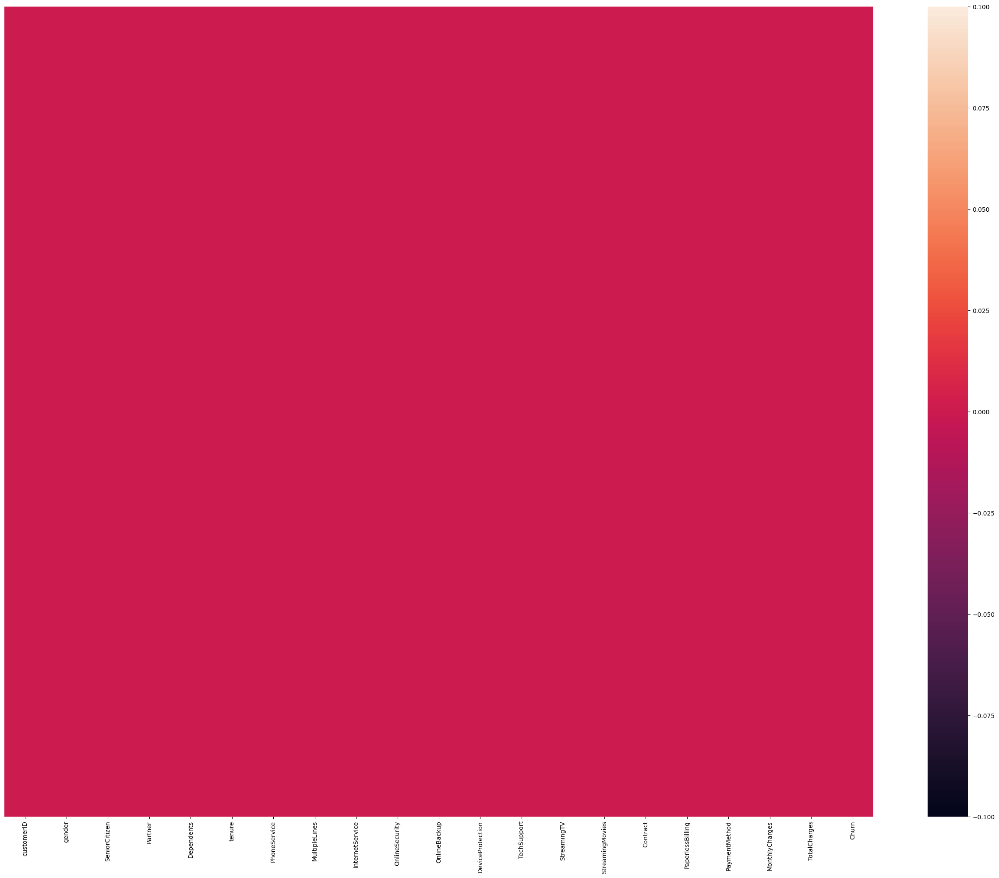

In [13]:
# Visualizing through heatmap whether any missing values available in the dataset
sns.heatmap(data_telco.isnull(),yticklabels=False)

In [14]:
#Remove customer IDs column from the data set
data_telco.drop("customerID",inplace=True,axis=1)

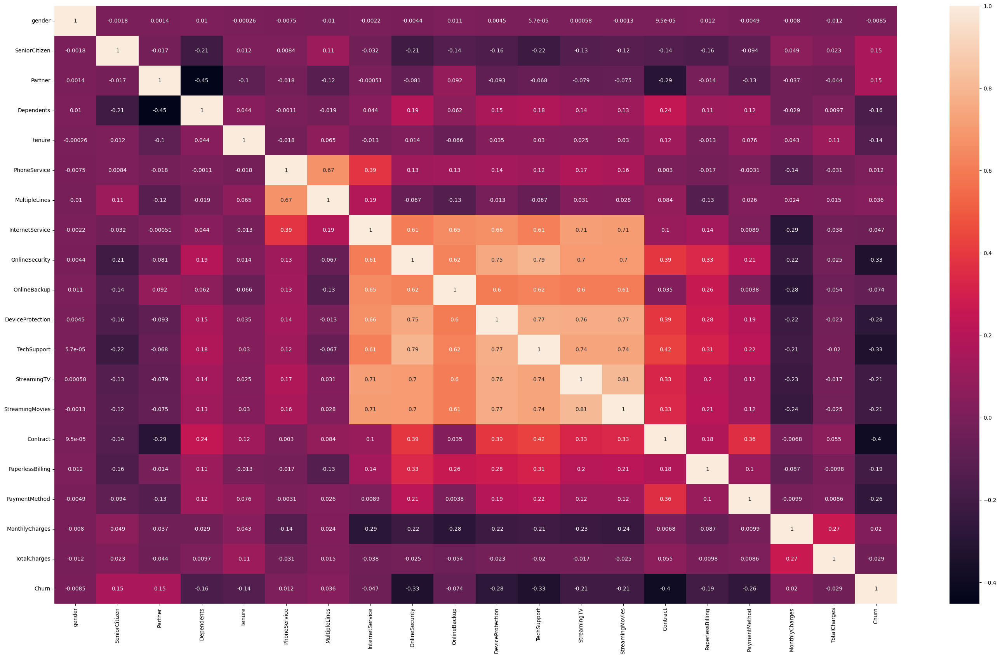

In [15]:
# plot the correlation
plt.figure(figsize=(35, 20))

corr_plot = data_telco.apply(lambda z: pd.factorize(z)[0]).corr()

p = sns.heatmap(corr_plot, xticklabels=corr_plot.columns, yticklabels=corr_plot.columns, annot=True)

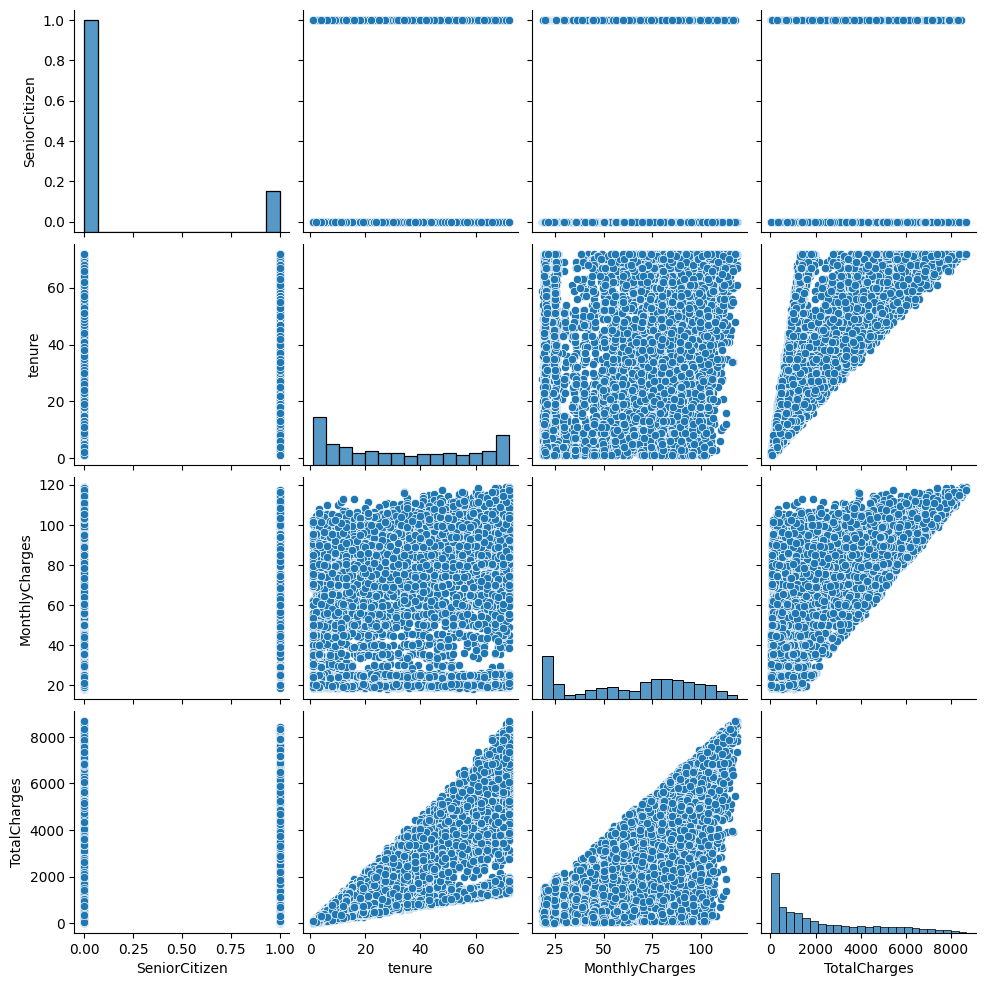

In [16]:
# All attributes are plotted against each other to see the pattern of distribution
sns.pairplot(data_telco)

No     5163
Yes    1869
Name: Churn, dtype: int64

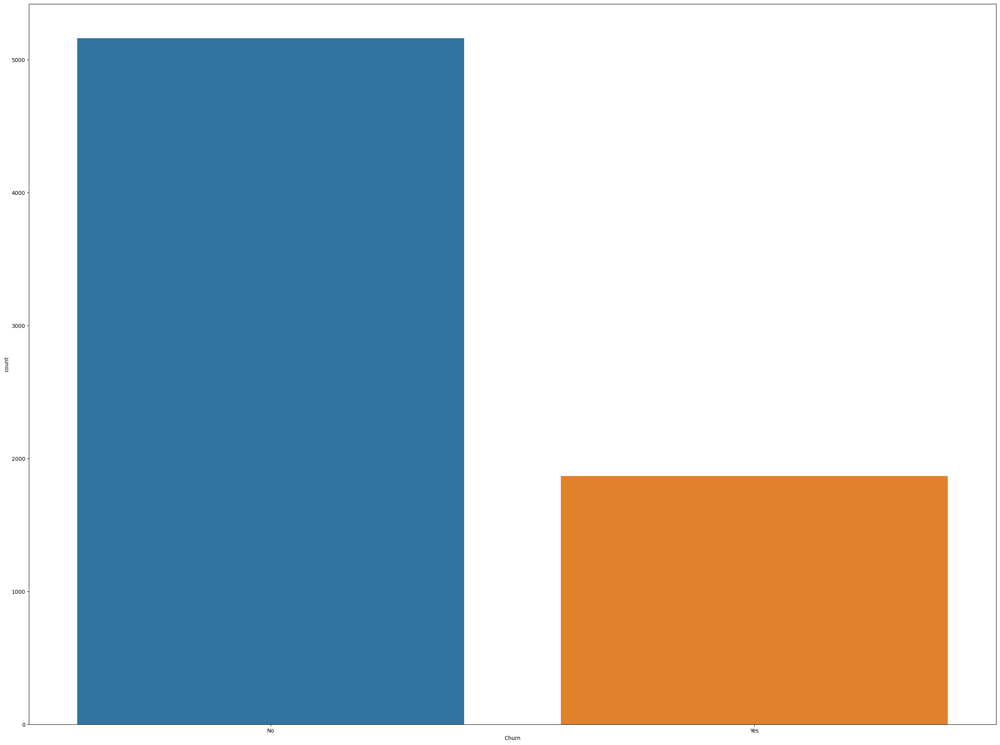

In [17]:
sns.countplot(x = "Churn", data = data_telco)
data_telco.loc[:, 'Churn'].value_counts()

This dataset is an imbalanced dataset. This point is well illustrated in the plot above.

Imbalanced classification involves developing predictive models on classification datasets that have a severe class imbalance.
The challenge of working with imbalanced datasets is that most machine learning techniques will ignore, and in turn have poor performance on, the minority class, although typically it is performance on the minority class that is most important.


ref : machinelearningmastery.com

One approach to addressing imbalanced datasets is to oversample the minority class that these techniques create new examples synthesized from the existing examples. In the following, we use five oversampling methods. :

* RandomOverSampler
* SMOTE
* BorderlineSMOTE
* SVMSMOTE
* ADASYN

# Data Exploration
Here exploring the data set, to better understand the patterns in the data and potentially form some hypothesis. First we will look at the distribution of individual variables and then slice and dice the data for any interesting trends.

In [18]:
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [19]:
g_labels = ['Male', 'Female']
c_labels = ['No', 'Yes']
# Create subplots: use 'domain' type for Pie subplot
fig = make_subplots(rows=1, cols=2, specs=[[{'type':'domain'}, {'type':'domain'}]])
fig.add_trace(go.Pie(labels=g_labels, values=data_telco['gender'].value_counts(), name="Gender"),
              1, 1)
fig.add_trace(go.Pie(labels=c_labels, values=data_telco['Churn'].value_counts(), name="Churn"),
              1, 2)

# Use `hole` to create a donut-like pie chart
fig.update_traces(hole=.4, hoverinfo="label+percent+name", textfont_size=16)

fig.update_layout(
    title_text="Gender and Churn Distributions",
    # Add annotations in the center of the donut pies.
    annotations=[dict(text='Gender', x=0.16, y=0.5, font_size=20, showarrow=False),
                 dict(text='Churn', x=0.84, y=0.5, font_size=20, showarrow=False)])
fig.show()


*   26.6 % of customers switched to another firm.
*   Customers are 49.5 % female and 50.5 % male.

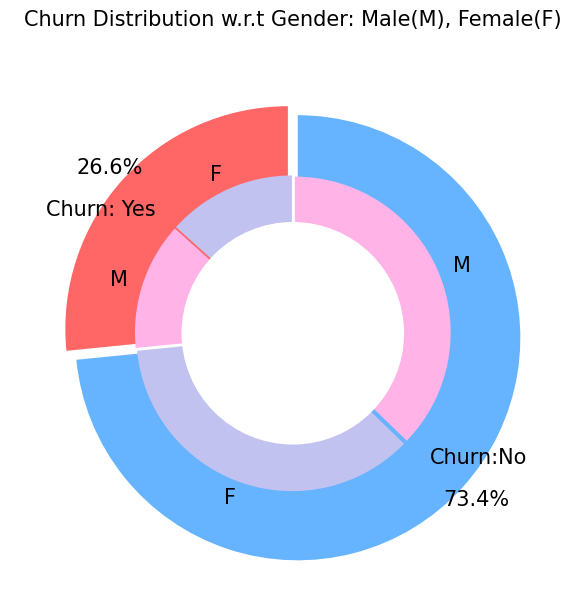

In [20]:
plt.figure(figsize=(6, 6))
labels =["Churn: Yes","Churn:No"]
values = [1869,5163]
labels_gender = ["F","M","F","M"]
sizes_gender = [939,930 , 2544,2619]
colors = ['#ff6666', '#66b3ff']
colors_gender = ['#c2c2f0','#ffb3e6', '#c2c2f0','#ffb3e6']
explode = (0.3,0.3) 
explode_gender = (0.1,0.1,0.1,0.1)
textprops = {"fontsize":15}
#Plot
plt.pie(values, labels=labels,autopct='%1.1f%%',pctdistance=1.08, labeldistance=0.8,colors=colors, startangle=90,frame=True, explode=explode,radius=10, textprops =textprops, counterclock = True, )
plt.pie(sizes_gender,labels=labels_gender,colors=colors_gender,startangle=90, explode=explode_gender,radius=7, textprops =textprops, counterclock = True, )
#Draw circle
centre_circle = plt.Circle((0,0),5,color='black', fc='white',linewidth=0)
fig = plt.gcf()
fig.gca().add_artist(centre_circle)

plt.title('Churn Distribution w.r.t Gender: Male(M), Female(F)', fontsize=15, y=1.1)

# show plot 
 
plt.axis('equal')
plt.tight_layout()
plt.show()

* There is negligible difference in customer percentage/ count who changed the service provider. Both genders behaved in similar fashion when it comes to migrating to another service provider/firm.

In [21]:
fig = px.histogram(data_telco, x="Churn", color="Contract", barmode="group", title="<b>Customer contract distribution<b>")
fig.update_layout(width=700, height=500, bargap=0.1)
fig.show()

* About 75% of customer with Month-to-Month Contract opted to move out as compared to 13% of customrs with One Year Contract and 3% with Two Year Contract

In [22]:
labels = data_telco['PaymentMethod'].unique()
values = data_telco['PaymentMethod'].value_counts()

fig = go.Figure(data=[go.Pie(labels=labels, values=values, hole=.3)])
fig.update_layout(title_text="<b>Payment Method Distribution</b>")
fig.show()

In [23]:
fig = px.histogram(data_telco, x="Churn", color="PaymentMethod", title="<b>Customer Payment Method distribution w.r.t. Churn</b>")
fig.update_layout(width=700, height=500, bargap=0.1)
fig.show()

* Major customers who moved out were having Electronic Check as Payment Method.
* Customers who opted for Credit-Card automatic transfer or Bank Automatic Transfer and Mailed Check as Payment Method were less likely to move out.

In [24]:
fig.add_trace(go.Bar(
  x = [['Churn:No', 'Churn:No', 'Churn:Yes', 'Churn:Yes'],
       ["Female", "Male", "Female", "Male"]],
  y = [965, 992, 219, 240],
  name = 'DSL',
))

fig.add_trace(go.Bar(
  x = [['Churn:No', 'Churn:No', 'Churn:Yes', 'Churn:Yes'],
       ["Female", "Male", "Female", "Male"]],
  y = [889, 910, 664, 633],
  name = 'Fiber optic',
))

fig.add_trace(go.Bar(
  x = [['Churn:No', 'Churn:No', 'Churn:Yes', 'Churn:Yes'],
       ["Female", "Male", "Female", "Male"]],
  y = [690, 717, 56, 57],
  name = 'No Internet',
))

fig.update_layout(title_text="<b>Churn Distribution w.r.t. Internet Service and Gender</b>")

fig.show()

In [25]:
color_map = {"Yes": "#FF97FF", "No": "#AB63FA"}
fig = px.histogram(data_telco, x="Churn", color="Dependents", barmode="group", title="<b>Dependents distribution</b>", color_discrete_map=color_map)
fig.update_layout(width=700, height=500, bargap=0.1)
fig.show()

* Customers without dependents are more likely to churn

In [26]:
color_map = {"Yes": '#FFA15A', "No": '#00CC96'}
fig = px.histogram(data_telco, x="Churn", color="Partner", barmode="group", title="<b>Chrun distribution w.r.t. Partners</b>", color_discrete_map=color_map)
fig.update_layout(width=700, height=500, bargap=0.1)
fig.show()

* Customers that doesn't have partners are more likely to churn

In [27]:
color_map = {"Yes": '#00CC96', "No": '#B6E880'}
fig = px.histogram(data_telco, x="Churn", color="SeniorCitizen", title="<b>Chrun distribution w.r.t. Senior Citizen</b>", color_discrete_map=color_map)
fig.update_layout(width=700, height=500, bargap=0.1)
fig.show()

* It can be observed that the fraction of senior citizen is very less.
Most of the senior citizens churn.

In [28]:
color_map = {"Yes": "#FF97FF", "No": "#AB63FA"}
fig = px.histogram(data_telco, x="Churn", color="OnlineSecurity", barmode="group", title="<b>Churn w.r.t Online Security</b>", color_discrete_map=color_map)
fig.update_layout(width=700, height=500, bargap=0.1)
fig.show()

* Most customers churn in the absence of online security,

In [29]:
color_map = {"Yes": '#FFA15A', "No": '#00CC96'}
fig = px.histogram(data_telco, x="Churn", color="PaperlessBilling",  title="<b>Chrun distribution w.r.t. Paperless Billing</b>", color_discrete_map=color_map)
fig.update_layout(width=700, height=500, bargap=0.1)
fig.show()

* Customers with Paperless Billing are most likely to churn.

In [30]:
fig = px.histogram(data_telco, x="Churn", color="TechSupport",barmode="group",  title="<b>Chrun distribution w.r.t. TechSupport</b>")
fig.update_layout(width=700, height=500, bargap=0.1)
fig.show()

* Customers with no TechSupport are most likely to migrate to another service provider.

In [31]:
color_map = {"Yes": '#00CC96', "No": '#B6E880'}
fig = px.histogram(data_telco, x="Churn", color="PhoneService", title="<b>Chrun distribution w.r.t. Phone Service</b>", color_discrete_map=color_map)
fig.update_layout(width=700, height=500, bargap=0.1)
fig.show()

* Very small fraction of customers don't have a phone service and out of that, 1/3rd Customers are more likely to churn.

<ipython-input-32-ddaa6e1271dc>:2: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


<ipython-input-32-ddaa6e1271dc>:4: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




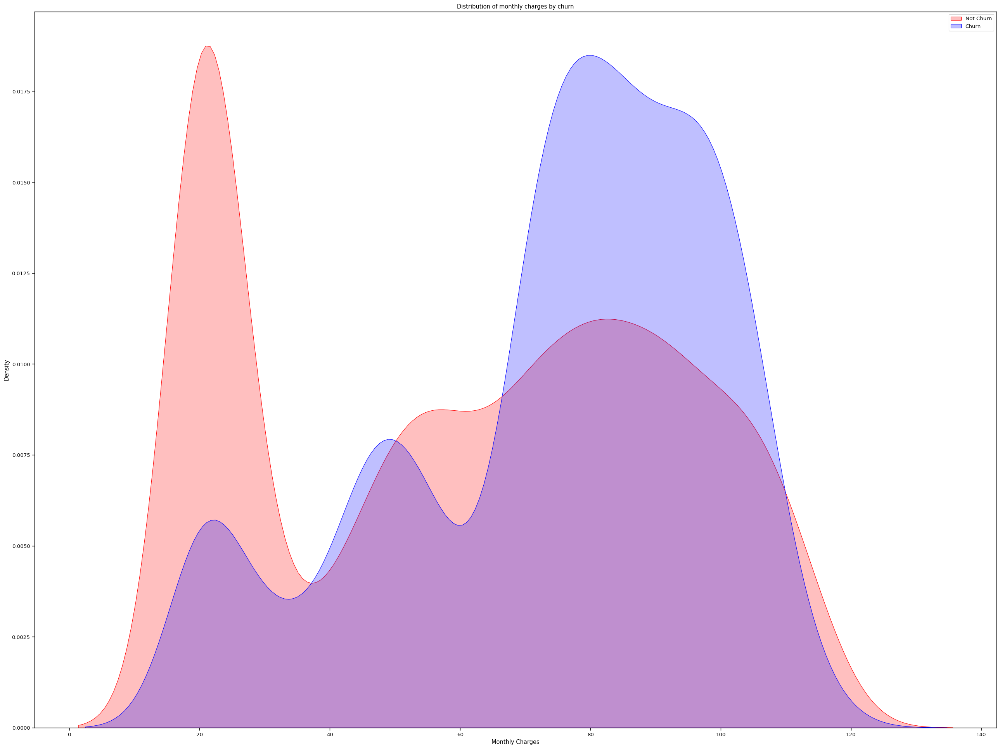

In [32]:
sns.set_context("paper",font_scale=1.1)
ax = sns.kdeplot(data_telco.MonthlyCharges[(data_telco["Churn"] == 'No') ],
                color="Red", shade = True);
ax = sns.kdeplot(data_telco.MonthlyCharges[(data_telco["Churn"] == 'Yes') ],
                ax =ax, color="Blue", shade= True);
ax.legend(["Not Churn","Churn"],loc='upper right');
ax.set_ylabel('Density');
ax.set_xlabel('Monthly Charges');
ax.set_title('Distribution of monthly charges by churn');


* Customers with higher Monthly Charges are also more likely to churn

<ipython-input-33-7c552d9febf5>:1: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.


<ipython-input-33-7c552d9febf5>:3: FutureWarning:



`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.




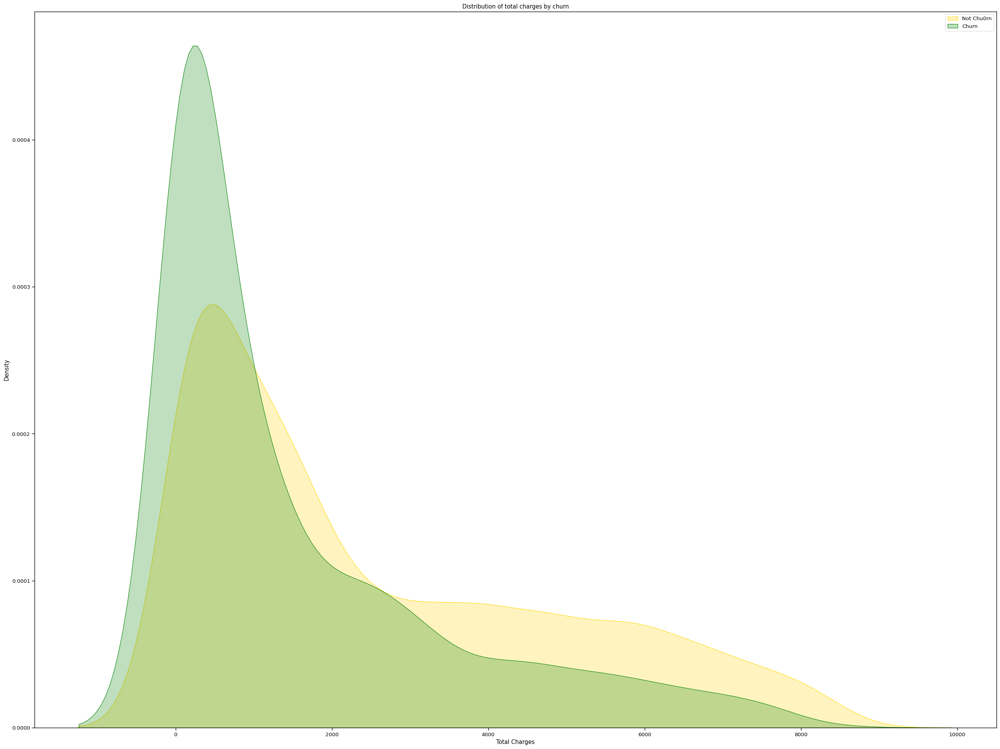

In [33]:
ax = sns.kdeplot(data_telco.TotalCharges[(data_telco["Churn"] == 'No') ],
                color="Gold", shade = True);
ax = sns.kdeplot(data_telco.TotalCharges[(data_telco["Churn"] == 'Yes') ],
                ax =ax, color="Green", shade= True);
ax.legend(["Not Chu0rn","Churn"],loc='upper right');
ax.set_ylabel('Density');
ax.set_xlabel('Total Charges');
ax.set_title('Distribution of total charges by churn');

In [34]:
fig = px.box(data_telco, x='Churn', y = 'tenure')

# Update yaxis properties
fig.update_yaxes(title_text='Tenure (Months)', row=1, col=1)
# Update xaxis properties
fig.update_xaxes(title_text='Churn', row=1, col=1)

# Update size and title
fig.update_layout(autosize=True, width=750, height=600,
    title_font=dict(size=25, family='Courier'),
    title='<b>Tenure vs Churn</b>',
)

fig.show()


* New customers are more likely to churn

# What kind of data exploration did you do?

* Preliminary findings from the EDA.

* **Datatype Check:** Features in the dataset are integers/float and objects (characters/strings).

* **Missing Data Check:** Dataset has 11 missing values (empty spaces) in TotalCharges column.

* **Duplicate records:** There are 10 duplicated records in the dataset. I have deleted the records.

* **Distribution of training data:** I checked the distribution of each feature in the dataset. Few features are normally distributed after log transformation and few features are positively skewed and could not distribute normally.

* **Correlation Check**: Performed correleation check on the dataset using heatmap the findings from it was that the didn't had any significance multi-collinearity issues.

* **Graphs:** Built barplots, distplots, histograms and more plots for better analysis and insights of the data. These insights helps us to understand how a variable impacts the churn analysis.

The above graphs are a cohensive representation of how churn is getting impacted and changing all the respective significant variables.

* A few findings which can interpret from the above graph as

  * The plot shows a class imbalance of the data between churners and non-churners. To address this, resampling would be a suitable approach. To keep this case simple, the imbalance is kept forward and specific metrics are chosen for model evaluations.

  * Churning customers have much lower tenure with a median of ca. 10 months compared to a median of non-churners of ca. 38 months.
Churning customers have higher monthly charges with a median of ca. 80 USD and much lower interquartile range compared to that of non-churners (median of ca. 65 USD).
TotalCharges are the result of tenure and MonthlyCharges, which are more insightful on an individual basis.

  * Senior citizens churn rate is much higher than non-senior churn rate.
Churn rate for month-to-month contracts much higher that for other contract durations.
Moderately higher churn rate for customers without partners.
Much higher churn rate for customers without children.
Payment method electronic check shows much higher churn rate than other payment methods.
Customers with InternetService fiber optic as part of their contract have much higher churn rate.

**Data Cleaning**

* This dataset is having missing values and duplicate values.Performed necessary operations and cleaned the data for good prediction analysis.

**Handling Missing Data**

* In any ML modeling task, one of the very important task is to check if we have any missing values in our dataset. If there are missing values in the dataset it can horribly change the results and make our model inefficient.
But there are ways to tackle this problem, we will discuss these methods in a bit detail below

**How to handle missing data** - Data Imputation techniques
* Delete rows with missing data
* Fill the missing data points by either mean/mode/median
* Model a regression with rest of the feature as input and the missing value as the target i.e. MICE Imputation

Telecom Churn dataset has few missing values and duplicate values, so for better analysis i have chosen removing the records from the dataset.

Deleting missing values can have some advantages, such as
* Reducing the size and complexity of your dataset, 
* Avoiding errors or biases that can arise from imputing or replacing missing values, and 
* Preserving the original distribution and variance of your data.

## Data Preprocessing

In [35]:
# Import label encoder
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import MinMaxScaler
  
# label_encoder object knows how to understand word labels.
label_encoder = preprocessing.LabelEncoder()
label_encoder_ols = preprocessing.LabelEncoder()

In [36]:
data_telco_transformed = data_telco

# label encoding (binary variables)
label_encoding_columns = ['gender', 'Partner', 'Dependents', 'PhoneService', 'PaperlessBilling','Churn']

# Transforming Categorical Columns
data_telco_transformed[label_encoding_columns] = data_telco_transformed[label_encoding_columns].apply(label_encoder.fit_transform)

In [37]:
one_hot_encoding_columns = ['MultipleLines', 'InternetService', 'OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 
                            'TechSupport', 'StreamingTV',  'StreamingMovies', 'Contract', 'PaymentMethod']

# encode categorical variables with more than two levels using one-hot encoding
data_telco_transformed = pd.get_dummies(data_telco_transformed, columns = one_hot_encoding_columns,drop_first=True)

In [38]:
scaler = MinMaxScaler()

min_max_columns = ['tenure', 'MonthlyCharges', 'TotalCharges']

# Encode numeric Columns
data_telco_transformed[min_max_columns] = scaler.fit_transform(data_telco_transformed[min_max_columns])

In [39]:
data_telco_transformed_ols = data_telco

# label encoding (binary variables) for ols model
label_encoding_columns_ols = ['gender', 'Partner', 'Dependents', 'PhoneService', 'PaperlessBilling','Churn']

# Transforming Categorical Columns for ols model
data_telco_transformed_ols[label_encoding_columns_ols] = data_telco_transformed_ols[label_encoding_columns_ols].apply(label_encoder_ols.fit_transform)

In [40]:
one_hot_encoding_columns = ['MultipleLines', 'InternetService', 'OnlineSecurity', 'OnlineBackup', 'DeviceProtection', 
                            'TechSupport', 'StreamingTV',  'StreamingMovies', 'Contract', 'PaymentMethod']

# encode categorical variables with more than two levels using one-hot encoding
data_telco_transformed_ols = pd.get_dummies(data_telco_transformed_ols, columns = one_hot_encoding_columns,drop_first=True)

In [41]:
scaler_ols = MinMaxScaler()

# min-max normalization (numeric variables)
min_max_columns_ols = ['tenure', 'MonthlyCharges', 'TotalCharges']

# Encode numeric Columns
data_telco_transformed_ols[min_max_columns] = scaler_ols.fit_transform(data_telco_transformed_ols[min_max_columns_ols])

In [42]:
import statsmodels.api as sm

#define response variable
y_ols = data_telco_transformed_ols['Churn']

#define predictor variables
x_ols = data_telco_transformed_ols[['tenure','MonthlyCharges', 'TotalCharges']]

#add constant to predictor variables
x_ols = sm.add_constant(x_ols)

#fit regression model
model = sm.OLS(y_ols, x_ols).fit()

#view summary of model fit
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                  Churn   R-squared:                       0.225
Model:                            OLS   Adj. R-squared:                  0.224
Method:                 Least Squares   F-statistic:                     678.8
Date:                Mon, 10 Apr 2023   Prob (F-statistic):               0.00
Time:                        02:00:20   Log-Likelihood:                -3338.1
No. Observations:                7032   AIC:                             6684.
Df Residuals:                    7028   BIC:                             6712.
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
const              0.1937      0.013     14.

# Feature Selection
Feature Selection is the process of selecting the features which are relevant to a machine learning model. It means that you select only those attributes that have a significant effect on the model's output.

It is desirable to reduce the number of input variables to both reduce the computational cost of modeling and, in some cases, to improve the performance of the model.

All machine learning workflows depend on feature engineering, which comprises feature extraction and feature selection that are fundamental building blocks of modern machine learning pipelines. Despite the fact that feature extraction and feature selection processes share some overlap, often, these terms are erroneously equated. Feature extraction is the process of using domain knowledge to extract new variables from raw data that make machine learning algorithms work. The feature selection process is based on selecting the most consistent, relevant, and non-redundant features.

The objectives of feature selection techniques include:

* Simplification of models to make them easier to interpret by researchers/users
* Shorter training times
* Avoiding the curse of dimensionality
* Enhanced generalization by reducing overfitting (formally, reduction of variance)

Consider the case when you go to the departmental store to buy grocery items. A product has a lot of information on it, i.e., product, category, expiry date, retail cost, ingredients, and manufacturing details. All this information is the features of the product. Normally, you check the brand, retail cost, expiry date, weather the item is vegetarian or not before buying a product. However, manufacturing section is not your concern. Therefore, brand, retail cost, expiry date, vegetraian/non-vegetarian are relevant features, and the manufacturing details are irrelevant. This is how feature selection is done.

# Null-Hypothesis
For Example:- Testing the efficacy of a new Vaccine
Any new vaccine manufacturer has to conduct a double blind clinical controlled trials to check the efficacy of any vaccine in the general population. Now to test the vaccine, manufacturer will likely recruite around 60k people from all over the population where 30k would be vaccinated by a vaccine and rest 30k would be given a placebo. After few months the it was found that 500 people from vaccinated group got the diesease whereas 10000 people from placebo group got the dieases. This translate to a vaccine efficacy of 95%. i.e. those who received the vaccine were at a 95% lower risk of developing disease than the group who received the placebo. Now, this finding on a subset of 60k individuals is generalized over the whole population of man kind. These assumption is known as Null-Hypothesis.

Statistically, this can be achieved by P-Value.

**P-Value:** It stands for a probability value; it tells how likely it is that a result occurred by chance alone. Basically, the p-value is used in hypothesis testing to help you support or reject the null hypothesis. The smaller the p-value, the stronger the evidence to reject the null hypothesis.

Features in our dataset with P value < 0.05

* Tenure
* Total Charges
* Monthly Charges

Lets consider only these features and calculate the model fit again, and then lets have a comparative analysis of both models.

In [43]:
import statsmodels.api as sm
model_ols = sm.OLS(data_telco_transformed_ols['Churn'], data_telco_transformed_ols[['tenure','MonthlyCharges', 'TotalCharges']
]).fit()
# Print out the statistics
model_ols.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:                  Churn   R-squared (uncentered):                   0.414
Model:                            OLS   Adj. R-squared (uncentered):              0.413
Method:                 Least Squares   F-statistic:                              1652.
Date:                Mon, 10 Apr 2023   Prob (F-statistic):                        0.00
Time:                        02:00:20   Log-Likelihood:                         -3442.7
No. Observations:                7032   AIC:                                      6891.
Df Residuals:                    7029   BIC:                                      6912.
Df Model:                           3                                                  
Covariance Type:            nonrobust                                                  
==================================================================================
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
tenure             0.1651      0.021      7.799      0.000       0.124       0.207
MonthlyCharges     1.0456      0.016     65.154      0.000       1.014       1.077
TotalCharges      -1.2062      0.040    -30.159      0.000      -1.285      -1.128
==============================================================================
Omnibus:                      471.125   Durbin-Watson:                   1.991
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              570.477
Skew:                           0.696   Prob(JB):                    1.33e-124
Kurtosis:                       2.902   Cond. No.                         7.74
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

* As the dataset is classification and continuous variables are very few so r2 values was very less in without constant model

* In model constant model the r2 sqaure value is very less compared to no-constant model.

* Applying r2 on few varibles leads to less r2 and can't depend on this feature also not very relevant for classification model.

* Generally R2 need to be above 70 for best fit model if it is less it leads to noisy, high-variability data and can have a significant trend. 

**Interpreting Regression Co-efficients**

**R-squared** measures the percentage of how much of the variance is described by the model.

Value for the R-squared for this model is 41.4 which is low and variance was high for the regression line.

**Adj. R-squared** measures the percentage of how much of the variance is described by the model with a penalization for more variables.

Value for Adj R-Squared is also 41.4 which means it does not add any weightage to the features if added into the dataset.

**F-statistic** measures how significant the fit is for the model
Prob(F-statistic) or P-value is the probability that a sample of the population would produce the above statistic.


**Model Co-efficients**

The positive or negative value of a co-eficient tells us if there is a positve or a negative correlationship between the target and predictors. A positive value indicates that the value of target increases if the value of co-efficient increases and vice-versa. Whereas the negative values indicates that the value of target increases if the value of co-efficient decreases and vice versa.

Value for the variable Monthly Charges is highest = 1.0456 and tenure with 0.1651

Here, MonthlyCharges and Tenure are the most important variables to predict target Churn


**P-Values**

If the p-value is 0.05 or lower, the result is significant, but if it is higher than 0.05, the result is non-significant

Here all the 3 variables are less than 0.05, hence these variables are significant variables and any change to this variables have significant impact on the target.

**Skew and Kurtosis**

Skewness tells us the amount and direction of skew and Kurtosis tells us how tall and sharp the peak is. The optimum value for these two measures is 0, Here we have a value for Skew and Kurtosis as 0.696, 2.902 respectively.

**Durbin-Watson**

The Durbin-Watson test is a statistical test to detect auto-correlation in the residuals of a regression analysis. Its range is 0 to 4.

Value of 2 indicates that no auto correlation is detected
Value between 0 to 2 indicates that there is positive auto correlation detected
Value between 2 to 4 indicates that there is negatibe auto correlation detected
Our model has a DW score of 1.991 which is a positive auto-correlation in the residuals of regression.

**Jarque-Bera Test**

The JB test is known as the test of Normality, irrespective if the data has skew or kurtosis. If it is far from zero, it signals the data do not have a normal distribution. Our JB value is 570.477 which again re-inforces the interpretation we got from Skew and Kurtosis.

Here we have only 3 varibles for OLS model as dataset is a classification data and all the varible values having binary values so we can't able to fit more features in the model.

In [44]:
# Check for duplicates
print(data_telco_transformed.duplicated().sum())

22


In [45]:
# Drop the duplicate data from the dataset
data_telco_transformed.drop_duplicates(inplace=True)

In [46]:
# Check for duplicates
print(data_telco_transformed.duplicated().sum())

0


<Axes: xlabel='TotalCharges'>

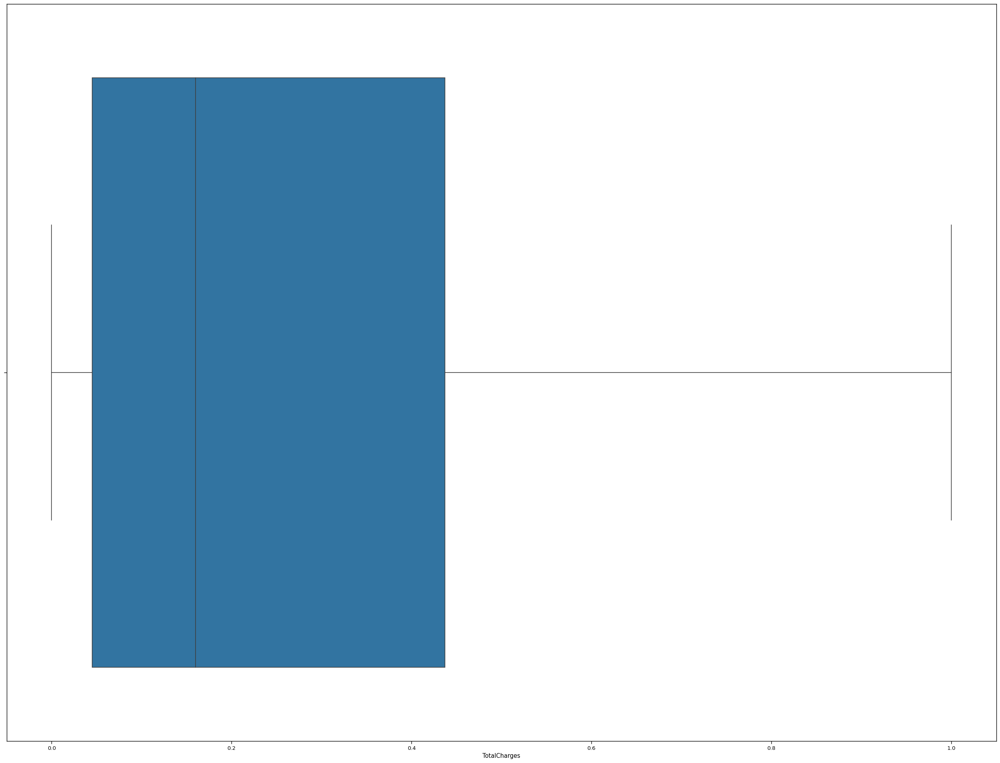

In [47]:
# Removing the extreme outliers for the column TotalCharges

Q1 = data_telco_transformed['TotalCharges'].quantile(0.25)
Q3 = data_telco_transformed['TotalCharges'].quantile(0.75)
IQR = Q3 - Q1

# Remove any observations that are more than 1.5 IQRs away from the median
df = data_telco_transformed[(data_telco_transformed['TotalCharges'] > Q1 - 1.5*IQR) & (data_telco_transformed['TotalCharges'] < Q3 + 1.5*IQR)]

sns.boxplot(x='TotalCharges', data=data_telco_transformed) 

<Axes: xlabel='MonthlyCharges'>

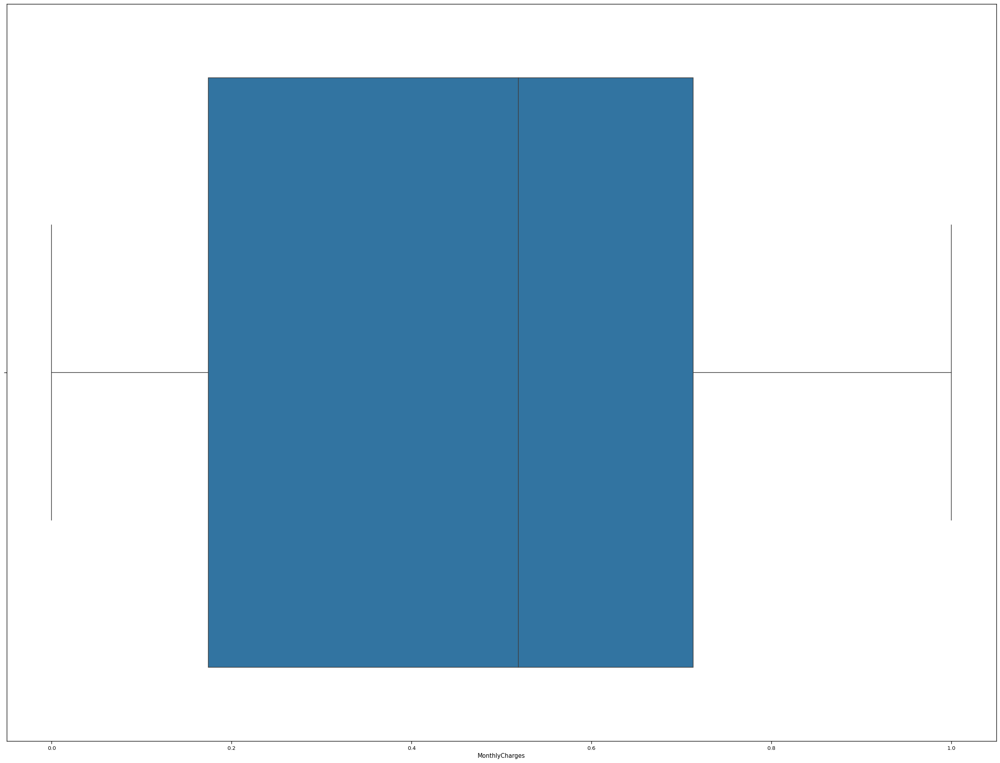

In [48]:
#removing the extreme outliers for the column MonthlyCharges

Q1 = data_telco_transformed['MonthlyCharges'].quantile(0.25)
Q3 = data_telco_transformed['MonthlyCharges'].quantile(0.75)
IQR = Q3 - Q1

# Remove any observations that are more than 1.5 IQRs away from the median
df = data_telco_transformed[(data_telco_transformed['MonthlyCharges'] > Q1 - 1.5*IQR) & (data_telco_transformed['MonthlyCharges'] < Q3 + 1.5*IQR)]

sns.boxplot(x='MonthlyCharges', data=data_telco_transformed) 

<Axes: xlabel='tenure'>

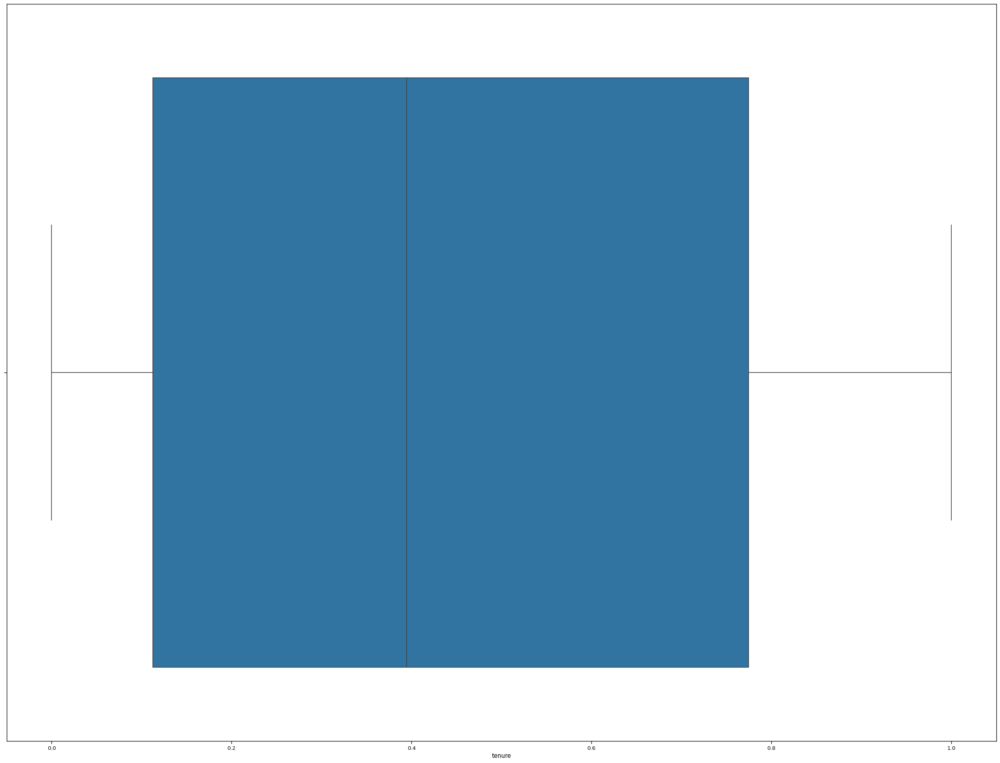

In [49]:
#removing the extreme outliers for the column Tenure

Q1 = data_telco_transformed['tenure'].quantile(0.25)
Q3 = data_telco_transformed['tenure'].quantile(0.75)
IQR = Q3 - Q1

# Remove any observations that are more than 1.5 IQRs away from the median
df = data_telco_transformed[(data_telco_transformed['tenure'] > Q1 - 1.5*IQR) & (data_telco_transformed['tenure'] < Q3 + 1.5*IQR)]

sns.boxplot(x='tenure', data=data_telco_transformed) 

In [50]:
def distplot(feature, frame, color='r'):
    plt.figure(figsize=(8,3))
    plt.title("Distribution for {}".format(feature))
    ax = sns.distplot(frame[feature], color= color)

<ipython-input-50-8c8257b32bab>:4: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751


<ipython-input-50-8c8257b32bab>:4: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751


<ipython-input-50-8c8257b32bab>:4: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use ei

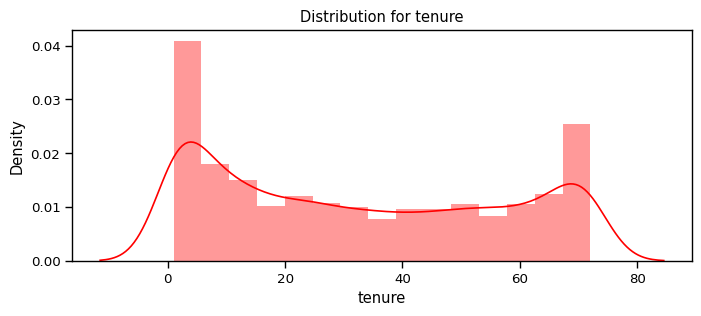

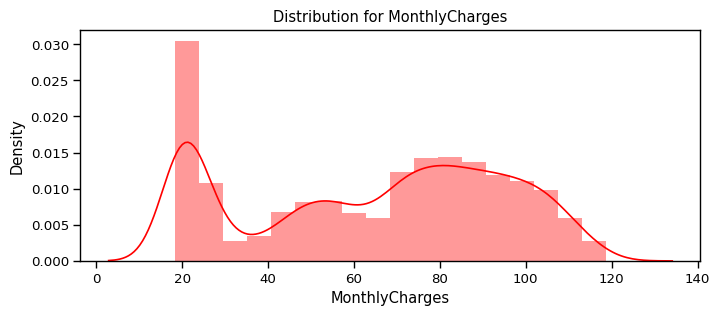

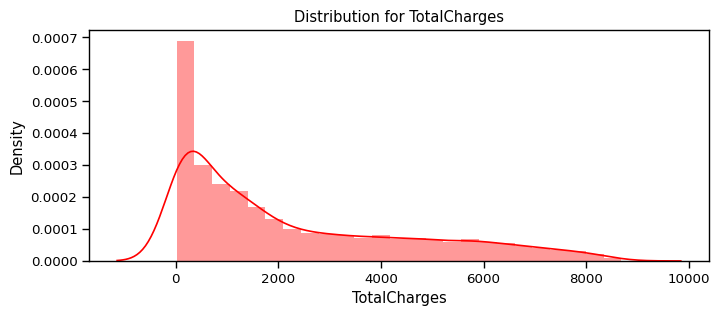

In [51]:
num_cols = ["tenure", 'MonthlyCharges', 'TotalCharges']
for feat in num_cols: distplot(feat, data_telco)


* Since the numerical features are distributed over different value ranges, I will use standard scalar to scale them down to the same range.

<ipython-input-50-8c8257b32bab>:4: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751


<ipython-input-50-8c8257b32bab>:4: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751


<ipython-input-50-8c8257b32bab>:4: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use ei

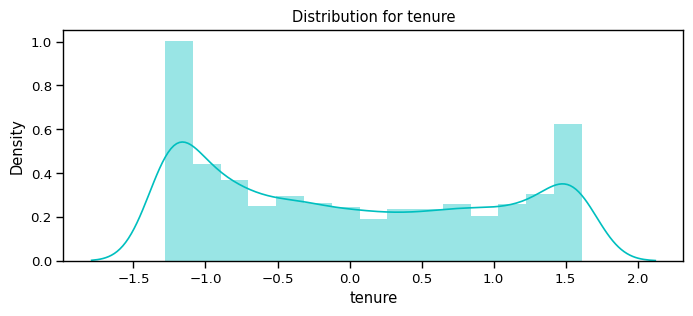

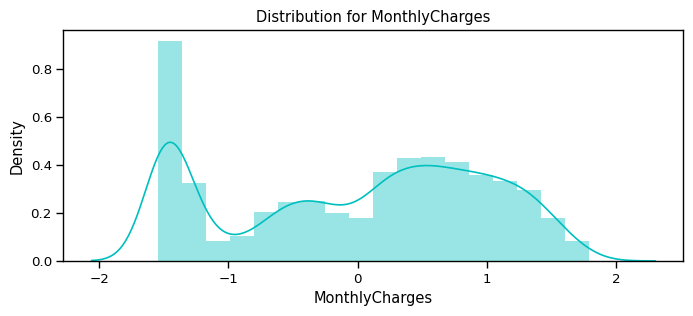

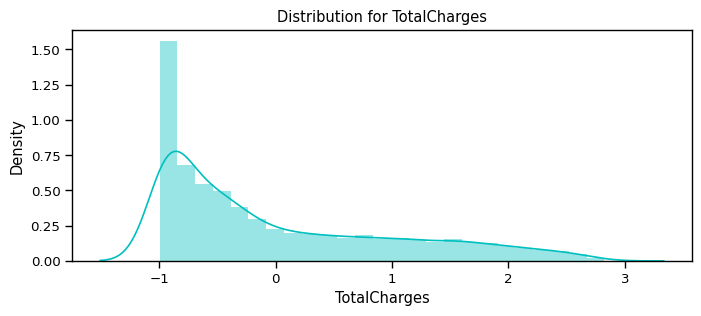

In [52]:
numerical_cols = ['tenure', 'MonthlyCharges', 'TotalCharges']
df_std = pd.DataFrame(StandardScaler().fit_transform(data_telco[num_cols].astype('float64')),
                       columns=num_cols)
for feat in numerical_cols: distplot(feat, df_std, color='c')

# Multicollinearity

In [53]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [54]:
X_mc = data_telco_transformed[['gender', 'SeniorCitizen', 'Partner', 'Dependents', 'tenure',
       'PhoneService', 'PaperlessBilling',
       'MonthlyCharges', 'TotalCharges']]

# VIF dataframe
vif_data = pd.DataFrame()
vif_data["feature"] = X_mc.columns
  
# calculating VIF for each feature
vif_data["VIF"] = [variance_inflation_factor(X_mc.values, i)
                          for i in range(len(X_mc.columns))]
  
print(vif_data)

            feature        VIF
0            gender   1.897417
1     SeniorCitizen   1.325030
2           Partner   2.810019
3        Dependents   1.920936
4            tenure  12.223536
5      PhoneService   6.404217
6  PaperlessBilling   2.726838
7    MonthlyCharges  10.911303
8      TotalCharges  15.611738


Here we can see multicollinearity of data for specific continuous float datatype has less collinear relationship to the other variables that should be considered or adjusted for the structure of the model and selection of independent variables.

In [55]:

from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from xgboost import XGBClassifier
from sklearn import metrics
from sklearn.metrics import roc_curve
from sklearn.metrics import recall_score, confusion_matrix, precision_score, f1_score, accuracy_score, classification_report
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LassoCV
from sklearn.linear_model import RidgeCV
from sklearn.metrics import r2_score,mean_squared_error,mean_absolute_error
from sklearn.linear_model import LinearRegression, Lasso, Ridge, ElasticNet, SGDRegressor
from sklearn import metrics

In [56]:
# Define the feature variable 'X' and the label/target variable 'y'
X = data_telco_transformed.drop('Churn', axis=1)  # Drop the target variable
y = data_telco_transformed['Churn']

In [57]:
# Split the data into training and test datasets
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=33)

## Fitting a Ridge Regression

In [58]:
# Ridge regression with an alpha of 0.5
model_ridge = Ridge(fit_intercept=True, alpha=0.5)
model_ridge.fit(X_train, y_train)

Ridge(alpha=0.5)

In [59]:
# rmse regularization
y_pred = model_ridge.predict(X_test)

rmse = np.sqrt(metrics.mean_squared_error(y_test, y_pred))
rmse

0.371094550806307

# Fitting a Random Forest Classifier

In [60]:
from sklearn.ensemble import RandomForestClassifier
model_rf = RandomForestClassifier(n_estimators=1000 , oob_score = True, n_jobs = -1,
                                  random_state =50, max_features = "auto",
                                  max_leaf_nodes = 30)
model_rf.fit(X_train, y_train)

/usr/local/lib/python3.9/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning:

`max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.



RandomForestClassifier(max_features='auto', max_leaf_nodes=30,
                       n_estimators=1000, n_jobs=-1, oob_score=True,
                       random_state=50)

In [61]:
# Make predictions
prediction_test_rf = model_rf.predict(X_test)
accuracy_rf = metrics.accuracy_score(y_test, prediction_test_rf)
print (accuracy_rf)

0.7941036614360437


In [62]:
# evaluation
from sklearn.metrics import classification_report 
print(classification_report(y_test, prediction_test_rf))

              precision    recall  f1-score   support

           0       0.83      0.91      0.87      1554
           1       0.64      0.48      0.55       549

    accuracy                           0.79      2103
   macro avg       0.74      0.69      0.71      2103
weighted avg       0.78      0.79      0.78      2103



In [63]:
f1_score_rf = f1_score(y_test, prediction_test_rf, average='weighted')
print(f1_score_rf)

0.7834034907659926


In [64]:
recall_rf = recall_score(y_test, prediction_test_rf, average='weighted')
print(recall_rf)

0.7941036614360437


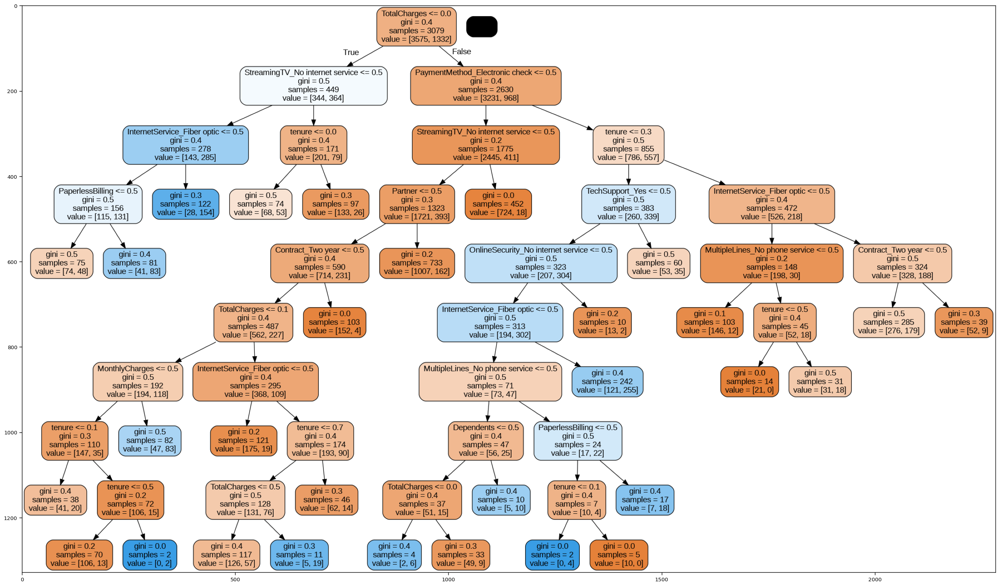

In [65]:
# Visualization of Nodes for the purpose of explainability
#figure(figsize=(32, 24), dpi=80)
tree_model = model_rf.estimators_[0]
export_graphviz(
    tree_model,
    out_file="tree.dot",
    feature_names=list(X_train.columns),
    rounded=True,
    precision=1,filled=True
)
(graph,) = pydot.graph_from_dot_file("tree.dot")
graph.write_png("tree.png")
img = mpimg.imread("tree.png")
imgplot = plt.imshow(img)
plt.show()

As we can see that, this tree is traversing each class in each node and helps to get insight and predicts a value.

Each square represents a node in the tree, with multiple leaf nodes in the graph. The root and interior nodes show the decision rule, used to split incoming data, at the top of the square. Each square also includes the: 

* Gini Impurity
* Total number of samples
* Number of samples per class
* Dominant class for the subset of training data at the node

## Fitting a KNeighborsClassifier

In [66]:
knn_model = KNeighborsClassifier(n_neighbors = 10) 
knn_model.fit(X_train,y_train)
predicted_knn = knn_model.predict(X_test)
accuracy_knn = knn_model.score(X_test,y_test)
print("KNN accuracy:",accuracy_knn)

KNN accuracy: 0.7189728958630528


In [67]:
print(classification_report(y_test, predicted_knn))

              precision    recall  f1-score   support

           0       0.76      0.77      0.77      1554
           1       0.32      0.30      0.31       549

    accuracy                           0.65      2103
   macro avg       0.54      0.54      0.54      2103
weighted avg       0.64      0.65      0.65      2103



In [68]:
f1_score_knn = f1_score(y_test, predicted_knn, average='weighted')
print(f1_score_knn)

0.6471479830756598


In [69]:
recall_knn = recall_score(y_test, predicted_knn, average='weighted')
print(recall_knn)

0.6504992867332382


## Fitting a Support Vector Machine Classifier (SVC)

In [70]:
svc_model = SVC(random_state = 5)
svc_model.fit(X_train,y_train)
predict_svc = svc_model.predict(X_test)
accuracy_svc = svc_model.score(X_test,y_test)
print("SVM accuracy is :",accuracy_svc)

SVM accuracy is : 0.8017118402282454


In [71]:
print(classification_report(y_test, predict_svc))

              precision    recall  f1-score   support

           0       0.84      0.90      0.87      1554
           1       0.65      0.53      0.58       549

    accuracy                           0.80      2103
   macro avg       0.75      0.71      0.73      2103
weighted avg       0.79      0.80      0.79      2103



In [72]:
f1_score_svc = f1_score(y_test, predict_svc, average='weighted')
print(f1_score_svc)

0.7949473261942819


In [73]:
recall_svc = recall_score(y_test, predict_svc, average='weighted')
print(recall_svc)

0.8017118402282454


In [74]:
lr_model = LogisticRegression()
lr_model.fit(X_train,y_train)
accuracy_lr = lr_model.score(X_test,y_test)
print("Logistic Regression accuracy is :",accuracy_lr)

Logistic Regression accuracy is : 0.802187351402758


In [75]:
lr_pred= lr_model.predict(X_test)
report = classification_report(y_test,lr_pred)
print(report)

              precision    recall  f1-score   support

           0       0.85      0.89      0.87      1554
           1       0.64      0.56      0.60       549

    accuracy                           0.80      2103
   macro avg       0.74      0.72      0.73      2103
weighted avg       0.80      0.80      0.80      2103



In [76]:
f1_score_lr = f1_score(y_test, lr_pred, average='weighted')
print(f1_score_lr)

0.7980610778173878


In [77]:
recall_lr = recall_score(y_test, lr_pred, average='weighted')
print(recall_lr)

0.802187351402758


## Fitting a Ada Boost Classifier (ABC)

In [78]:
a_model = AdaBoostClassifier()
a_model.fit(X_train,y_train)
a_preds = a_model.predict(X_test)
print("AdaBoost Classifier accuracy")
accuracy_ada = metrics.accuracy_score(y_test, a_preds)
print(accuracy_ada)

AdaBoost Classifier accuracy
0.7941036614360437


In [79]:
print(classification_report(y_test, a_preds))

              precision    recall  f1-score   support

           0       0.85      0.88      0.86      1554
           1       0.62      0.54      0.58       549

    accuracy                           0.79      2103
   macro avg       0.73      0.71      0.72      2103
weighted avg       0.79      0.79      0.79      2103



In [80]:
f1_score_ada = f1_score(y_test, a_preds, average='weighted')
print(f1_score_ada)

0.7895859777802344


In [81]:
recall_ada = recall_score(y_test, a_preds, average='weighted')
print(recall_ada)

0.7941036614360437


## Fitting a Gradient Boost Classifier (GBC)

In [82]:
gb = GradientBoostingClassifier()
gb.fit(X_train, y_train)
gb_pred = gb.predict(X_test)
accuracy_gb = accuracy_score(y_test, gb_pred)
print("Gradient Boosting Classifier", accuracy_gb)

Gradient Boosting Classifier 0.7993342843556823


In [83]:
print(classification_report(y_test, gb_pred))

              precision    recall  f1-score   support

           0       0.85      0.89      0.87      1554
           1       0.64      0.54      0.59       549

    accuracy                           0.80      2103
   macro avg       0.74      0.72      0.73      2103
weighted avg       0.79      0.80      0.79      2103



In [84]:
f1_score_gb = f1_score(y_test, gb_pred, average='weighted')
print(f1_score_rf)

0.7834034907659926


In [85]:
recall_gb = recall_score(y_test, gb_pred, average='weighted')
print(recall_gb)

0.7993342843556823


## Fitting a Decision Tree Classifier (DTC)

In [86]:
dtc=DecisionTreeClassifier()
dtc.fit(X_train,y_train)
dtc_pred = dtc.predict(X_test)
dtc_accuracy = accuracy_score(y_test, dtc_pred)

In [87]:
#We are also gonna print the classification report 
print(classification_report(y_test, dtc_pred))

              precision    recall  f1-score   support

           0       0.82      0.80      0.81      1554
           1       0.47      0.51      0.49       549

    accuracy                           0.72      2103
   macro avg       0.64      0.65      0.65      2103
weighted avg       0.73      0.72      0.72      2103



In [88]:
f1_score_dtc = f1_score(y_test, dtc_pred, average='weighted')
print(f1_score_dtc)

0.7240619930669387


In [89]:
recall_dtc = recall_score(y_test, dtc_pred, average='weighted')
print(recall_dtc)

0.7203994293865906


## Fitting a Stack Ensemble Voting Classifier

In [90]:
from sklearn.ensemble import VotingClassifier
clf1 = GradientBoostingClassifier()
clf2 = LogisticRegression()
clf3 = AdaBoostClassifier()
eclf1 = VotingClassifier(estimators=[('gbc', clf1), ('lr', clf2), ('abc', clf3)], voting='soft')
eclf1.fit(X_train, y_train)
predictions = eclf1.predict(X_test)
print("Final Accuracy Score ")
print(accuracy_score(y_test, predictions))

Final Accuracy Score 
0.806942463147884


In [91]:
print(classification_report(y_test, predictions))

              precision    recall  f1-score   support

           0       0.85      0.89      0.87      1554
           1       0.65      0.56      0.60       549

    accuracy                           0.81      2103
   macro avg       0.75      0.73      0.74      2103
weighted avg       0.80      0.81      0.80      2103



From the confusion matrix we can see that: There are total 1400+149=1549 actual non-churn values and the algorithm predicts 1400 of them as non churn and 149 of them as churn. While there are 237+324=561 actual churn values and the algorithm predicts 237 of them as non churn values and 324 of them as churn values.

Customer churn is definitely bad to a firm ’s profitability. Various strategies can be implemented to eliminate customer churn. The best way to avoid customer churn is for a company to truly know its customers. This includes identifying customers who are at risk of churning and working to improve their satisfaction. Improving customer service is, of course, at the top of the priority for tackling this issue. Building customer loyalty through relevant experiences and specialized service is another strategy to reduce customer churn. Some firms survey customers who have already churned to understand their reasons for leaving in order to adopt a proactive approach to avoiding future customer churn.

In [92]:
compare_models = [('Random Forest', accuracy_rf,f1_score_rf,recall_rf, ''),
                  ('Ada Boost', accuracy_ada,f1_score_ada,recall_ada,''),
                  ('SVC', accuracy_svc,f1_score_svc,recall_svc, ''),
                  ('GradientBoosting', accuracy_gb,f1_score_gb,recall_gb,''),
                  ('Logistic Regression', accuracy_lr,f1_score_lr,recall_lr,'Best Model in Accuracy'),
                  ('KNN', accuracy_knn,f1_score_knn,recall_knn,''),
                  ('Decision Tree Classifier', dtc_accuracy,f1_score_dtc,recall_dtc,'')]

In [93]:
predict = pd.DataFrame(data = compare_models, columns=['Model','Accuracy','F1_Score','Recall','Description'])
predict.style.background_gradient(cmap='YlGn')

,Model,Accuracy,F1_Score,Recall,Description
0,Random Forest,0.794104,0.783403,0.794104,
1,Ada Boost,0.794104,0.789586,0.794104,
2,SVC,0.801712,0.794947,0.801712,
3,GradientBoosting,0.799334,0.793967,0.799334,
4,Logistic Regression,0.802187,0.798061,0.802187,Best Model in Accuracy
5,KNN,0.718973,0.647148,0.650499,
6,Decision Tree Classifier,0.720399,0.724062,0.720399,


What evaluation metric are you using?
The evaluation metrics which I am using are

* Accuracy
* F1 Score
* Recall
* Precision
* ROC Curve
* Confusion Matrix


**1. Precision:** Precision explains how many of the correctly predicted cases actually turned out to be positive. Precision is useful in the cases where False Positive is a higher concern than False Negatives. The importance of Precision is in music or video recommendation systems, e-commerce websites, etc. where wrong results could lead to customer churn and this could be harmful to the business

**2. Recall (Sensitivity):** Recall explains how many of the actual positive cases we were able to predict correctly with our model. It is a useful metric in cases where False Negative is of higher concern than False Positive. It is important in medical cases where it doesn’t matter whether we raise a false alarm but the actual positive cases should not go undetected!

**3. F1 Score:** It gives a combined idea about Precision and Recall metrics. It is maximum when Precision is equal to Recall.

The F1 score punishes extreme values more. F1 Score could be an effective evaluation metric in the following cases:

When FP and FN are equally costly.
Adding more data doesn’t effectively change the outcome
True Negative is high

**4. AUC-ROC:** The Receiver Operator Characteristic (ROC) is a probability curve that plots the TPR(True Positive Rate) against the FPR(False Positive Rate) at various threshold values and separates the ‘signal’ from the ‘noise’.

Understanding how well a machine learning model will perform on unseen data is the main purpose behind working with these evaluation metrics. Metrics like accuracy, precision, recall are good ways to evaluate classification models for balanced datasets, but if the data is imbalanced then other methods like ROC/AUC perform better in evaluating the model performance.

ROC curve isn’t just a single number but it’s a whole curve that provides nuanced details about the behavior of the classifier. It is also hard to quickly compare many ROC curves to each other.

These evaluation metrics are used to evaluate the best model, as it is a classification problem. Here, F1 Score, Recall and Accuracy are the most important metrics used to evaluate the mode.

The residual deviance tells us how well the response variable can be predicted by a model with p predictor variables. The lower the value, the better the model is able to predict the value of the response variable.

Accuracy tells us how correct and precise our model is.

In [94]:
# Remove 1% of the data randomly
data_1 = data_random.sample(frac=0.01)
data_1 = data_random.drop(data_1.index)

In [95]:
# Remove 5% of the data randomly
data_5 = data_random.sample(frac=0.05)
data_5 = data_random.drop(data_5.index)

In [96]:
# Remove 10% of the data randomly
data_10 = data_random.sample(frac=0.1)
data_10 = data_random.drop(data_10.index)

In [97]:
# Checking dimensions of the data
print(data_1.shape)
print(data_5.shape)
print(data_10.shape)

(6973, 21)
(6691, 21)
(6339, 21)


In [98]:
# Droped the respective column 
data_1.drop("customerID",inplace=True,axis=1)
data_5.drop("customerID",inplace=True,axis=1)
data_10.drop("customerID",inplace=True,axis=1)

In [99]:
# Converting Total Charges to a numerical data type.
data_1['TotalCharges'] = pd.to_numeric(data_1['TotalCharges'], errors='coerce')
data_5['TotalCharges'] = pd.to_numeric(data_5['TotalCharges'], errors='coerce')
data_10['TotalCharges'] = pd.to_numeric(data_10['TotalCharges'], errors='coerce')

In [100]:
data_1_mean = data_1.copy()
data_5_mean = data_5.copy()
data_10_mean = data_10.copy()

In [101]:
data_1_median = data_1.copy()
data_5_median = data_5.copy()
data_10_median = data_10.copy()

In [102]:
# Impute missing values using mean imputation
data_1_mean = data_1['TotalCharges'].fillna(data_1['TotalCharges'].mean())
data_5_mean = data_5['TotalCharges'].fillna(data_5['TotalCharges'].mean())
data_10_mean = data_10['TotalCharges'].fillna(data_10['TotalCharges'].mean())

In [103]:
# Impute missing values using median imputation
data_1_median = data_1['TotalCharges'].fillna(data_1['TotalCharges'].median())
data_5_median = data_1['TotalCharges'].fillna(data_1['TotalCharges'].median())
data_10_median = data_1['TotalCharges'].fillna(data_1['TotalCharges'].median())

In [104]:
# Converting classfication string columns to numeric columns for processing the model
data_trans_1 = pd.get_dummies(data_1,columns=['gender','Partner','Dependents','PhoneService','PaperlessBilling','MultipleLines','InternetService','InternetService','OnlineSecurity','OnlineBackup','DeviceProtection','TechSupport','StreamingTV','StreamingMovies','Contract','PaymentMethod','Churn'],drop_first=True)

In [105]:
# Converting classfication string columns to numeric columns for processing the model
data_trans_5 = pd.get_dummies(data_5,columns=['gender','Partner','Dependents','PhoneService','PaperlessBilling','MultipleLines','InternetService','InternetService','OnlineSecurity','OnlineBackup','DeviceProtection','TechSupport','StreamingTV','StreamingMovies','Contract','PaymentMethod','Churn'],drop_first=True)

In [106]:
# Converting classfication string columns to numeric columns for processing the model
data_trans_10 = pd.get_dummies(data_10,columns=['gender','Partner','Dependents','PhoneService','PaperlessBilling','MultipleLines','InternetService','InternetService','OnlineSecurity','OnlineBackup','DeviceProtection','TechSupport','StreamingTV','StreamingMovies','Contract','PaymentMethod','Churn'],drop_first=True)

In [107]:
from sklearn.impute import KNNImputer
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.linear_model import BayesianRidge

In [108]:
# Impute missing values using KNNImputer
imputer = KNNImputer(n_neighbors=10)
data_1_knn = imputer.fit_transform(data_trans_1)
data_5_knn = imputer.fit_transform(data_trans_5)
data_10_knn = imputer.fit_transform(data_trans_10)

In [109]:
from sklearn.metrics import r2_score, mean_squared_error

In [111]:
# Make predictions using the training set
y_pred = lr_model.predict(X_train)
# The mean squared error
print('Mean squared error: %.2f'% mean_squared_error(y_train, y_pred))
# The coefficient of determination: 1 is perfect prediction
print('Coefficient of determination: %.2f'% r2_score(y_train, y_pred))
r2 = r2_score(y_train,y_pred)
print('R^2 score on tarining set =',r2)

Mean squared error: 0.19
Coefficient of determination: 0.01
R^2 score on tarining set = 0.0055685702705389195


In [112]:
# Make predictions using the testing set
y_pred = lr_model.predict(X_test)
# The mean squared error
print('Mean squared error: %.2f'% mean_squared_error(y_test, y_pred))
# The coefficient of determination: 1 is perfect prediction
print('Coefficient of determination: %.2f'% r2_score(y_test, y_pred))
r2 = r2_score(y_test,y_pred)
print('R^2 score on test set =',r2)

Mean squared error: 0.20
Coefficient of determination: -0.03
R^2 score on test set = -0.02543761560154989


# H2O.ai

H2O.ai is an advanced AI cloud platform designed to simplify and accelerate developing and operating with AI in any environment. Its H2O AI Cloud platform solves complex business problems and accelerates the discovery of new ideas with results users can understand and trust. The company provides solutions to financial services, government, health, insurance, manufacturing, and other industries.

In [113]:
# Initialising H2O Automl cluster (Locally)
h2o.init()

Checking whether there is an H2O instance running at http://localhost:54321..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "11.0.18" 2023-01-17; OpenJDK Runtime Environment (build 11.0.18+10-post-Ubuntu-0ubuntu120.04.1); OpenJDK 64-Bit Server VM (build 11.0.18+10-post-Ubuntu-0ubuntu120.04.1, mixed mode, sharing)
  Starting server from /usr/local/lib/python3.9/dist-packages/h2o/backend/bin/h2o.jar
  Ice root: /tmp/tmpq5ds9ju0
  JVM stdout: /tmp/tmpq5ds9ju0/h2o_unknownUser_started_from_python.out
  JVM stderr: /tmp/tmpq5ds9ju0/h2o_unknownUser_started_from_python.err
  Server is running at http://127.0.0.1:54321
Connecting to H2O server at http://127.0.0.1:54321 ... successful.


H2O_cluster_uptime:,02 secs
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.40.0.3
H2O_cluster_version_age:,5 days
H2O_cluster_name:,H2O_from_python_unknownUser_otqksz
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,3.172 Gb
H2O_cluster_total_cores:,2
H2O_cluster_allowed_cores:,2
H2O_cluster_status:,"locked, healthy"


In [114]:
# Import dataset into H2O
hf = h2o.H2OFrame(data_telco_transformed)

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


In [115]:
# Summary of the dataset in H2O
hf.describe(chunk_summary=True)

Rows:7010
Cols:31

Chunk compression summary: 
chunk_type    chunk_name       count    count_percentage    size      size_percentage
------------  ---------------  -------  ------------------  --------  -----------------
CBS           Binary           27       87.0968             25.0 KB   16.6062
CXI           Sparse Integers  1        3.22581             1.4 KB    0.932631
CUD           Unique Reals     1        3.22581             14.3 KB   9.52894
C8D           64-bit Reals     2        6.45161             109.7 KB  72.9323

Frame distribution summary: 
                 size      number_of_rows    number_of_chunks_per_column    number_of_chunks
---------------  --------  ----------------  -----------------------------  ------------------
127.0.0.1:54321  150.4 KB  7010              1                              31
mean             150.4 KB  7010              1                              31
min              150.4 KB  7010              1                              31
max              150.4 KB  7010              1                              31
stddev           0  B      0                 0                              0
total            150.4 KB  7010              1                              31

,gender,SeniorCitizen,Partner,Dependents,tenure,PhoneService,PaperlessBilling,MonthlyCharges,TotalCharges,Churn,MultipleLines_No phone service,MultipleLines_Yes,InternetService_Fiber optic,InternetService_No,OnlineSecurity_No internet service,OnlineSecurity_Yes,OnlineBackup_No internet service,OnlineBackup_Yes,DeviceProtection_No internet service,DeviceProtection_Yes,TechSupport_No internet service,TechSupport_Yes,StreamingTV_No internet service,StreamingTV_Yes,StreamingMovies_No internet service,StreamingMovies_Yes,Contract_One year,Contract_Two year,PaymentMethod_Credit card (automatic),PaymentMethod_Electronic check,PaymentMethod_Mailed check
type,int,int,int,int,real,int,int,real,real,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int
mins,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
mean,0.5042796005706134,0.16276747503566333,0.48402282453637663,0.2994293865905849,0.44394928773783937,0.9029957203994294,0.5931526390870185,0.464066330260253,0.26212247726945764,0.26490727532097,0.09700427960057062,0.4232524964336662,0.44079885877318115,0.21483594864479316,0.21483594864479316,0.28744650499286734,0.21483594864479316,0.3459343794579173,0.21483594864479316,0.3449358059914408,0.21483594864479316,0.29101283880171186,0.21483594864479316,0.3855920114122682,0.21483594864479316,0.38958630527817406,0.2099857346647646,0.24037089871611983,0.21697574893009985,0.3365192582025678,0.22653352353780315
maxs,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
sigma,0.5000173505311578,0.369179721618969,0.4997803136080667,0.4580407819218768,0.34535832913933967,0.2959847069772193,0.4912809951734357,0.2991519271338049,0.2615763710763395,0.4413152998196357,0.2959847069772193,0.49410995613217396,0.49651827082646066,0.41073778767497404,0.41073778767497404,0.4526038381773964,0.41073778767497404,0.47570586128351194,0.41073778767497404,0.475381250773736,0.41073778767497404,0.4542618226487047,0.41073778767497404,0.48676956878043326,0.41073778767497404,0.48769123949769133,0.40732713424134437,0.4273391872363564,0.4122153723235152,0.47255253929794794,0.4186180657587452
zeros,3475,5869,3617,4911,591,680,2852,1,1,5153,6330,4043,3920,5504,5504,4995,5504,4585,5504,4592,5504,4970,5504,4307,5504,4279,5538,5325,5489,4651,5422
missing,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.11542288557213932,0.001275098084468036,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
1,1.0,0.0,0.0,0.0,0.46478873239436624,1.0,0.0,0.3850746268656716,0.21586660512347103,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0
2,1.0,0.0,0.0,0.0,0.01408450704225352,1.0,1.0,0.35422885572139307,0.010310408492960998,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


# How did you split the data into train, and test?
The data was splitted into Training ad Testing Data into 80% and 20% respectively.

In [116]:
# Split the data to train test split with 80:20
train, test = hf.split_frame(ratios=[0.8], seed = 25)

In [117]:
X = hf.columns
print(X)

['gender', 'SeniorCitizen', 'Partner', 'Dependents', 'tenure', 'PhoneService', 'PaperlessBilling', 'MonthlyCharges', 'TotalCharges', 'Churn', 'MultipleLines_No phone service', 'MultipleLines_Yes', 'InternetService_Fiber optic', 'InternetService_No', 'OnlineSecurity_No internet service', 'OnlineSecurity_Yes', 'OnlineBackup_No internet service', 'OnlineBackup_Yes', 'DeviceProtection_No internet service', 'DeviceProtection_Yes', 'TechSupport_No internet service', 'TechSupport_Yes', 'StreamingTV_No internet service', 'StreamingTV_Yes', 'StreamingMovies_No internet service', 'StreamingMovies_Yes', 'Contract_One year', 'Contract_Two year', 'PaymentMethod_Credit card (automatic)', 'PaymentMethod_Electronic check', 'PaymentMethod_Mailed check']


In [118]:
# Setting target and predictor variables
y = "Churn"

# Removing the result from predictors data
X.remove(y)  
print(X)

['gender', 'SeniorCitizen', 'Partner', 'Dependents', 'tenure', 'PhoneService', 'PaperlessBilling', 'MonthlyCharges', 'TotalCharges', 'MultipleLines_No phone service', 'MultipleLines_Yes', 'InternetService_Fiber optic', 'InternetService_No', 'OnlineSecurity_No internet service', 'OnlineSecurity_Yes', 'OnlineBackup_No internet service', 'OnlineBackup_Yes', 'DeviceProtection_No internet service', 'DeviceProtection_Yes', 'TechSupport_No internet service', 'TechSupport_Yes', 'StreamingTV_No internet service', 'StreamingTV_Yes', 'StreamingMovies_No internet service', 'StreamingMovies_Yes', 'Contract_One year', 'Contract_Two year', 'PaymentMethod_Credit card (automatic)', 'PaymentMethod_Electronic check', 'PaymentMethod_Mailed check']


In [119]:
#
H2OAutoML(nfolds=5, max_runtime_secs=3600, max_models=None, stopping_metric='AUTO', stopping_tolerance=None, stopping_rounds=3, seed=None, project_name=None)

The max_models argument specifies the maximum number of models to build, and the seed argument sets the random seed for reproducibility. The X argument specifies the predictor variables, which are all columns in the dataset except for the target variable, and the y argument specifies the target variable.

In [120]:
# Stopping Criterias: max time and max number of models has been applied for the model deployment
# Run AutoML for 25 base models
aml = H2OAutoML(max_models = 25,  
                seed = 19, 
                project_name='classification')

%time aml.train(x = X, y = y, training_frame = train)

AutoML progress: |
02:10:19.682: _response param, We have detected that your response column has only 2 unique values (0/1). If you wish to train a binary model instead of a regression model, convert your target column to categorical before training.

█
02:10:26.861: _response param, We have detected that your response column has only 2 unique values (0/1). If you wish to train a binary model instead of a regression model, convert your target column to categorical before training.

█
02:10:30.14: _response param, We have detected that your response column has only 2 unique values (0/1). If you wish to train a binary model instead of a regression model, convert your target column to categorical before training.

██
02:10:37.973: _response param, We have detected that your response column has only 2 unique values (0/1). If you wish to train a binary model instead of a regression model, convert your target column to categorical before training.

█
02:10:41.965: _response param, We have de

key,value
Stacking strategy,cross_validation
Number of base models (used / total),14/25
# GBM base models (used / total),4/9
# XGBoost base models (used / total),4/8
# DeepLearning base models (used / total),5/5
# GLM base models (used / total),1/1
# DRF base models (used / total),0/2
Metalearner algorithm,GLM
Metalearner fold assignment scheme,Random
Metalearner nfolds,5


In [121]:
# Run AutoML for 25 base models
aml = H2OAutoML(max_models = 25,  
                seed = 96, 
                project_name='classification')

%time aml.train(x = X, y = y, training_frame = test)

AutoML progress: |
02:10:19.682: _response param, We have detected that your response column has only 2 unique values (0/1). If you wish to train a binary model instead of a regression model, convert your target column to categorical before training.
02:10:26.861: _response param, We have detected that your response column has only 2 unique values (0/1). If you wish to train a binary model instead of a regression model, convert your target column to categorical before training.
02:10:30.14: _response param, We have detected that your response column has only 2 unique values (0/1). If you wish to train a binary model instead of a regression model, convert your target column to categorical before training.
02:10:37.973: _response param, We have detected that your response column has only 2 unique values (0/1). If you wish to train a binary model instead of a regression model, convert your target column to categorical before training.
02:10:41.965: _response param, We have detected that y

Model Details
=============
H2OGradientBoostingEstimator : Gradient Boosting Machine
Model Key: GBM_grid_2_AutoML_2_20230410_22036_model_4


Model Summary: 
    number_of_trees    number_of_internal_trees    model_size_in_bytes    min_depth    max_depth    mean_depth    min_leaves    max_leaves    mean_leaves
--  -----------------  --------------------------  ---------------------  -----------  -----------  ------------  ------------  ------------  -------------
    36                 36                          8902                   4            4            4             12            16            15.0833

ModelMetricsRegression: gbm
** Reported on train data. **

MSE: 0.10650263942951992
RMSE: 0.32634742136183625
MAE: 0.24288012623549274
RMSLE: 0.22914715779372058
Mean Residual Deviance: 0.10650263942951992

ModelMetricsRegression: gbm
** Reported on cross-validation data. **

MSE: 0.13174602788764073
RMSE: 0.3629683565927486
MAE: 0.26985432832751577
RMSLE: 0.2557019284756551
Mean Residual Deviance: 0.13174602788764073

Cross-Validation Metrics Summary: 
                        mean      sd          cv_1_valid    cv_2_valid    cv_3_valid    cv_4_valid    cv_5_valid
----------------------  --------  ----------  ------------  ------------  ------------  ------------  ------------
mae                     0.26766   0.00570942  0.272376      0.260983      0.262066      0.272804      0.27007
mean_residual_deviance  0.132632  0.00567073  0.135237      0.123934      0.129927      0.137312      0.13675
mse                     0.132632  0.00567073  0.135237      0.123934      0.129927      0.137312      0.13675
r2                      0.324335  0.0608432   0.323197      0.352717      0.401912      0.307201      0.236649
residual_deviance       0.132632  0.00567073  0.135237      0.123934      0.129927      0.137312      0.13675
rmse                    0.364119  0.00784423  0.367746      0.352042      0.360454      0.370556      0.369797
rmsle                   0.256706  0.00623872  0.258094      0.251734      0.249105      0.26021       0.264386

Scoring History: 
    timestamp            duration    number_of_trees    training_rmse    training_mae    training_deviance
--  -------------------  ----------  -----------------  ---------------  --------------  -------------------
    2023-04-10 02:21:04  3.811 sec   0                  0.444928         0.395922        0.197961
    2023-04-10 02:21:04  3.826 sec   5                  0.399469         0.348647        0.159575
    2023-04-10 02:21:04  3.838 sec   10                 0.372438         0.315938        0.13871
    2023-04-10 02:21:04  3.849 sec   15                 0.353241         0.28726         0.124779
    2023-04-10 02:21:04  3.861 sec   20                 0.343504         0.269491        0.117995
    2023-04-10 02:21:04  3.872 sec   25                 0.338199         0.257568        0.114378
    2023-04-10 02:21:04  3.883 sec   30                 0.332806         0.250892        0.11076
    2023-04-10 02:21:04  3.895 sec   35                 0.327842         0.244002        0.10748
    2023-04-10 02:21:04  3.898 sec   36                 0.326347         0.24288         0.106503

Variable Importances: 
variable                               relative_importance    scaled_importance     percentage
-------------------------------------  ---------------------  --------------------  ---------------------
tenure                                 99.91573333740234      1.0                   0.18653466211065112
MonthlyCharges                         92.74713134765625      0.9282535217397778    0.1731514570307514
TotalCharges                           81.76826477050781      0.8183722626984791    0.1526547935031898
PaymentMethod_Electronic check         76.31621551513672      0.7638057887983152    0.1424762547316531
InternetService_Fiber optic            35.43973159790039      0.3546962066346955    0.06616313705653261
Contract_Two year                      28.45774269104004      0.284

In [153]:
aml.leader.model_performance(test_data=test)
plt.show()

In this model, the training-set accuracy score is 0.7865 while the test-set accuracy to be 0.8021. These two values are quite comparable. So, there is no sign of overfitting.

GBM is considered one of the best classification models because of its several advantages such as:

**Performance:** GBM is a highly optimized implementation of gradient boosting that provides fast training and prediction times.

**Scalability:** GBM can handle large datasets with a large number of features, making it suitable for big data problems.

**Flexibility:** GBM allows users to specify custom objective functions and evaluation metrics, and it provides a large number of hyperparameters that can be tuned to improve model performance.

**Regularization:** GBM includes built-in regularization through L1 and L2 regularization, which can help to prevent overfitting and improve generalization.

**Interoperability:** GBM integrates well with other machine learning libraries, including scikit-learn and TensorFlow, making it easy to use in a wide range of applications.

**Interpretability:** GBM provides feature importances, which can be used to understand the most important features in a model and make informed decisions about feature engineering.

Overall, GBM is a powerful and versatile machine learning algorithm that has been widely adopted in the data science community and is often the go-to algorithm for many classification problems.

## This will display the top models ranked by their performance metric.

In [122]:
# View the AutoML viewboard
ml_results = aml.leaderboard
ml_results.head(rows=ml_results.nrows)

model_id,rmse,mse,mae,rmsle,mean_residual_deviance
GBM_grid_2_AutoML_2_20230410_22036_model_4,0.362968,0.131746,0.269854,0.255702,0.131746
GBM_6_AutoML_2_20230410_22036,0.363578,0.132189,0.272769,0.256058,0.132189
GBM_grid_2_AutoML_2_20230410_22036_model_1,0.365842,0.133841,0.267739,0.257452,0.133841
GBM_grid_2_AutoML_2_20230410_22036_model_3,0.367431,0.135006,0.267443,0.258641,0.135006
StackedEnsemble_AllModels_1_AutoML_1_20230410_21019,0.368476,0.135775,0.27374,0.258474,0.135775
StackedEnsemble_BestOfFamily_1_AutoML_1_20230410_21019,0.369147,0.13627,0.277238,0.259304,0.13627
GBM_1_AutoML_1_20230410_21019,0.369613,0.136614,0.276218,0.259384,0.136614
GBM_grid_1_AutoML_1_20230410_21019_model_2,0.369833,0.136776,0.274846,0.259503,0.136776
GBM_grid_2_AutoML_2_20230410_22036_model_2,0.369883,0.136814,0.273657,0.260811,0.136814
GLM_2_AutoML_2_20230410_22036,0.370785,0.137481,0.291904,0.264517,0.137481


In [123]:
# View the AutoML leaderboard with all possible columns
from h2o.automl import get_leaderboard
ml_result1 = get_leaderboard(aml, extra_columns='ALL')
ml_result1.head(rows=ml_result1.nrows)

model_id,rmse,mse,mae,rmsle,mean_residual_deviance,training_time_ms,predict_time_per_row_ms,algo
GBM_grid_2_AutoML_2_20230410_22036_model_4,0.362968,0.131746,0.269854,0.255702,0.131746,89,0.012164,GBM
GBM_6_AutoML_2_20230410_22036,0.363578,0.132189,0.272769,0.256058,0.132189,169,0.010102,GBM
GBM_grid_2_AutoML_2_20230410_22036_model_1,0.365842,0.133841,0.267739,0.257452,0.133841,92,0.007181,GBM
GBM_grid_2_AutoML_2_20230410_22036_model_3,0.367431,0.135006,0.267443,0.258641,0.135006,153,0.007437,GBM
StackedEnsemble_AllModels_1_AutoML_1_20230410_21019,0.368476,0.135775,0.27374,0.258474,0.135775,1555,0.091631,StackedEnsemble
StackedEnsemble_BestOfFamily_1_AutoML_1_20230410_21019,0.369147,0.13627,0.277238,0.259304,0.13627,1338,0.018045,StackedEnsemble
GBM_1_AutoML_1_20230410_21019,0.369613,0.136614,0.276218,0.259384,0.136614,1257,0.005784,GBM
GBM_grid_1_AutoML_1_20230410_21019_model_2,0.369833,0.136776,0.274846,0.259503,0.136776,300,0.005749,GBM
GBM_grid_2_AutoML_2_20230410_22036_model_2,0.369883,0.136814,0.273657,0.260811,0.136814,173,0.006087,GBM
GLM_2_AutoML_2_20230410_22036,0.370785,0.137481,0.291904,0.264517,0.137481,39,0.001136,GLM


## Which models did you explore and did you try to tune the hyperparameters of the best model you got?

* I trained multiple models for this purpose including the simplest Linear Regression to using AutoML to get the best model it could fit. The models I trained for this purpose were

* Logistic Regression
* Random Forest Classifier
* Support Vector Machine Classifier (SVC)
* AutoML

The models which gave me the best performance in predicting the churn analysis results were the Logistic Regression and the model from AutoML where the model from AutoML. The model from AutoML to give the best result was a GBM.

As the AutoML's model was promising, I tuned its hyperparameters to optimize the model. Tunining the hyperparameters helped the model to increase its accuracy from 79.82 % to 82 % which is a great increase in the performance.

In [124]:
#Viw the model performance of the dataset in AutoML with the metric values
aml.leader.model_performance(test_data=test)

ModelMetricsRegression: gbm
** Reported on test data. **

MSE: 0.10650263974886333
RMSE: 0.3263474218511054
MAE: 0.24288012336711431
RMSLE: 0.22914715782693387
Mean Residual Deviance: 0.10650263974886333

In [125]:
# To generate predictions on a test set, you can make predictions
# directly on the `H2OAutoML` object or on the leader model
aml.predict

<bound method H2OAutoML.predict of <h2o.automl._estimator.H2OAutoML object at 0x7f757fad68e0>>

### **SHAP Explainability**

SHAP plot shows the contribution of the features for each instance. The sum of the feature contributions and the bias term is equal to the raw prediction of the model.

SHAP explaination shows contribution of features for a given instance. The sum of the feature contributions and the bias term is equal to the raw prediction of the model. H2O implements TreeSHAP which when the features are correlated, can increase contribution of a feature that had no influence on the prediction.

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,rmse,mse,mae,rmsle,mean_residual_deviance,training_time_ms,predict_time_per_row_ms,algo
XGBoost_grid_2_AutoML_2_20230410_22036_model_2,0.0557426,0.00310723,0.0359839,0.0415773,0.00310723,223,0.005898,XGBoost
XGBoost_5_AutoML_2_20230410_22036,0.14941,0.0223235,0.103794,0.109594,0.0223235,268,0.005717,XGBoost
DRF_2_AutoML_2_20230410_22036,0.150049,0.0225146,0.10019,0.107308,0.0225146,256,0.012152,DRF
XGBoost_grid_2_AutoML_2_20230410_22036_model_3,0.16625,0.0276392,0.110701,0.118768,0.0276392,171,0.004019,XGBoost
XGBoost_4_AutoML_2_20230410_22036,0.193166,0.0373132,0.134002,0.139852,0.0373132,261,0.004767,XGBoost
XGBoost_grid_2_AutoML_2_20230410_22036_model_1,0.197305,0.0389294,0.134374,0.140108,0.0389294,155,0.004974,XGBoost
DeepLearning_grid_4_AutoML_2_20230410_22036_model_2,0.214781,0.046131,0.130148,0.152929,0.046131,18497,0.005568,DeepLearning
XGBoost_grid_2_AutoML_2_20230410_22036_model_4,0.254856,0.0649517,0.177947,0.179993,0.0649517,117,0.003102,XGBoost
XGBoost_grid_2_AutoML_2_20230410_22036_model_5,0.255078,0.0650648,0.181857,0.181392,0.0650648,137,0.003167,XGBoost
XGBoost_6_AutoML_2_20230410_22036,0.256408,0.0657451,0.177479,0.180707,0.0657451,87,0.002796,XGBoost


# Residual Analysis

> Residual Analysis plots the fitted values vs residuals on a test dataset. Ideally, residuals should be randomly distributed. Patterns in this plot can indicate potential problems with the model selection, e.g., using simpler model than necessary, not accounting for heteroscedasticity, autocorrelation, etc. Note that if you see "striped" lines of residuals, that is an artifact of having an integer valued (vs a real valued) response variable.

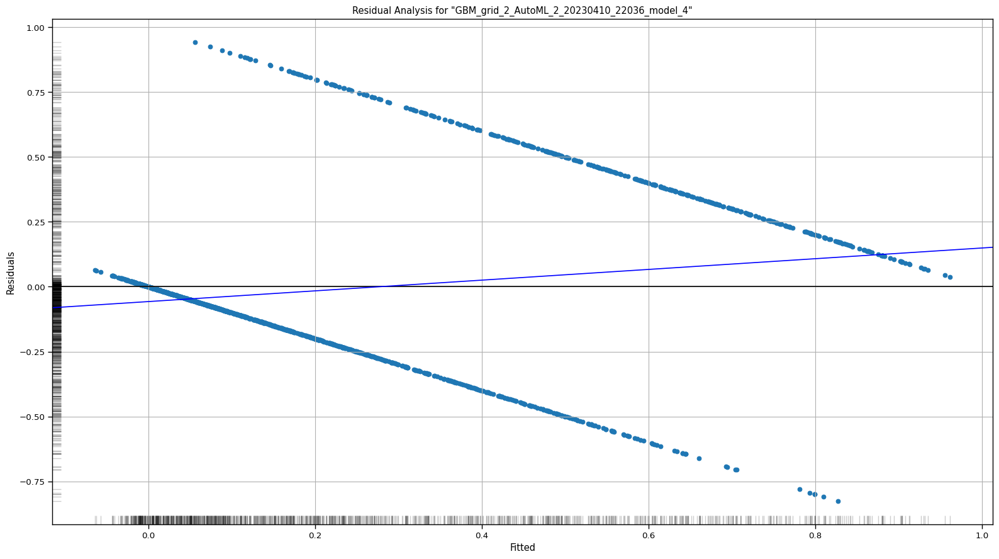

# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

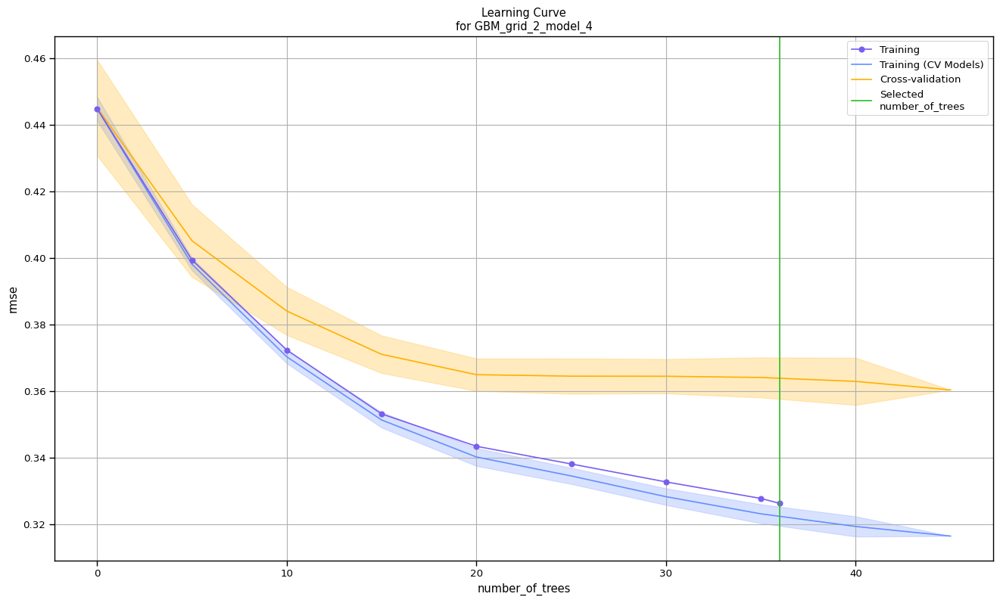

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

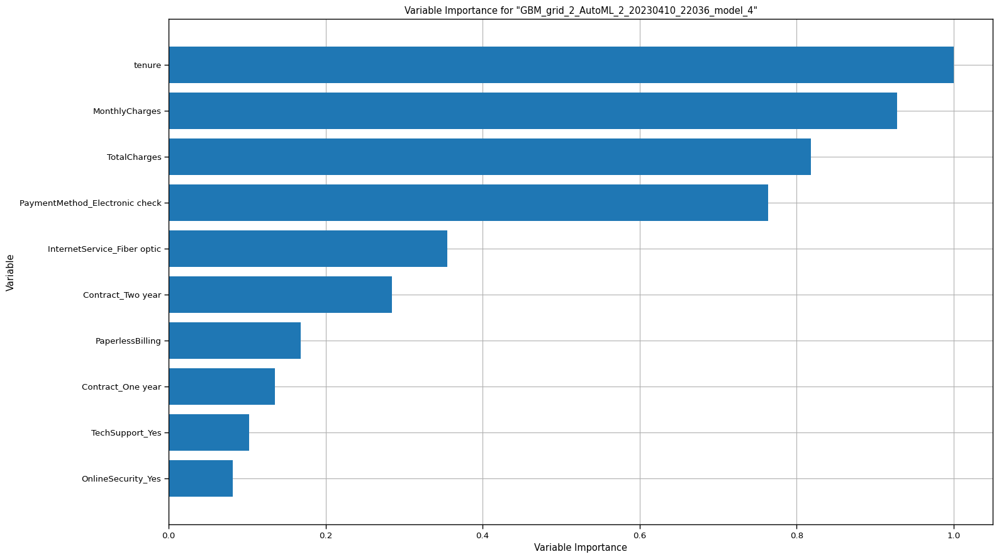

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

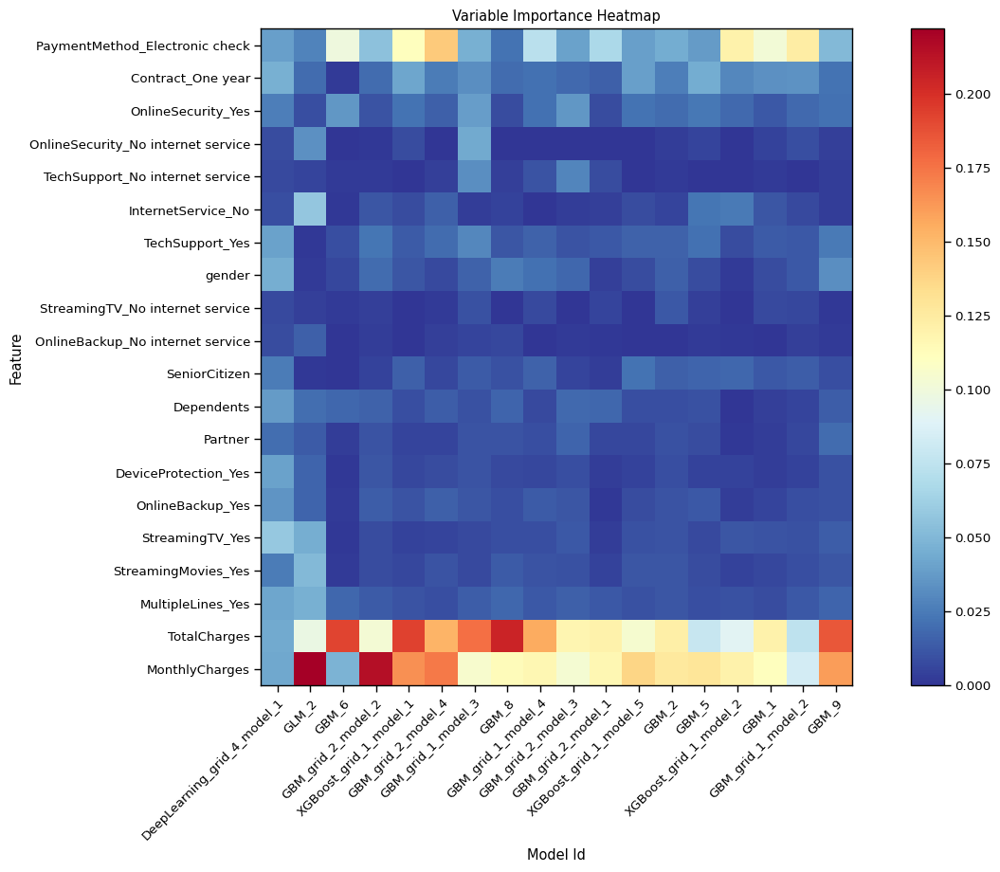

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

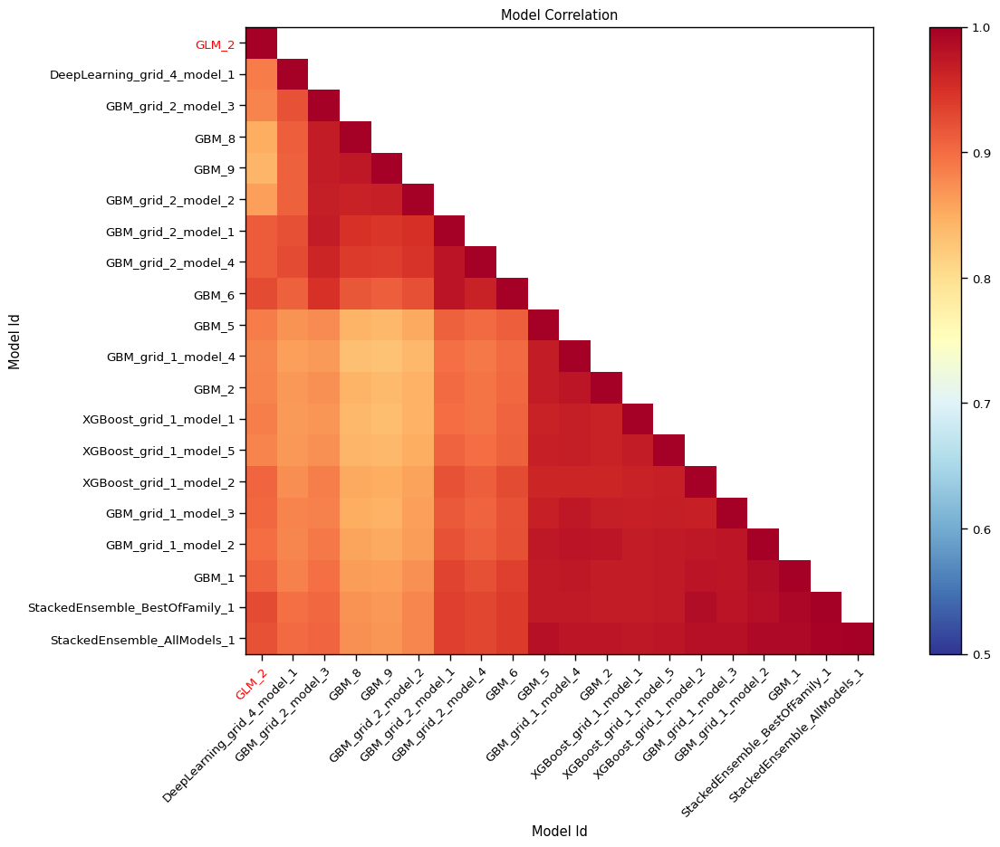

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

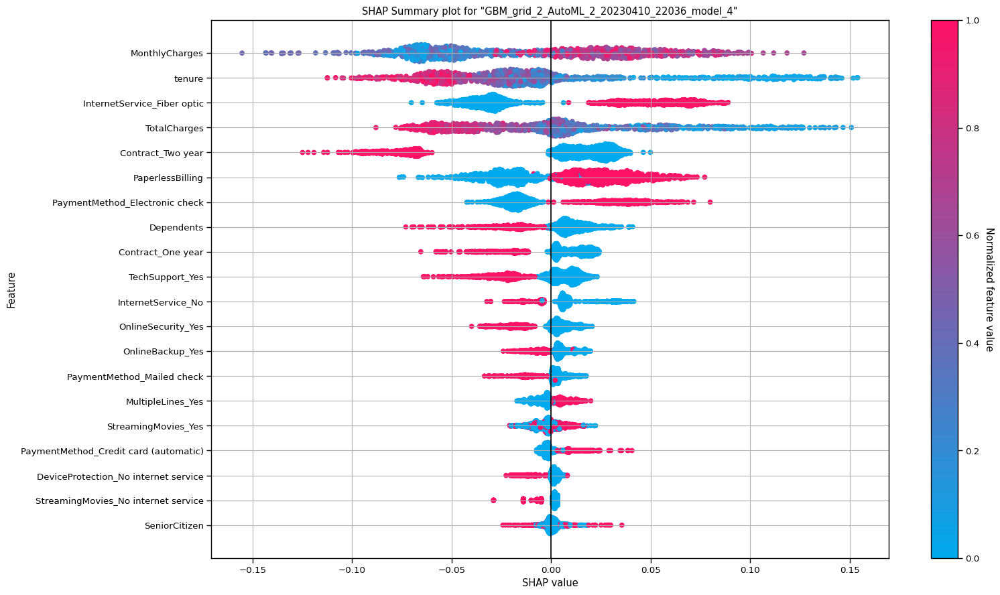

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

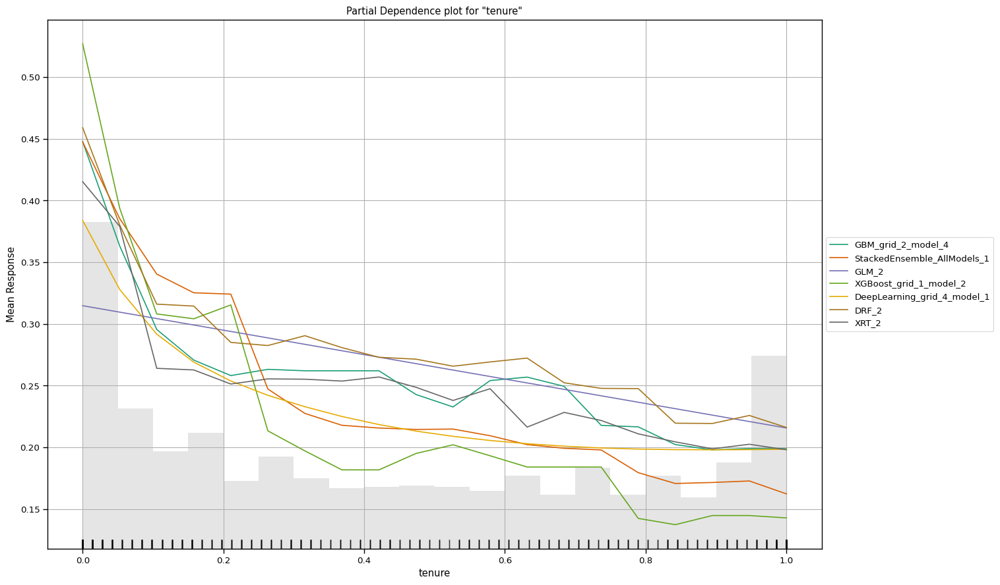

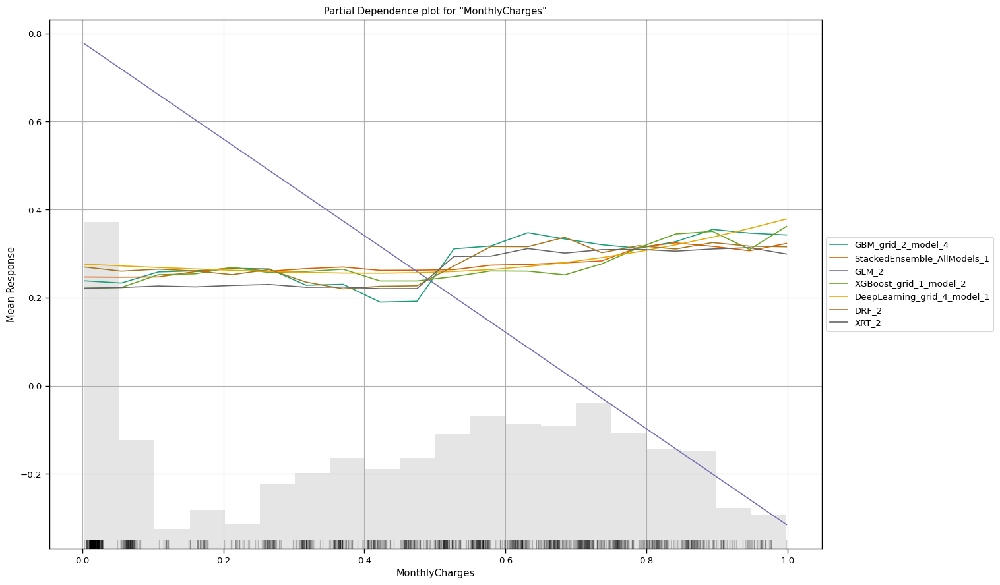

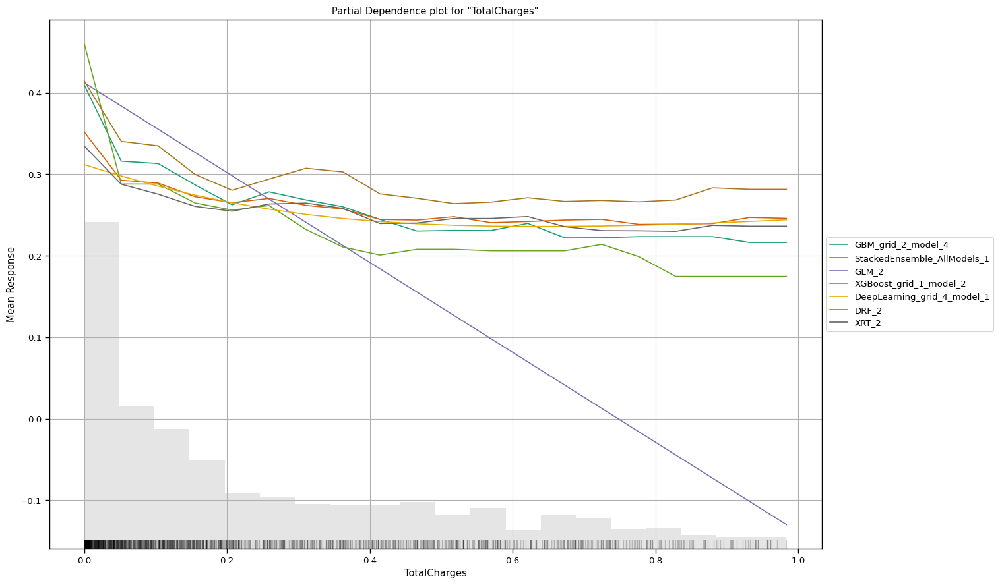

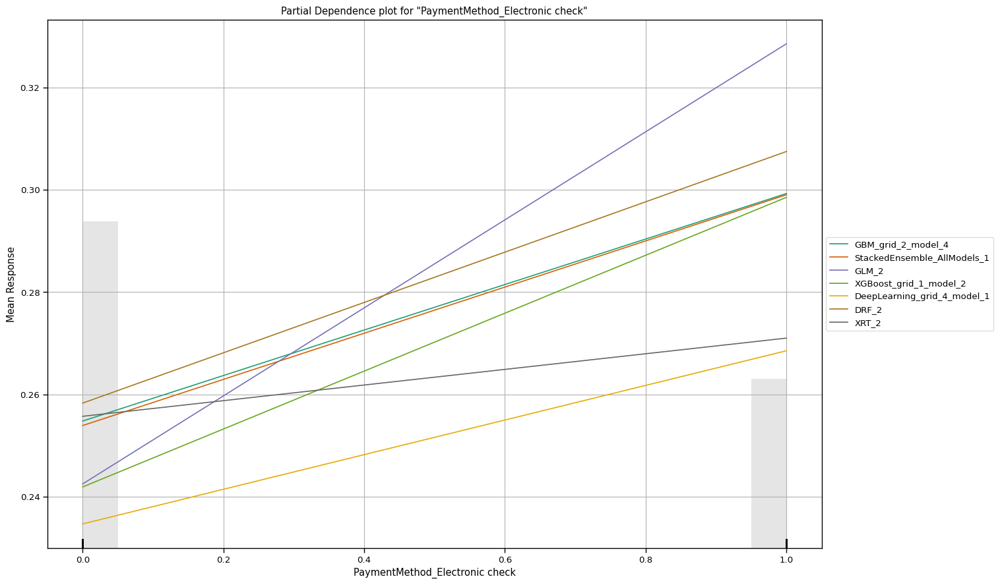

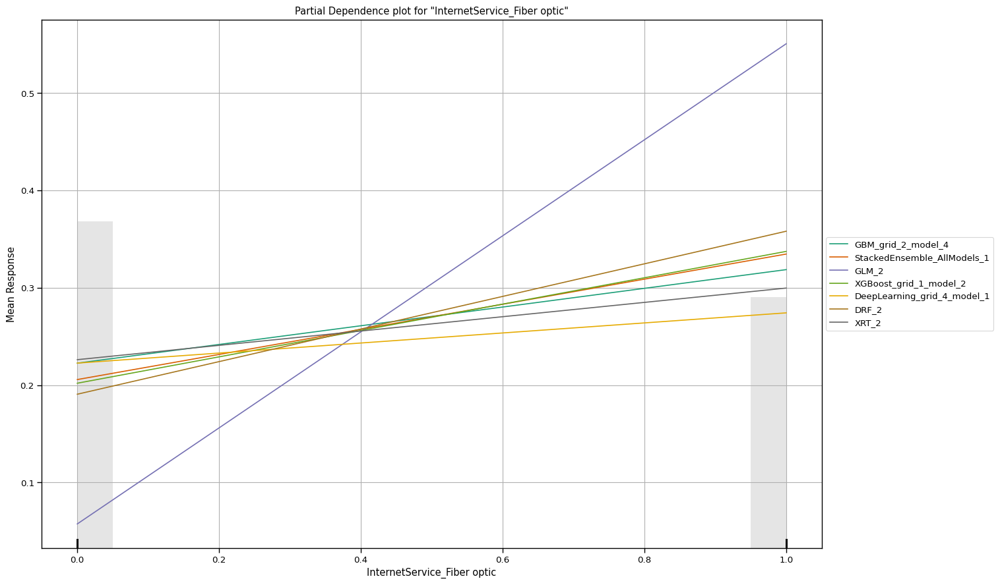

# Individual Conditional Expectation

> An Individual Conditional Expectation (ICE) plot gives a graphical depiction of the marginal effect of a variable on the response. ICE plots are similar to partial dependence plots (PDP); PDP shows the average effect of a feature while ICE plot shows the effect for a single instance. This function will plot the effect for each decile. In contrast to the PDP, ICE plots can provide more insight, especially when there is stronger feature interaction.

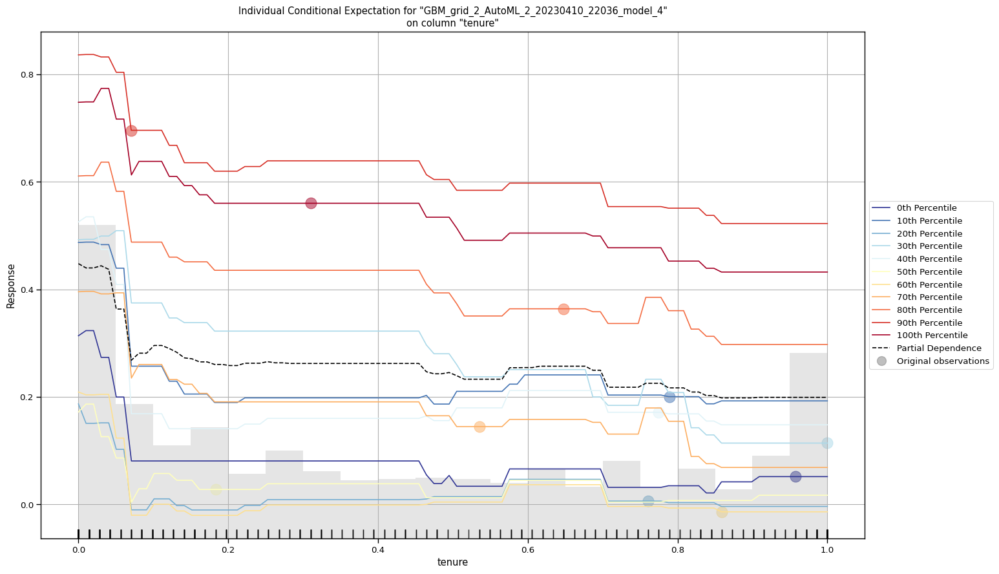

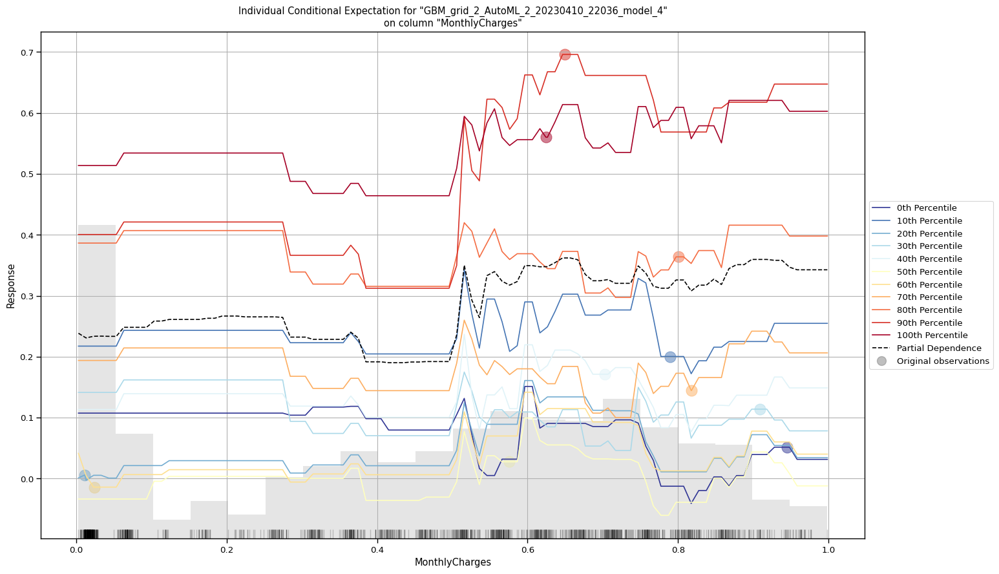

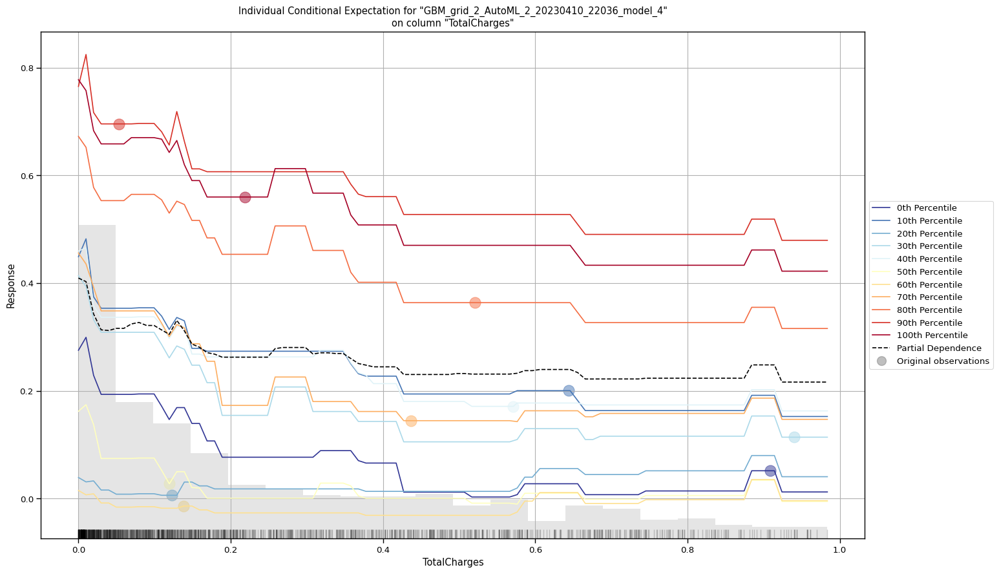

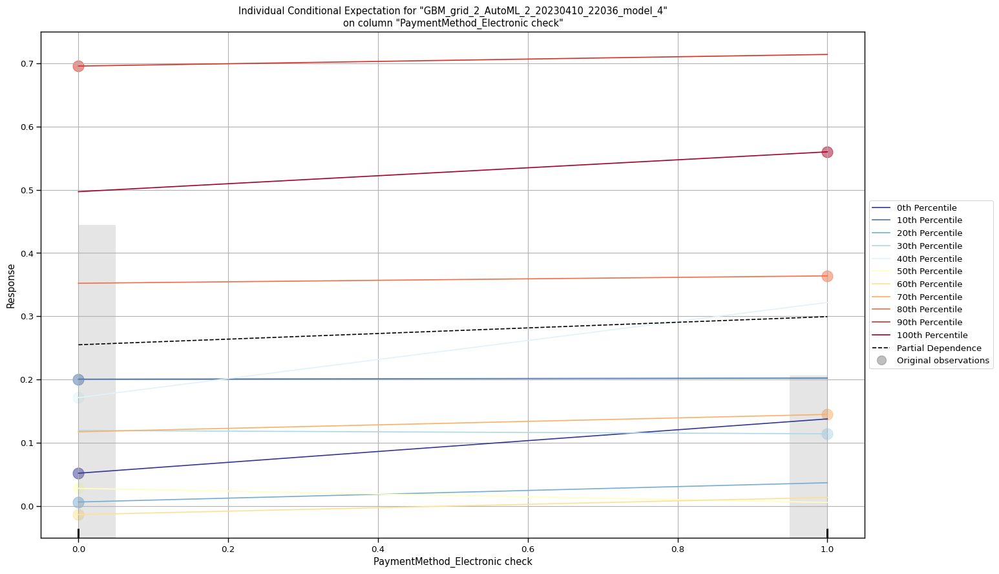

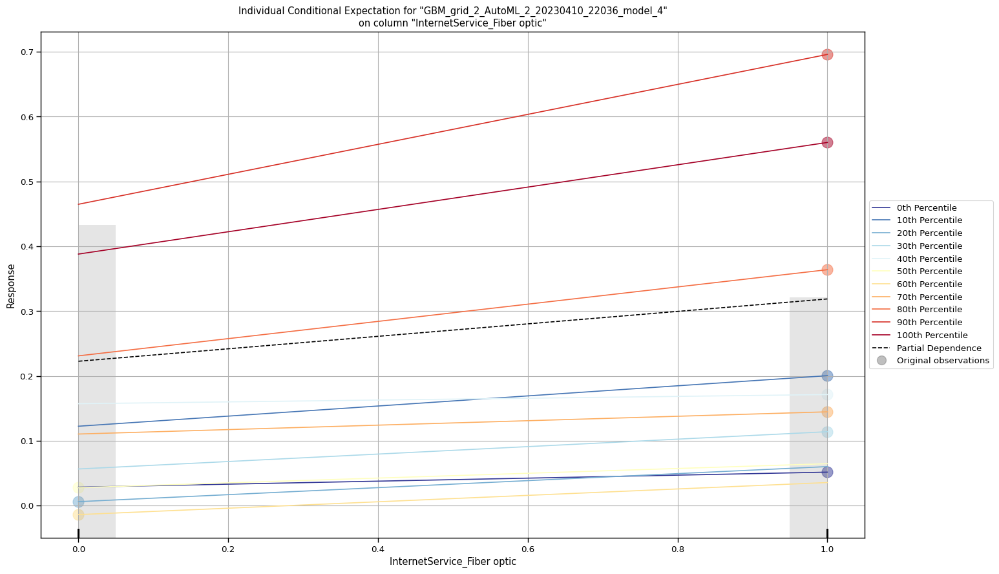

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,rmse,mse,mae,rmsle,mean_residual_deviance,training_time_ms,predict_time_per_row_ms,algo
XGBoost_grid_2_AutoML_2_20230410_22036_model_2,0.0557426,0.00310723,0.0359839,0.0415773,0.00310723,223,0.005898,XGBoost
XGBoost_5_AutoML_2_20230410_22036,0.14941,0.0223235,0.103794,0.109594,0.0223235,268,0.005717,XGBoost
DRF_2_AutoML_2_20230410_22036,0.150049,0.0225146,0.10019,0.107308,0.0225146,256,0.012152,DRF
XGBoost_grid_2_AutoML_2_20230410_22036_model_3,0.16625,0.0276392,0.110701,0.118768,0.0276392,171,0.004019,XGBoost
XGBoost_4_AutoML_2_20230410_22036,0.193166,0.0373132,0.134002,0.139852,0.0373132,261,0.004767,XGBoost
XGBoost_grid_2_AutoML_2_20230410_22036_model_1,0.197305,0.0389294,0.134374,0.140108,0.0389294,155,0.004974,XGBoost
DeepLearning_grid_4_AutoML_2_20230410_22036_model_2,0.214781,0.046131,0.130148,0.152929,0.046131,18497,0.005568,DeepLearning
XGBoost_grid_2_AutoML_2_20230410_22036_model_4,0.254856,0.0649517,0.177947,0.179993,0.0649517,117,0.003102,XGBoost
XGBoost_grid_2_AutoML_2_20230410_22036_model_5,0.255078,0.0650648,0.181857,0.181392,0.0650648,137,0.003167,XGBoost
XGBoost_6_AutoML_2_20230410_22036,0.256408,0.0657451,0.177479,0.180707,0.0657451,87,0.002796,XGBoost


# Residual Analysis

> Residual Analysis plots the fitted values vs residuals on a test dataset. Ideally, residuals should be randomly distributed. Patterns in this plot can indicate potential problems with the model selection, e.g., using simpler model than necessary, not accounting for heteroscedasticity, autocorrelation, etc. Note that if you see "striped" lines of residuals, that is an artifact of having an integer valued (vs a real valued) response variable.

# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

# Individual Conditional Expectation

> An Individual Conditional Expectation (ICE) plot gives a graphical depiction of the marginal effect of a variable on the response. ICE plots are similar to partial dependence plots (PDP); PDP shows the average effect of a feature while ICE plot shows the effect for a single instance. This function will plot the effect for each decile. In contrast to the PDP, ICE plots can provide more insight, especially when there is stronger feature interaction.

In [126]:
# AutoML Explainability
aml.explain(test)

In [127]:
# Taking 100 samples out for SHAP analysis
x_train_100 = shap.utils.sample(
    X_train, 100
) 

# Taking 100 samples out for SHAP analysis
x_test_100 = shap.utils.sample(
    X_test, 100
)  

In [128]:
# Initializing a Linear Model
linear_model = sklearn.linear_model.LinearRegression()  
# Training a linear model
linear_model.fit(X_train, y_train)  

LinearRegression()

Permutation explainer: 4908it [02:39, 29.26it/s]                          


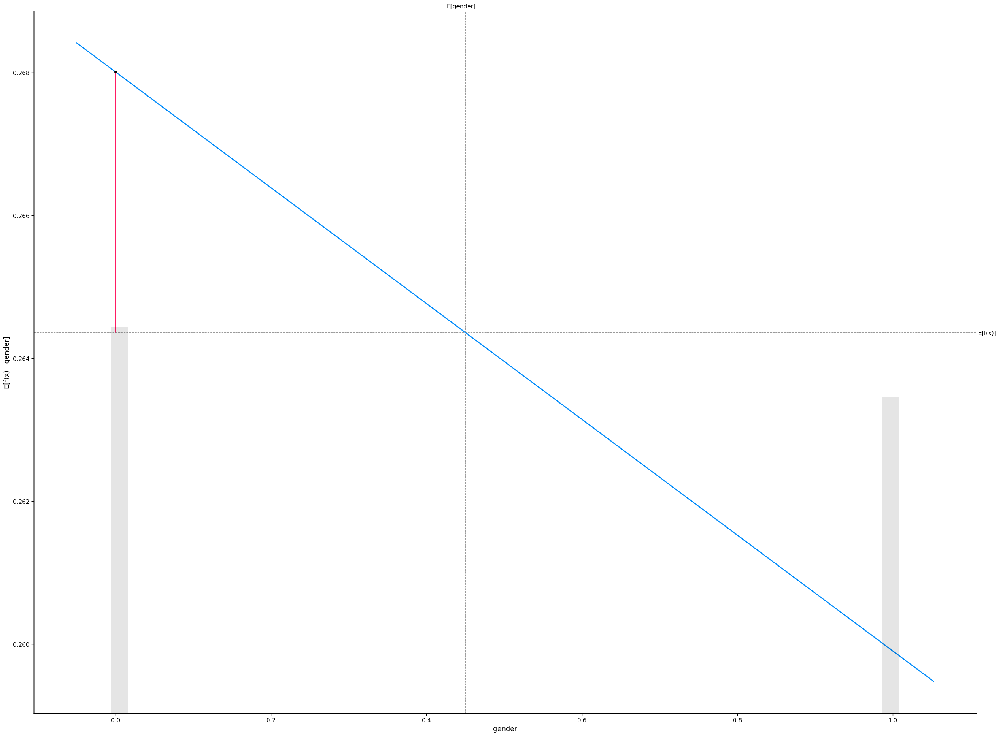

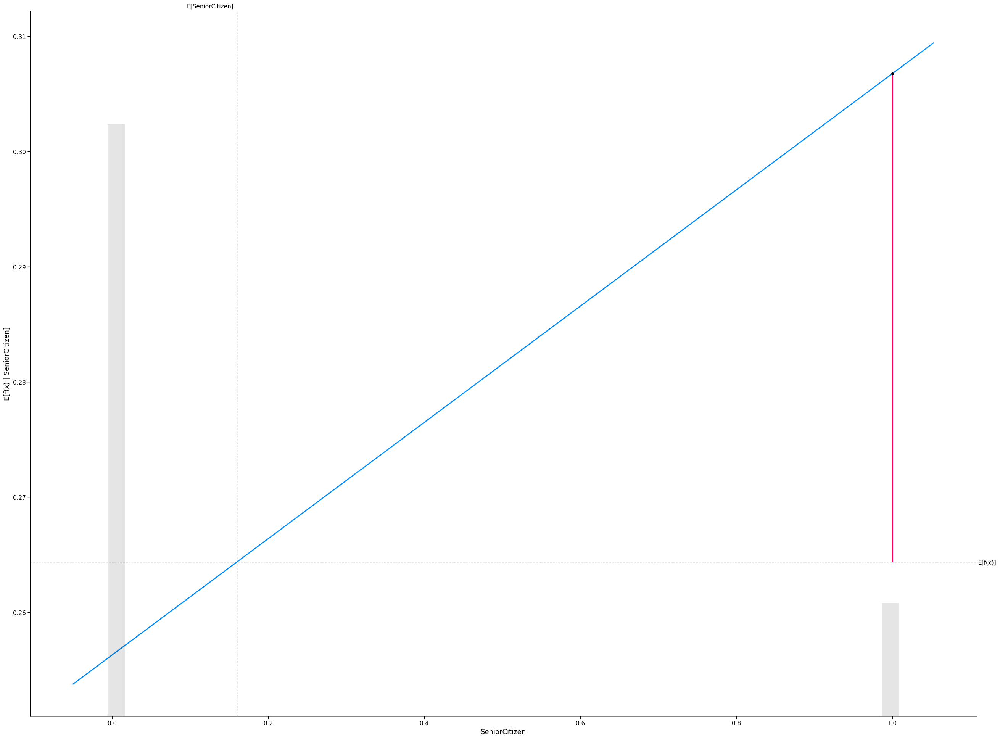

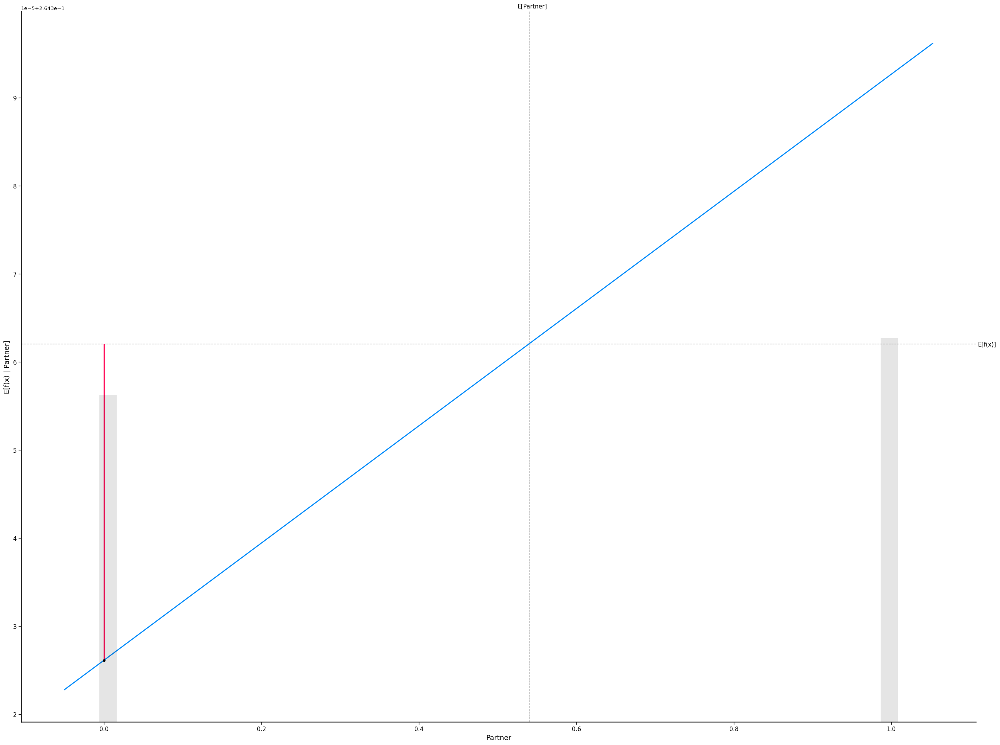

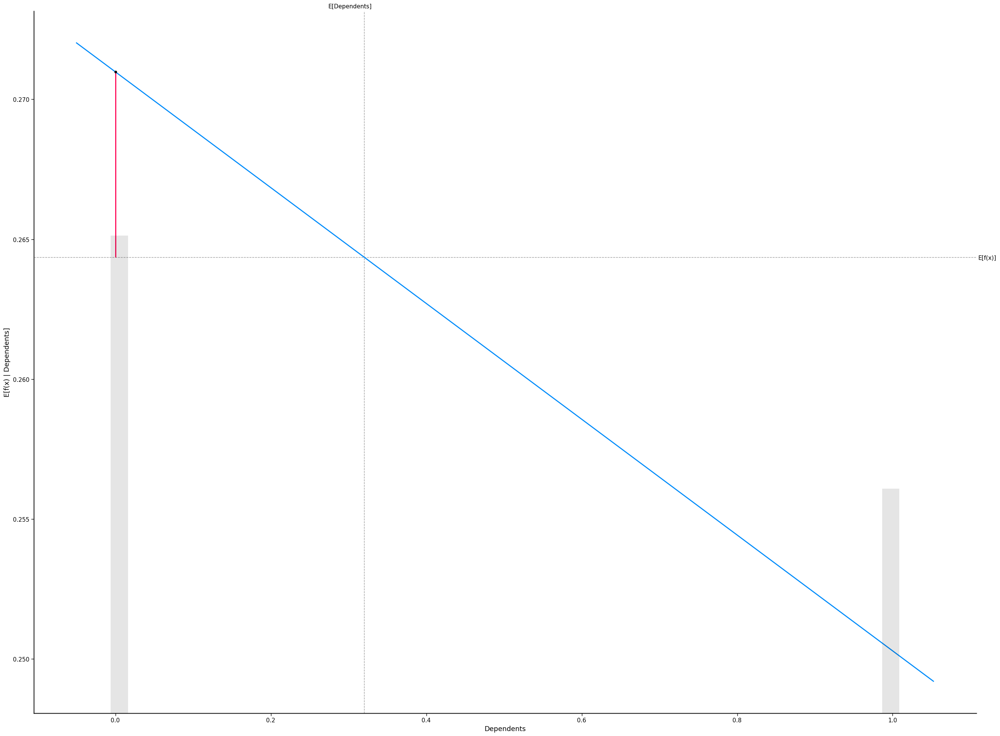

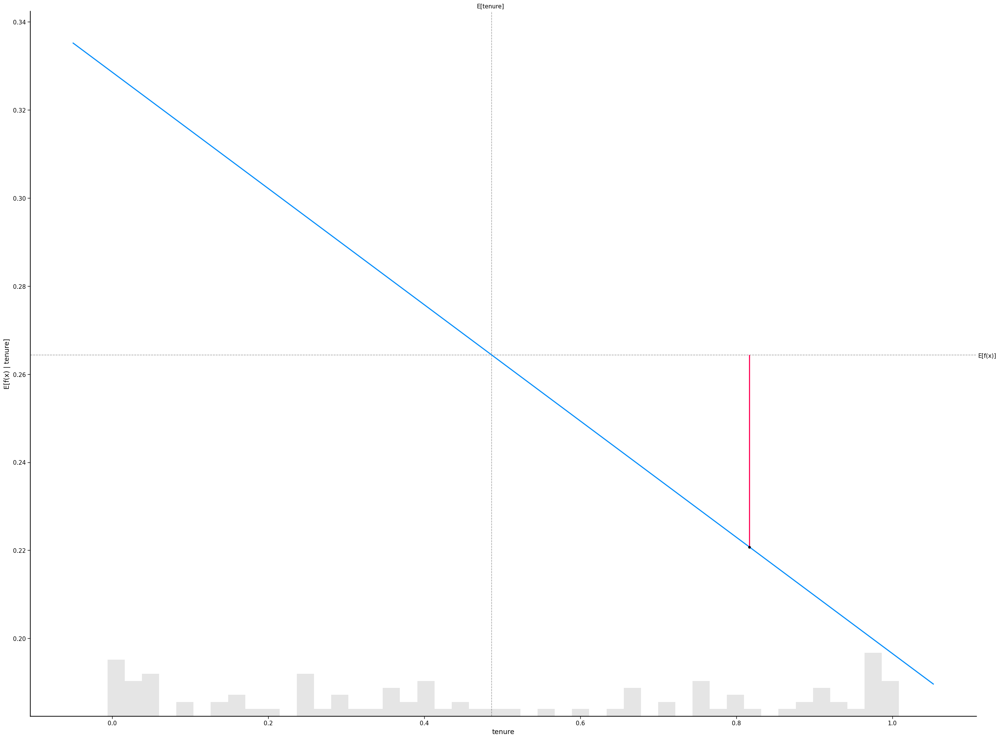

...

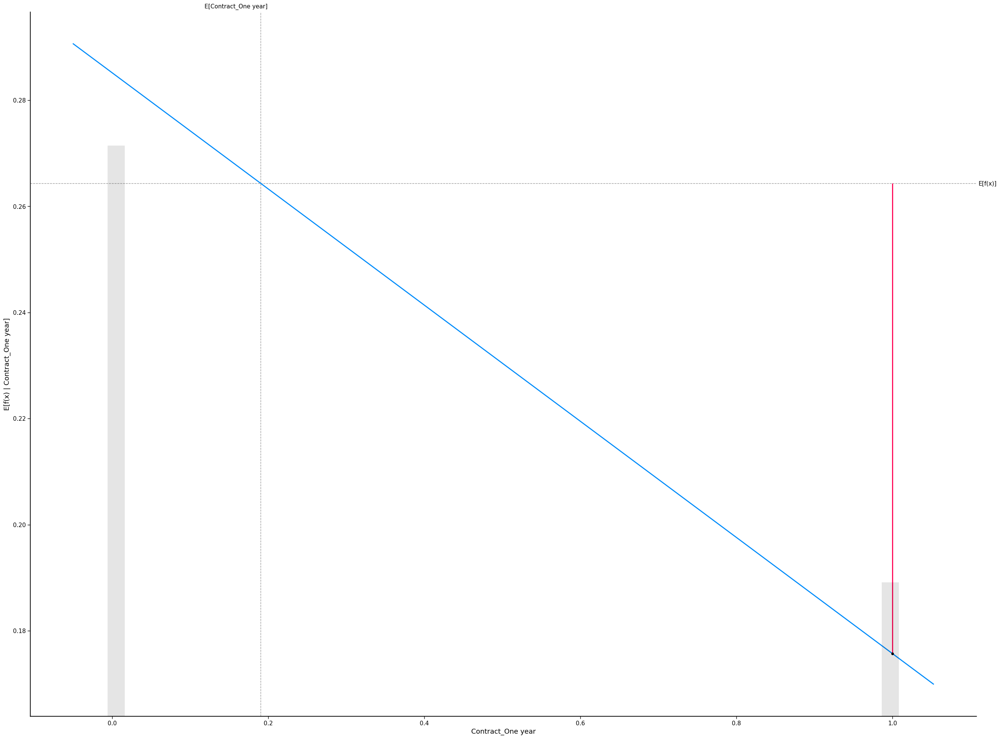

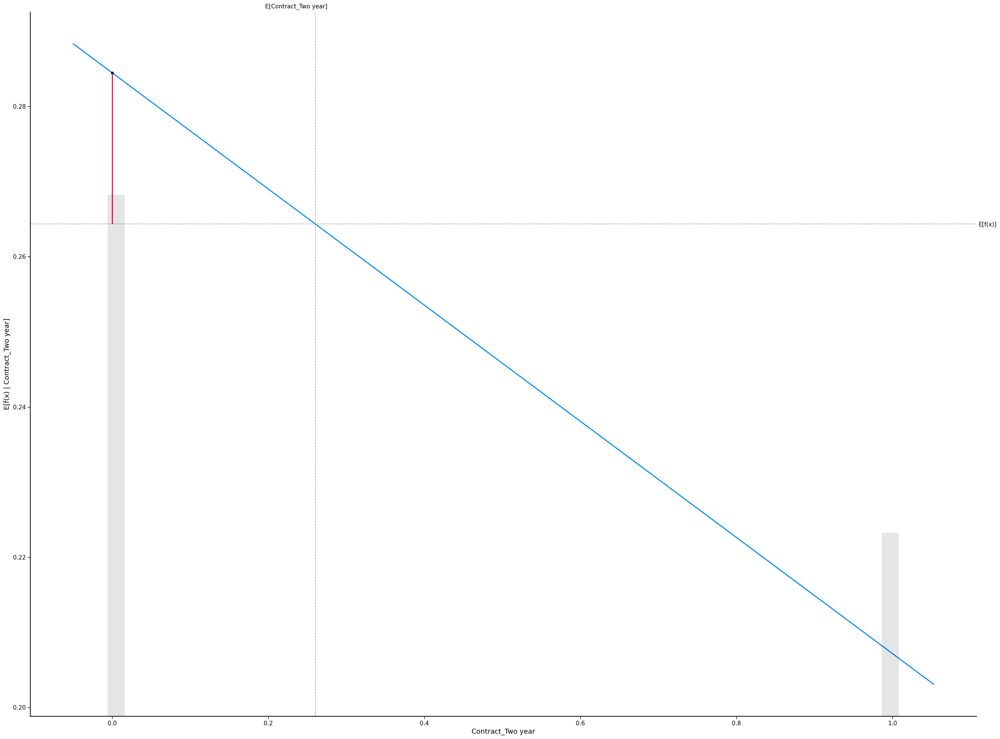

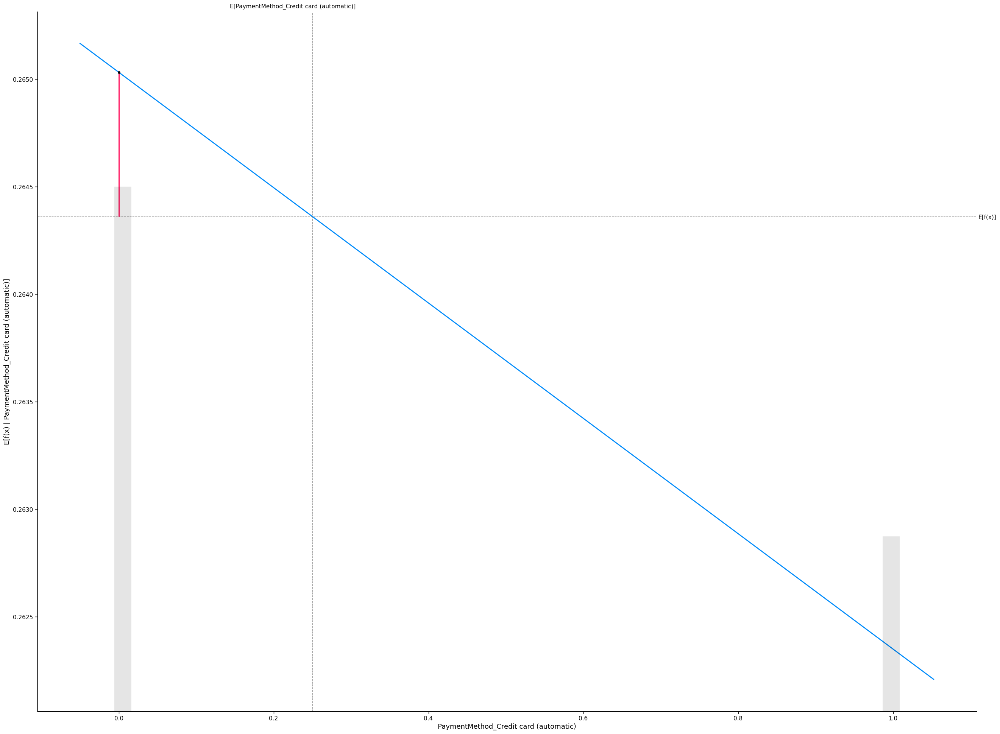

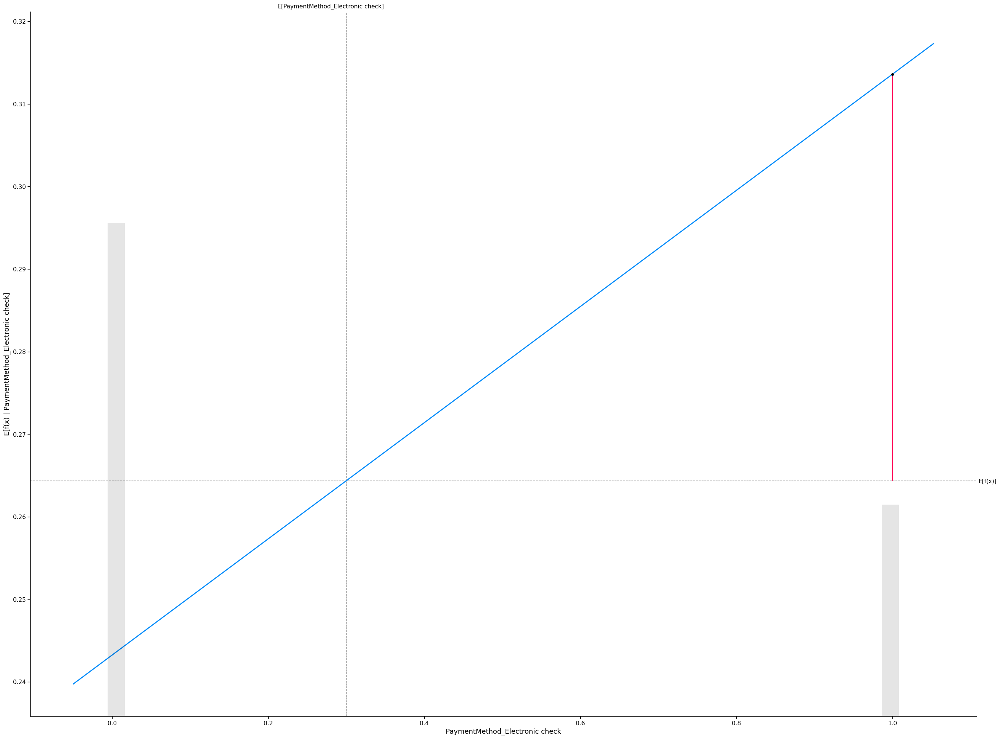

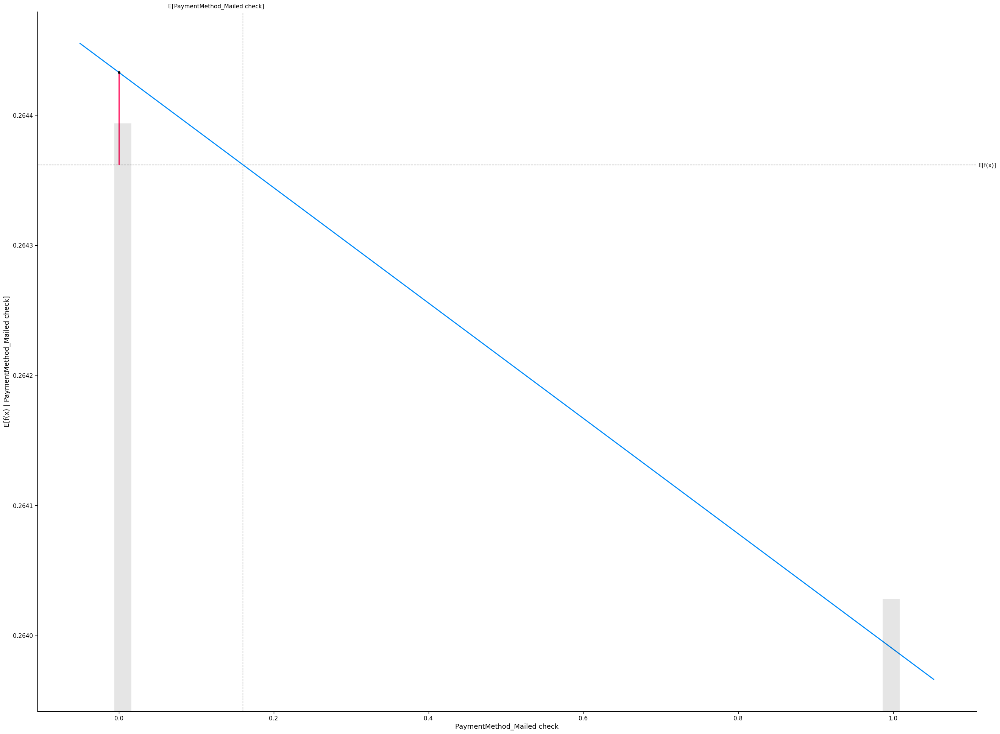

In [129]:
# SHAP explanation of a Linear Model
linear_explainer = shap.Explainer(linear_model.predict, x_train_100)
linear_shap_values = linear_explainer(X_train)
for i in X_train.columns:
    # make a standard partial dependence plot
    sample_ind = 18
    shap.partial_dependence_plot(
        i,
        linear_model.predict,
        x_train_100,
        model_expected_value=True,
        feature_expected_value=True,
        ice=False,
        shap_values=linear_shap_values[sample_ind : sample_ind + 1, :],
    )

Streaming output truncated to the last 5000 lines.

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has featur

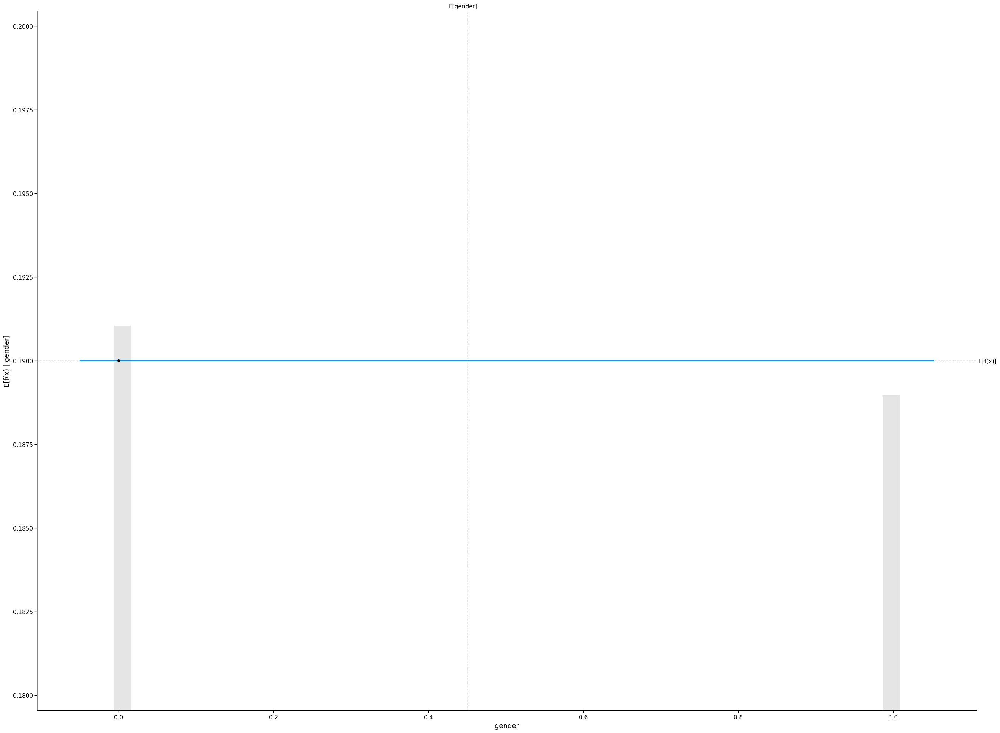

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

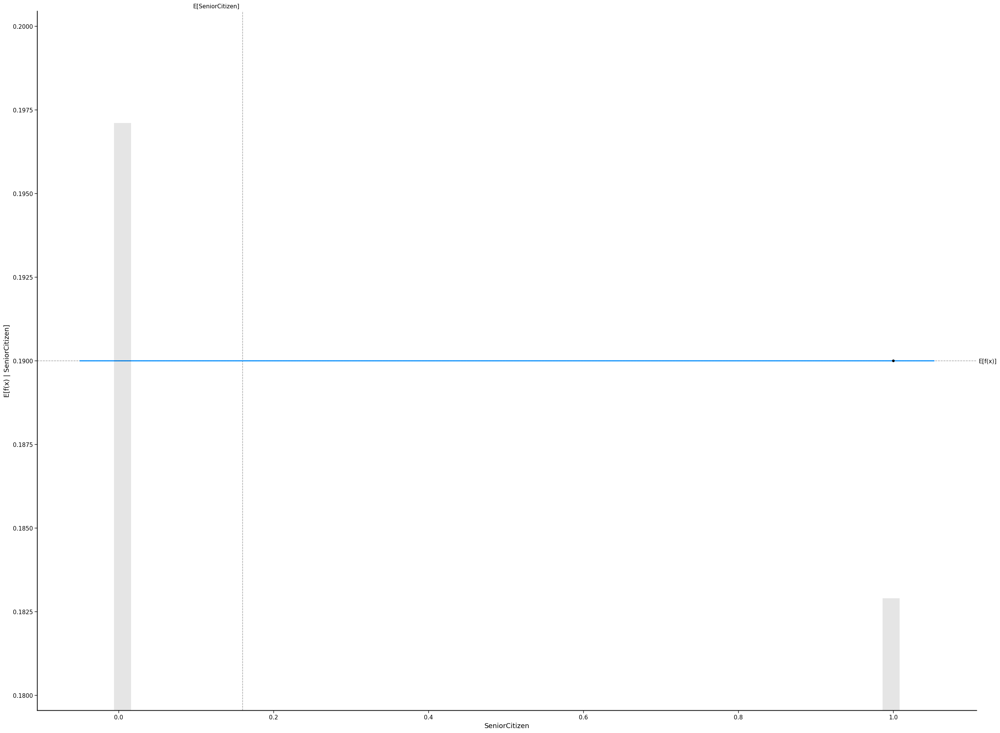

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

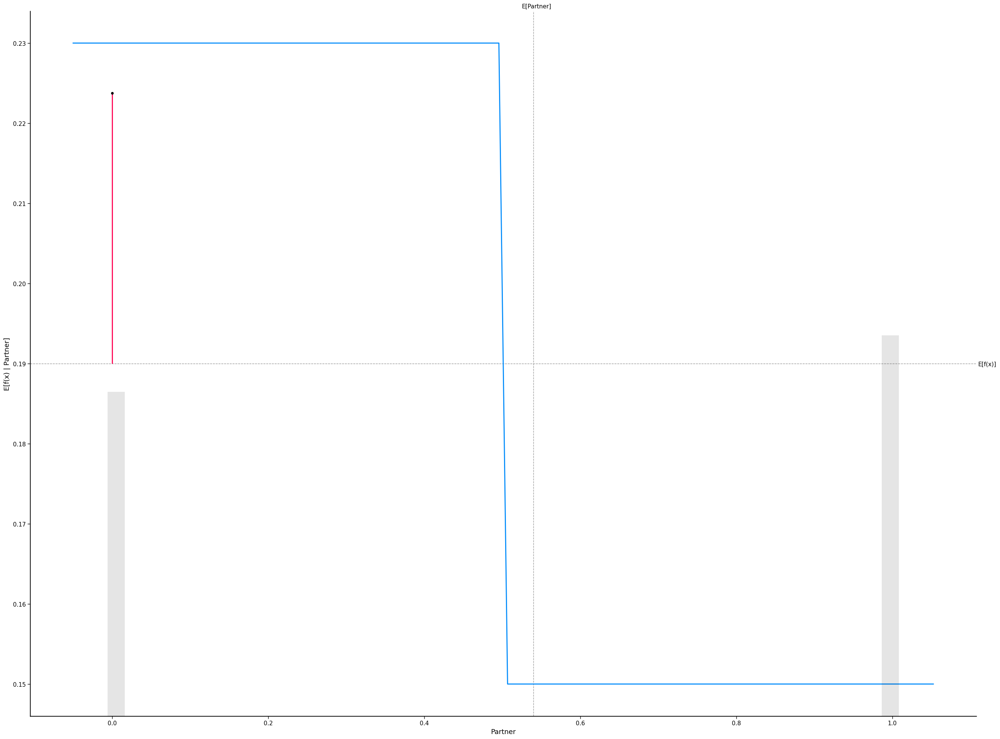

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

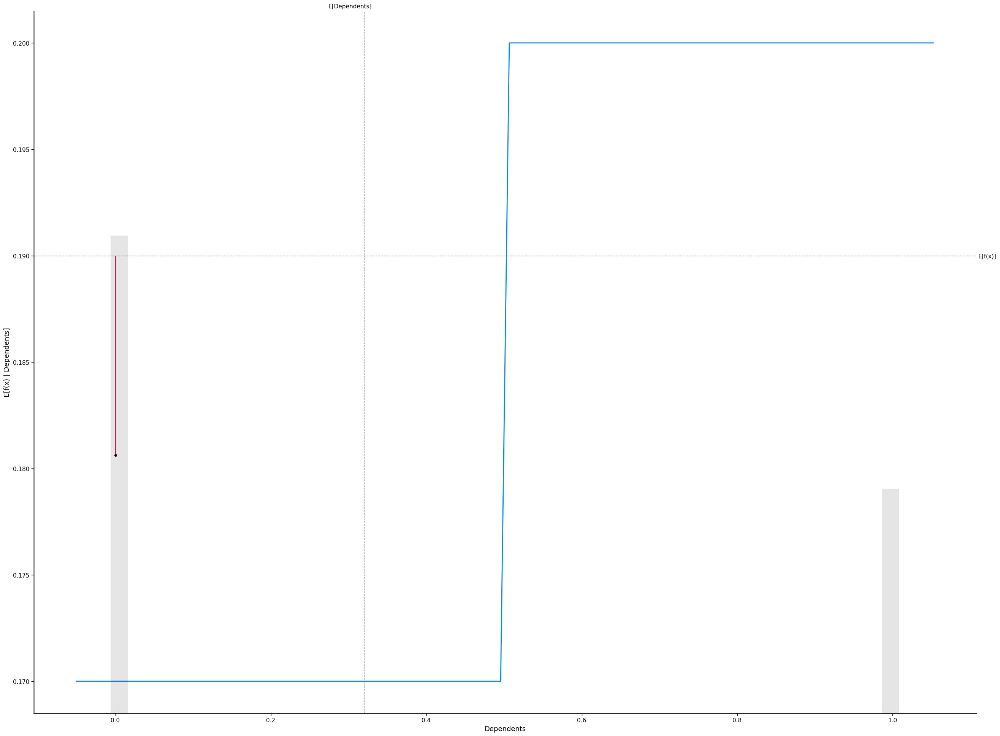

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

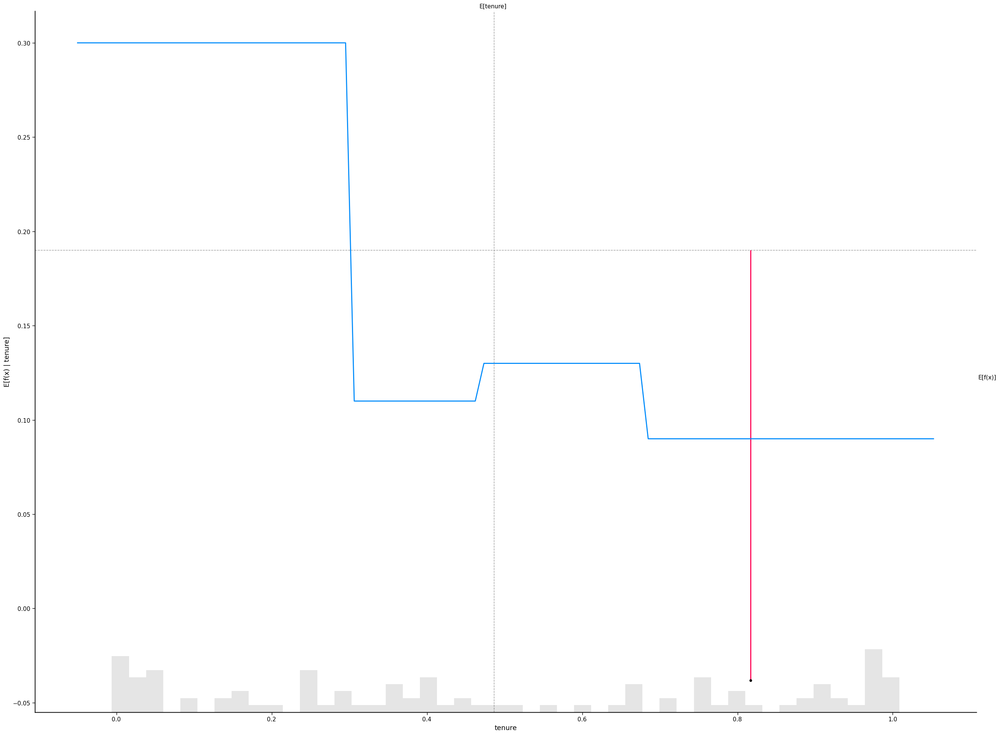

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

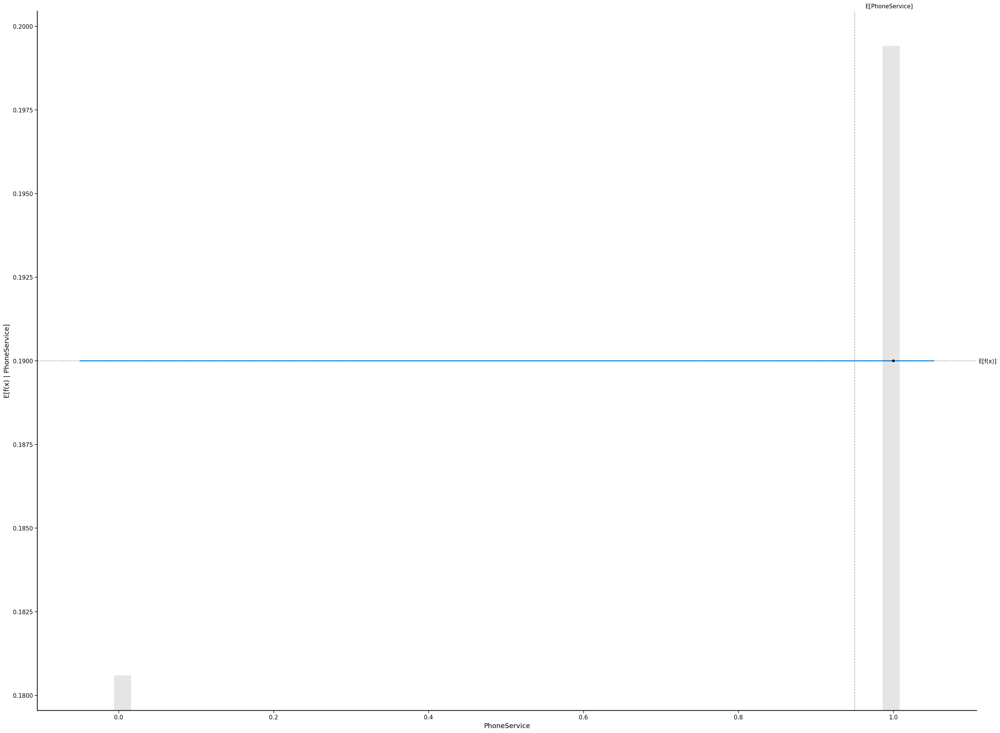

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

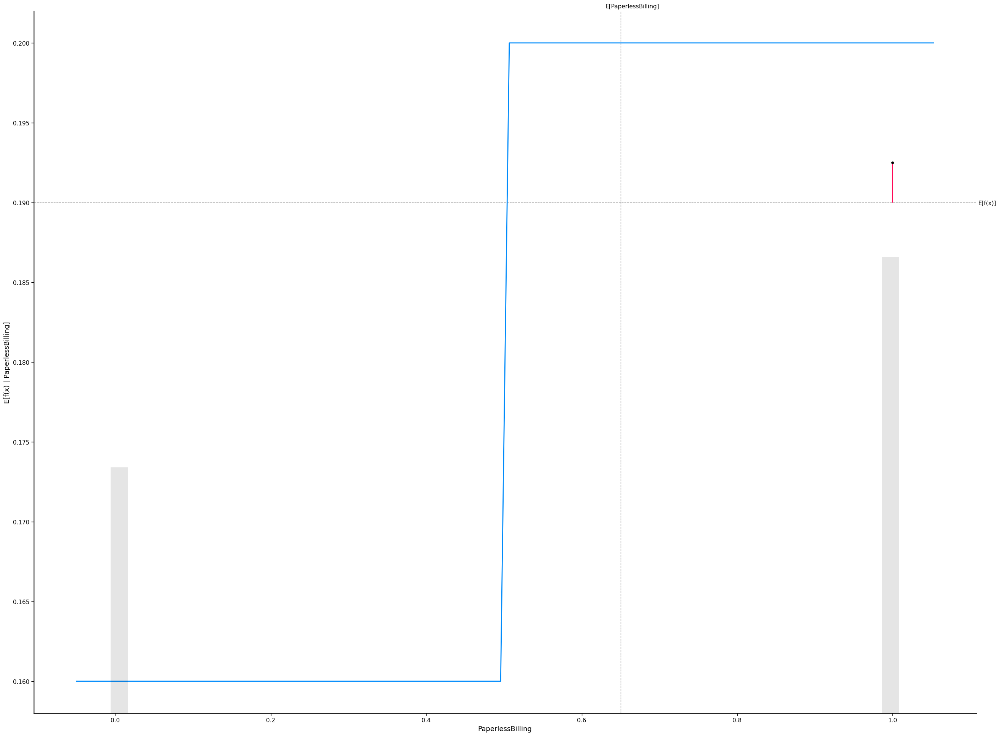

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

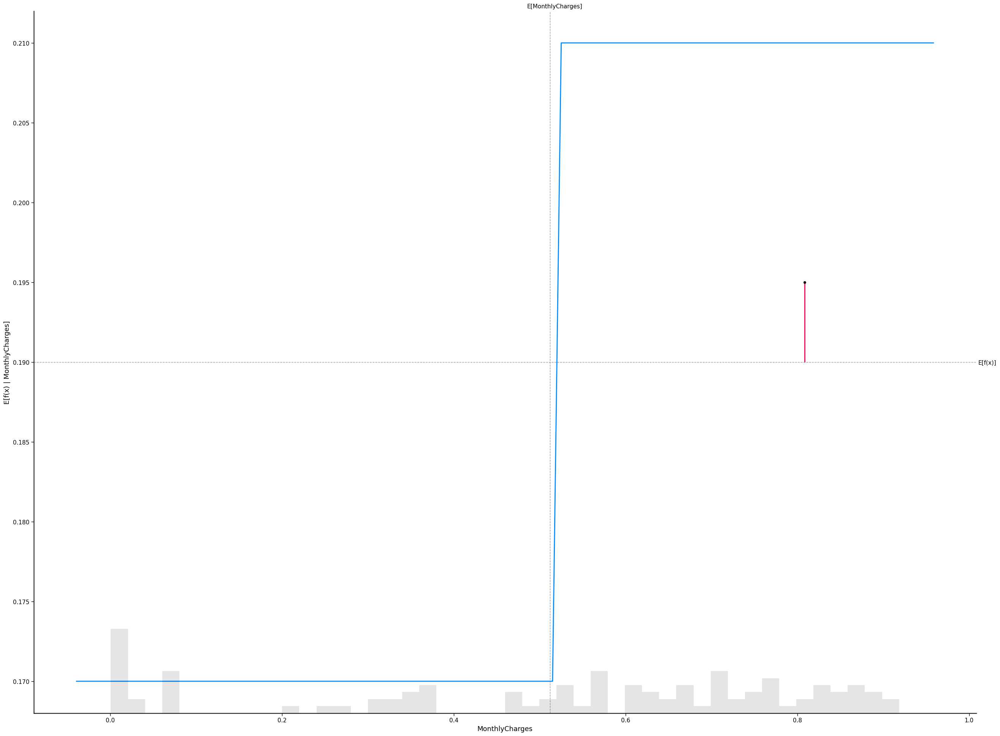

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

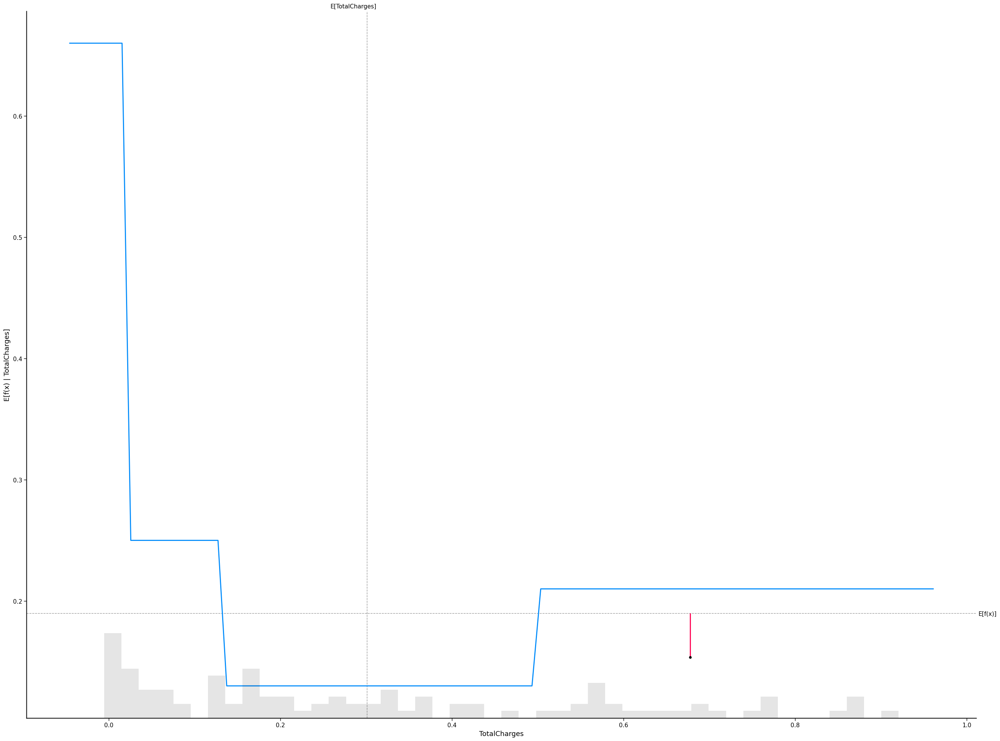

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

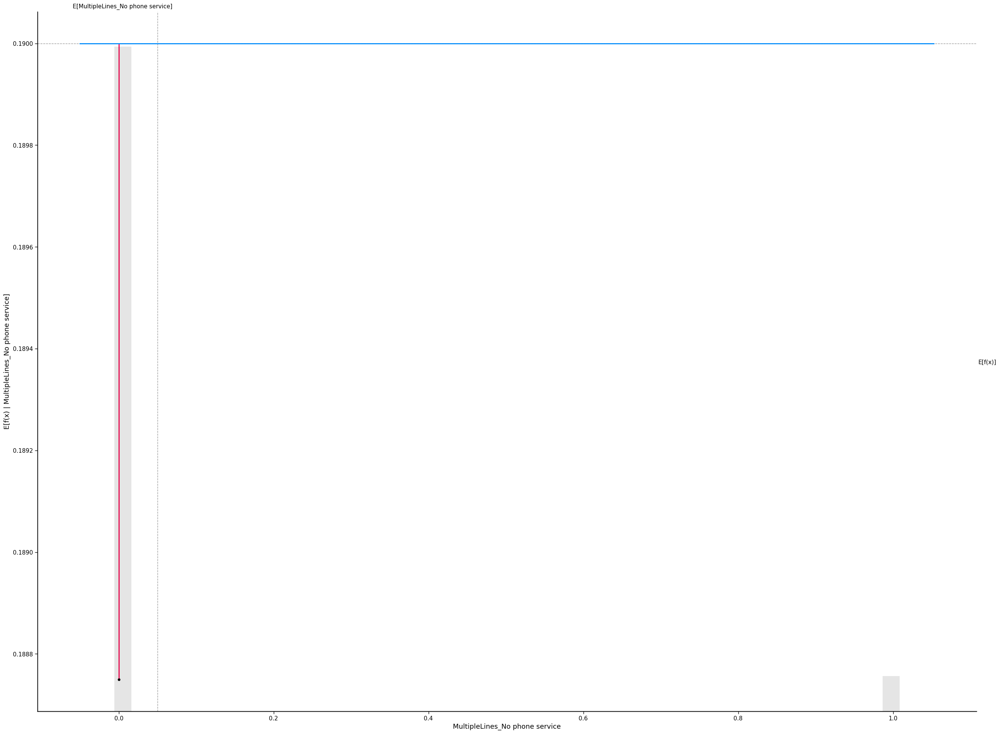

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

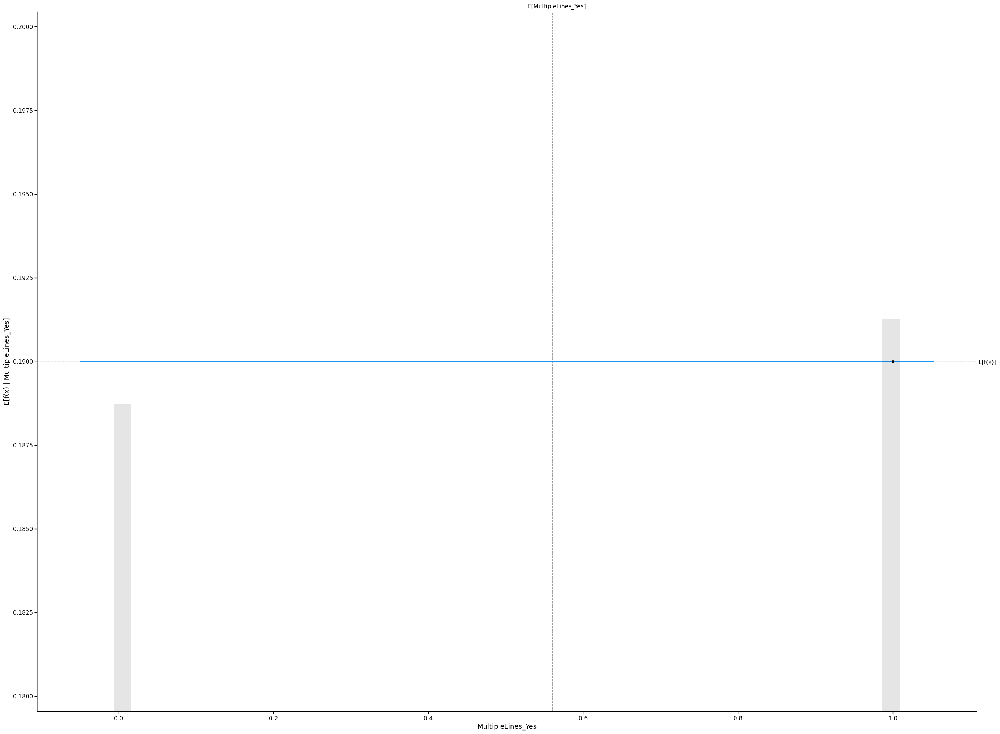

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

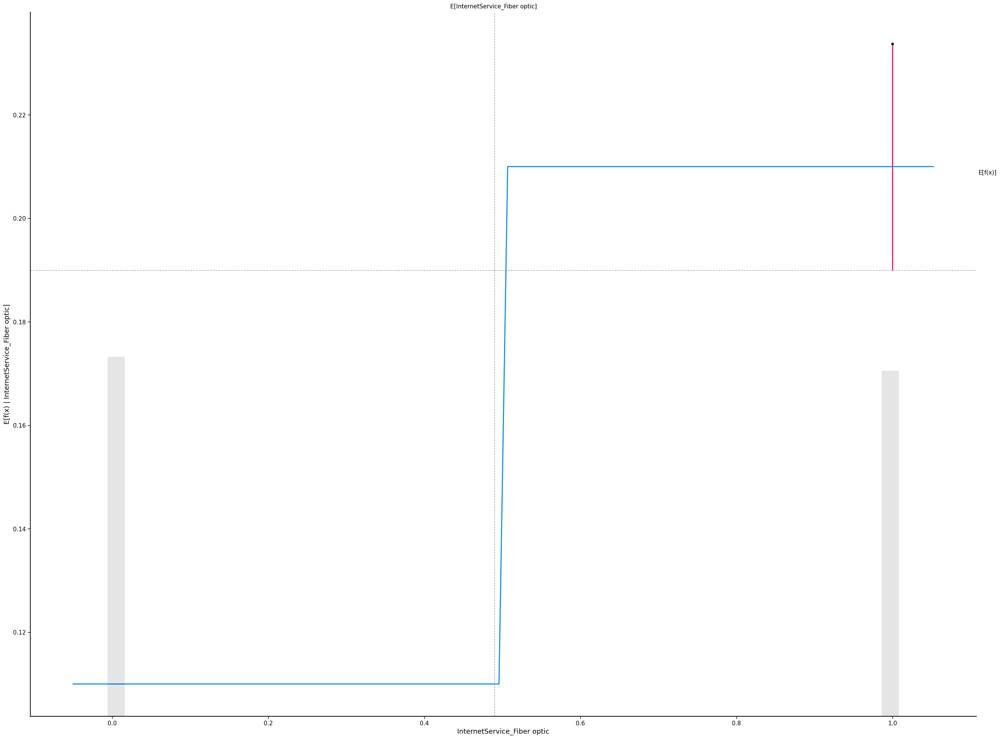

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

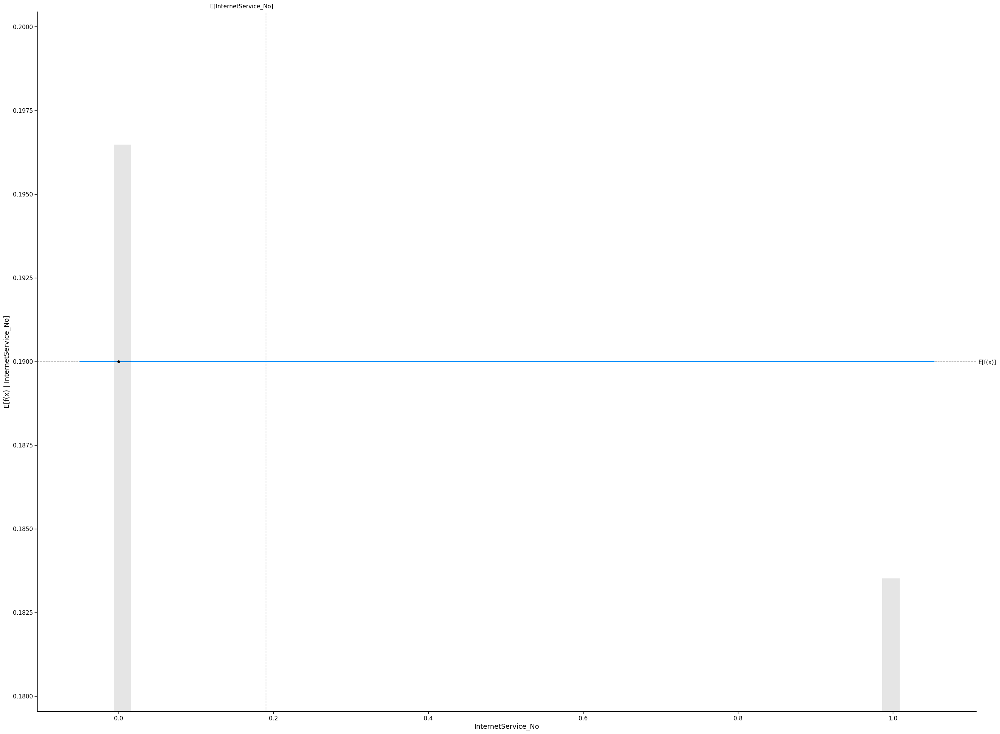

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

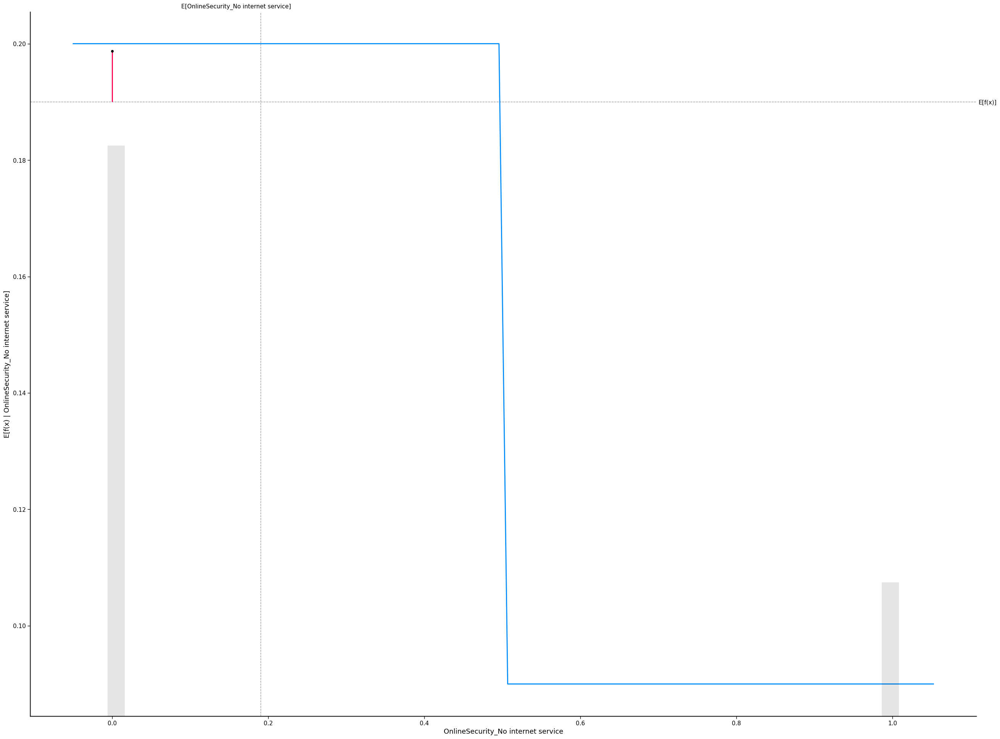

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

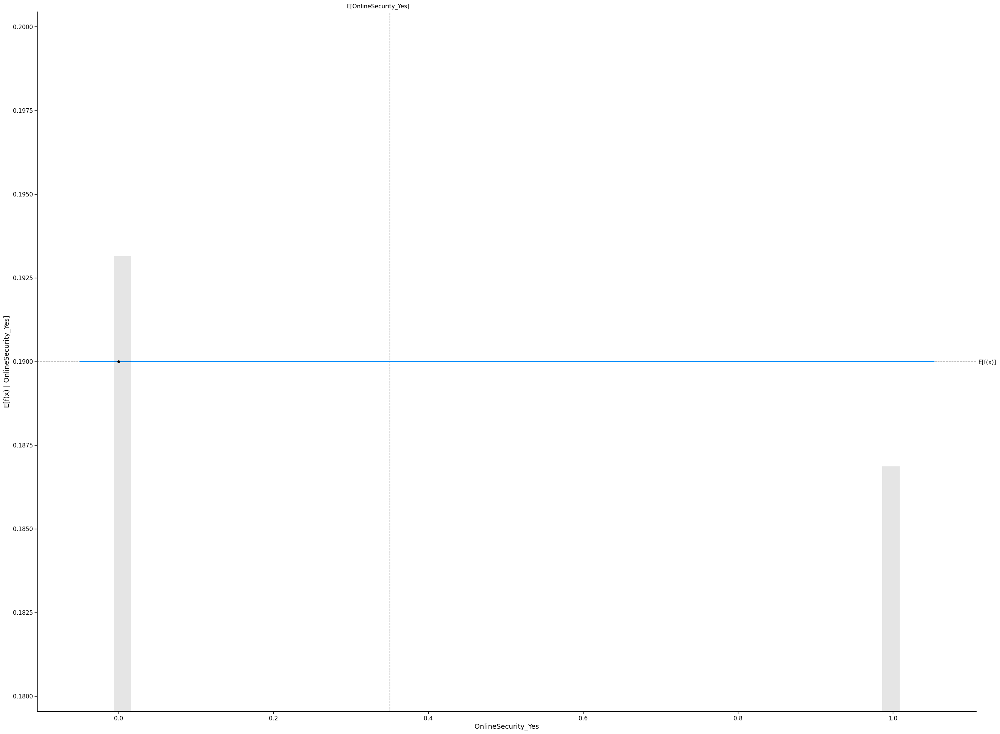

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

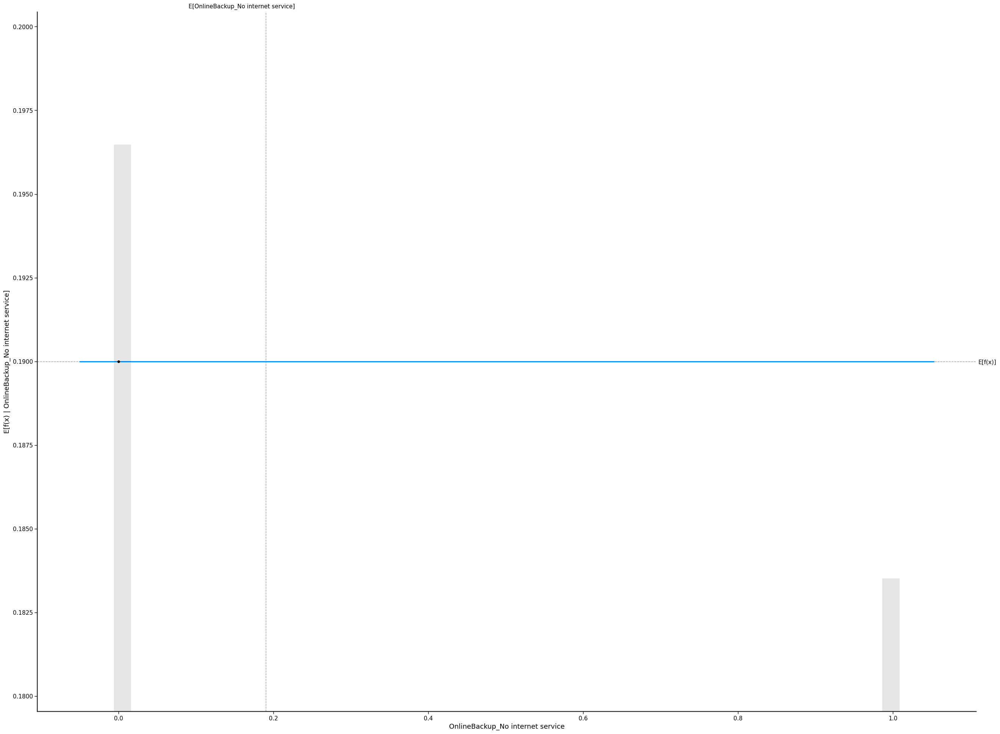

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

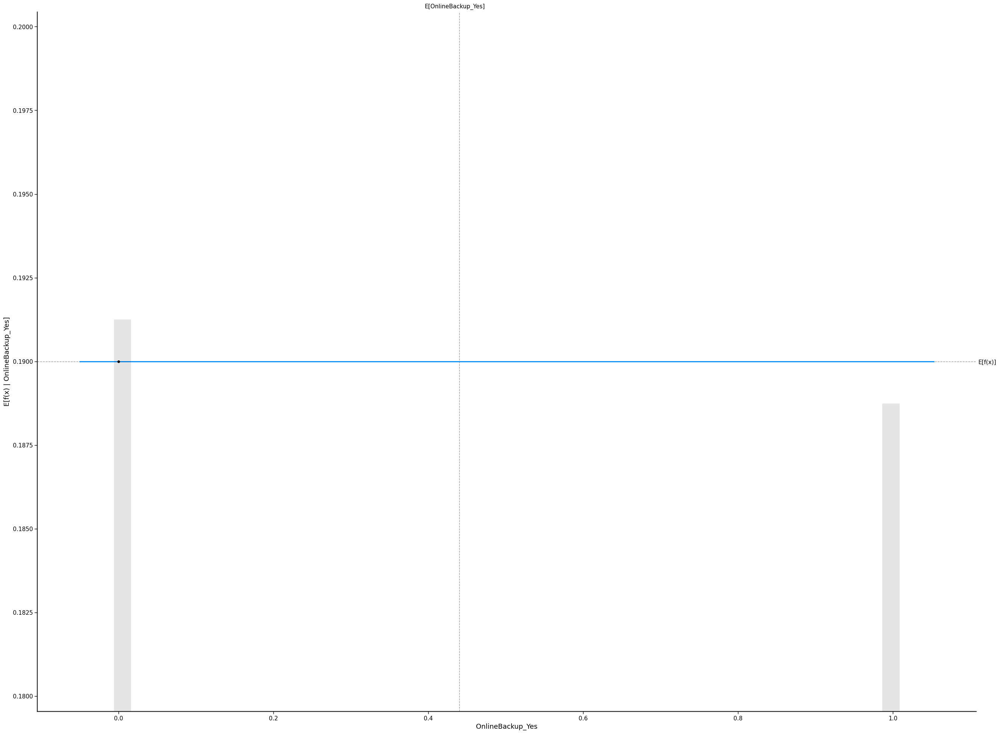

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

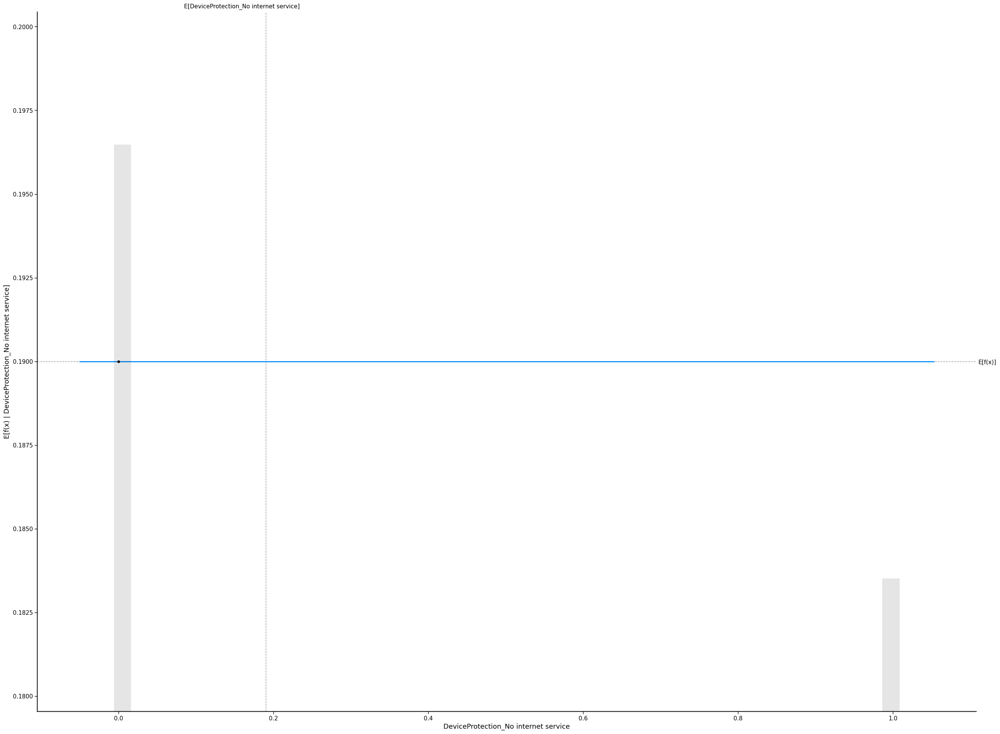

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

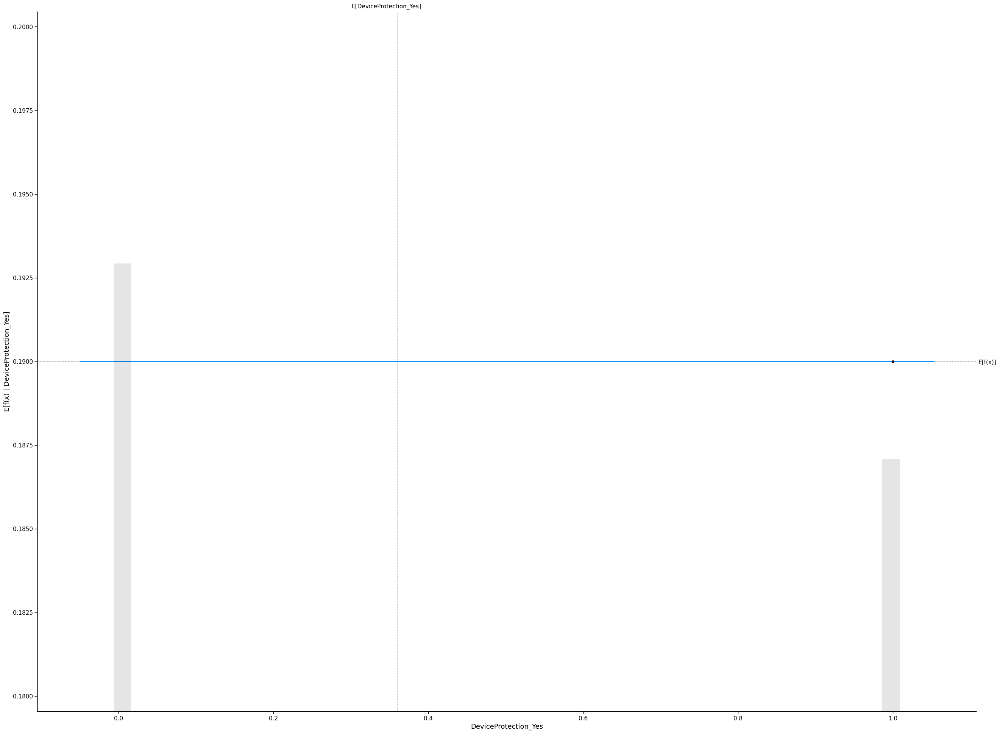

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

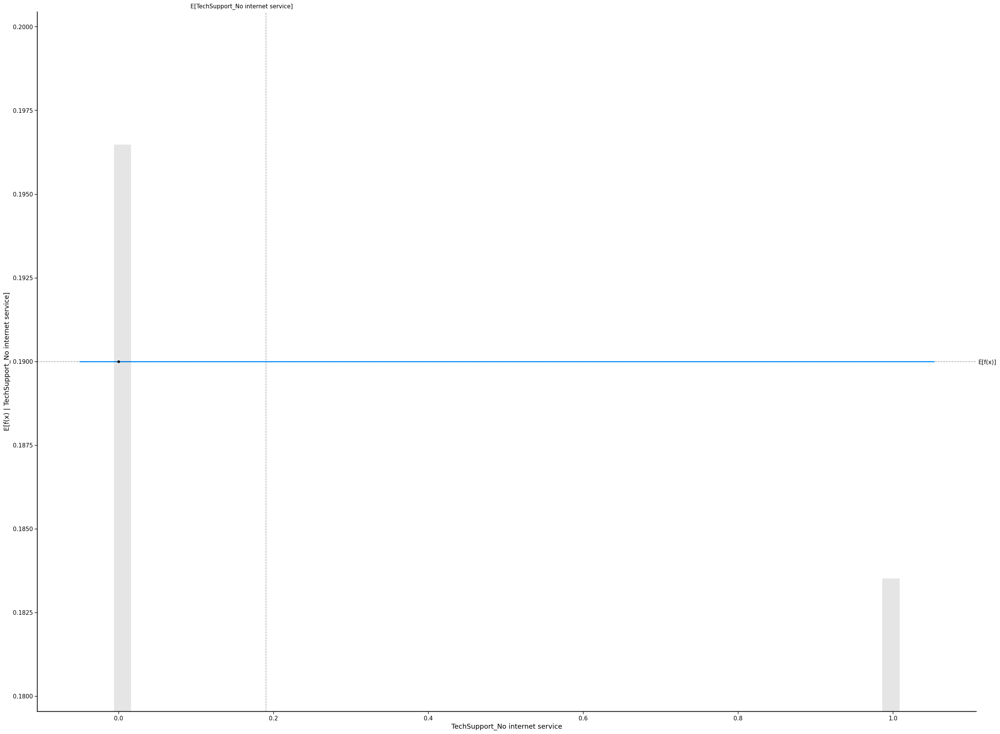

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

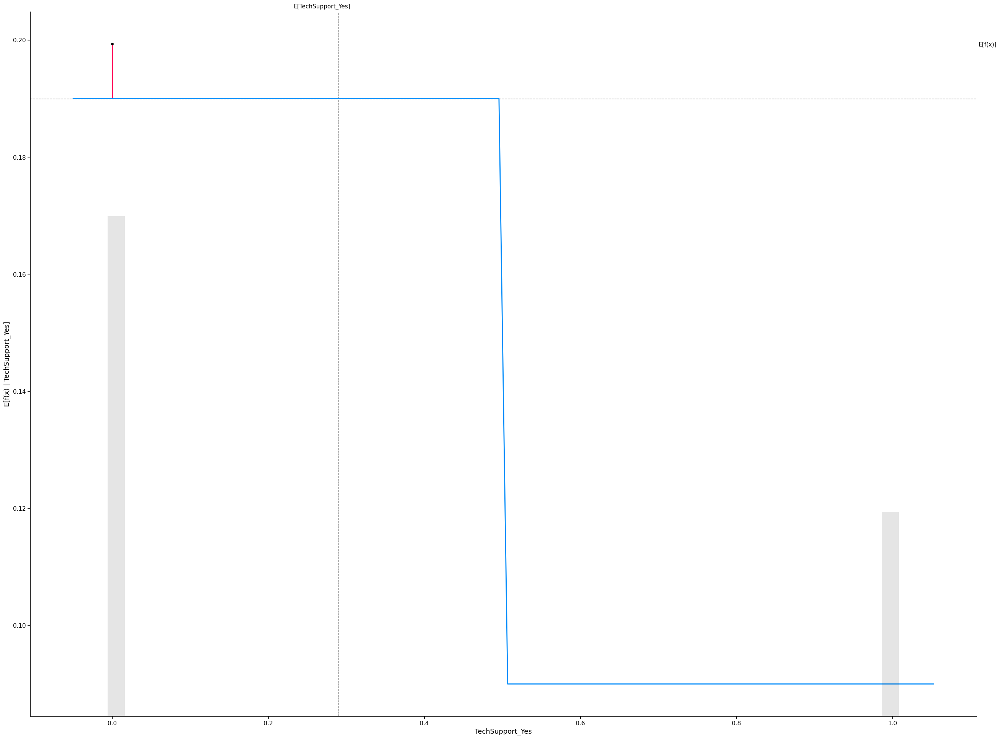

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

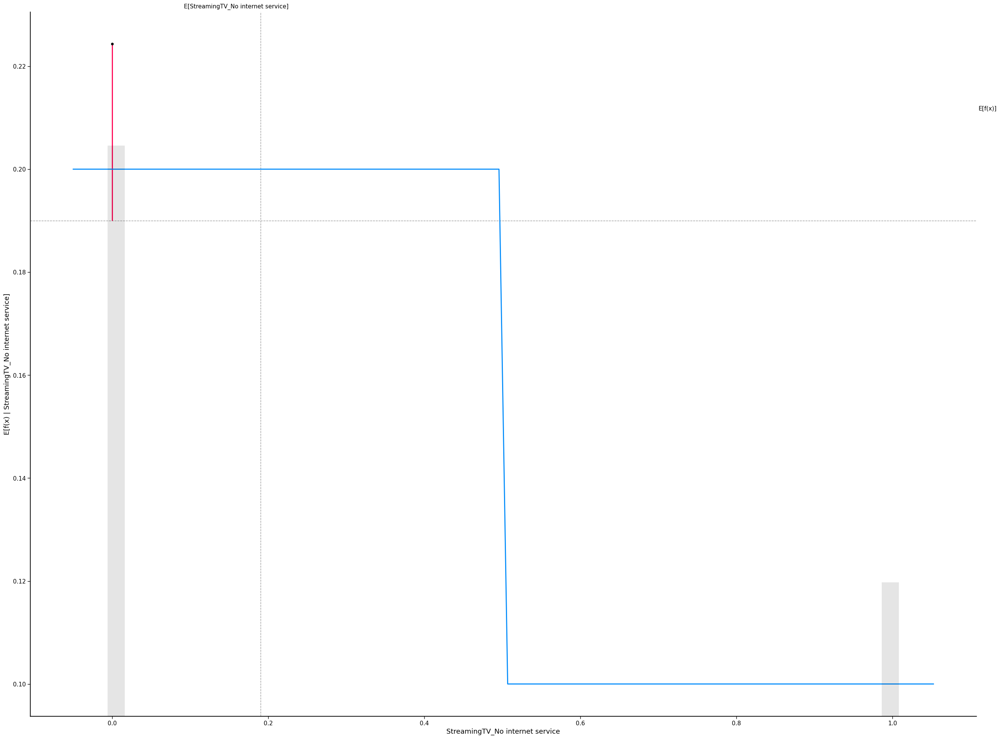

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

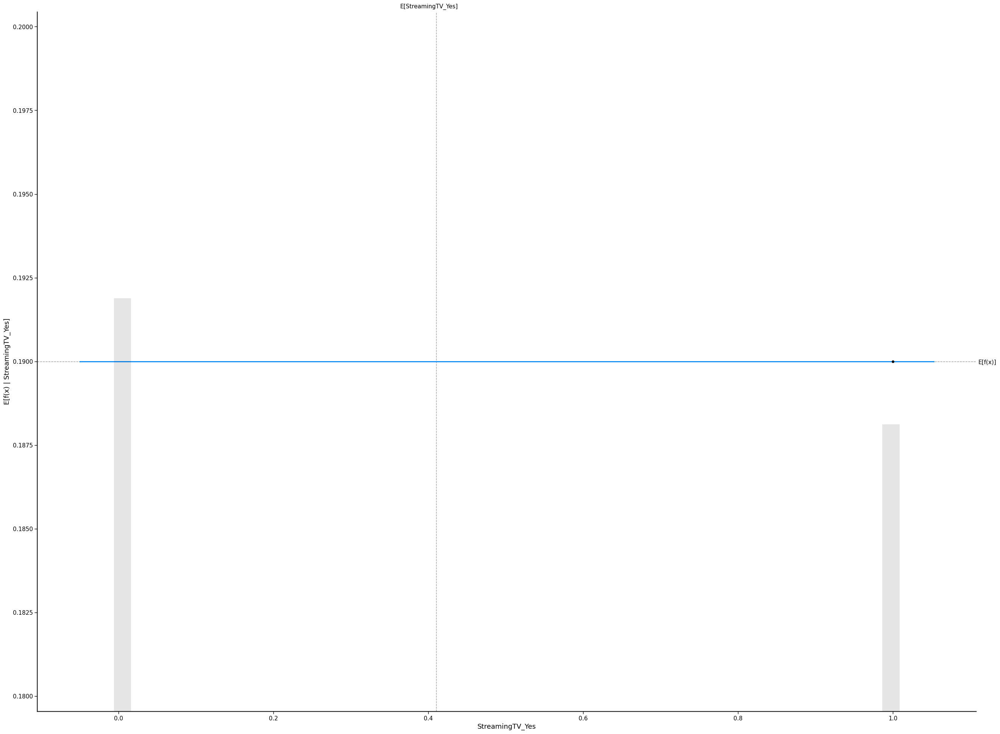

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

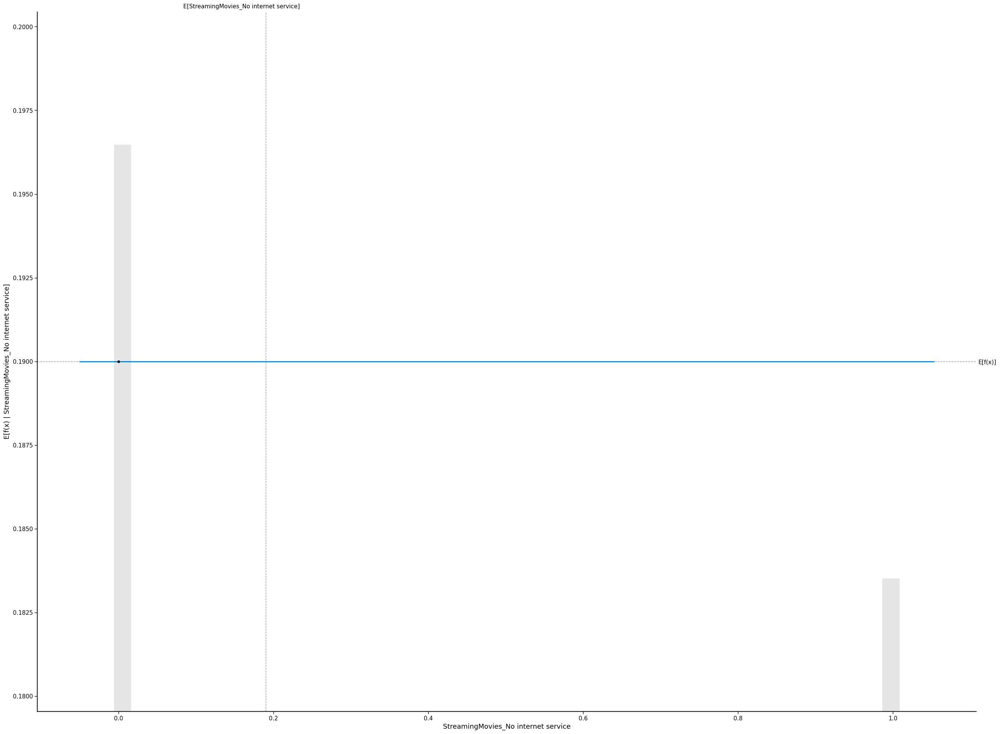

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

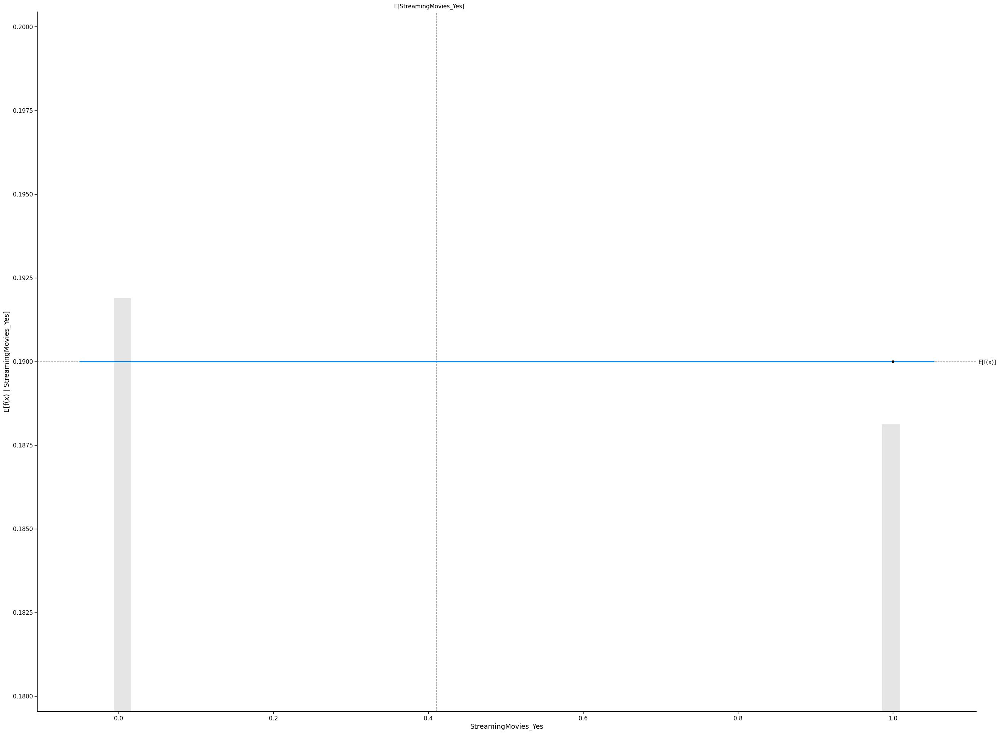

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

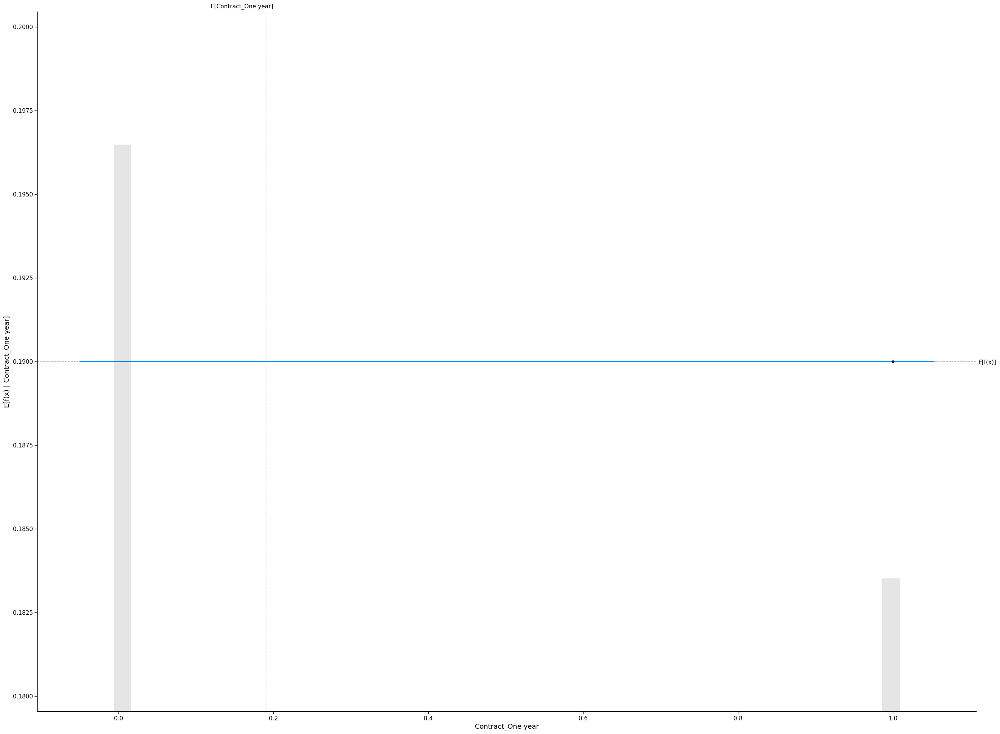

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

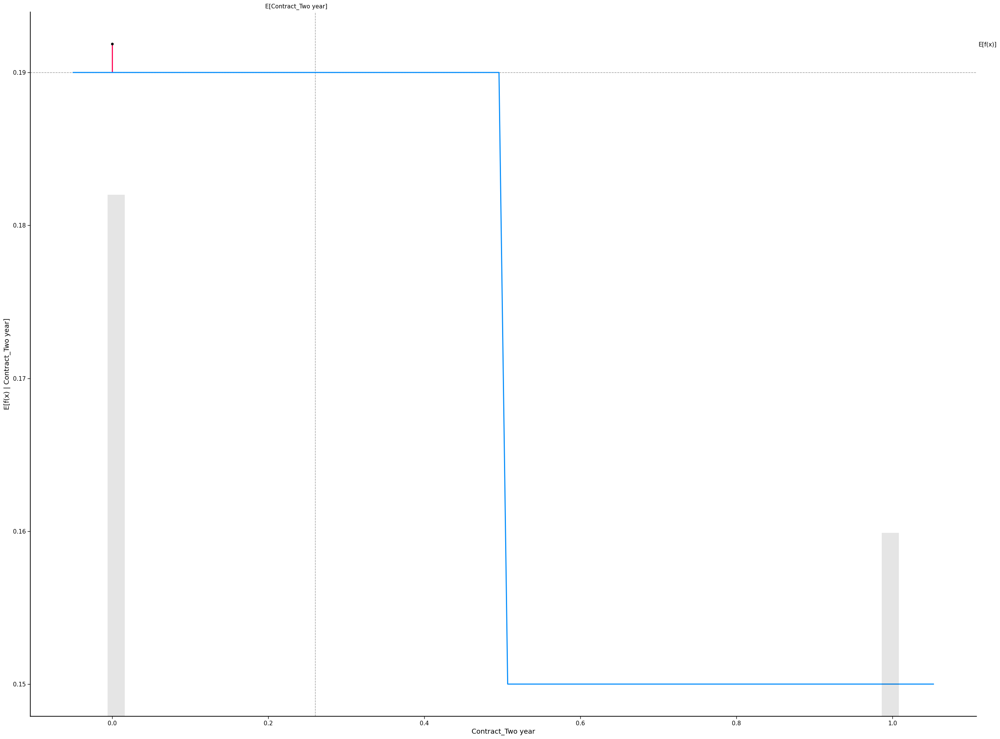

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

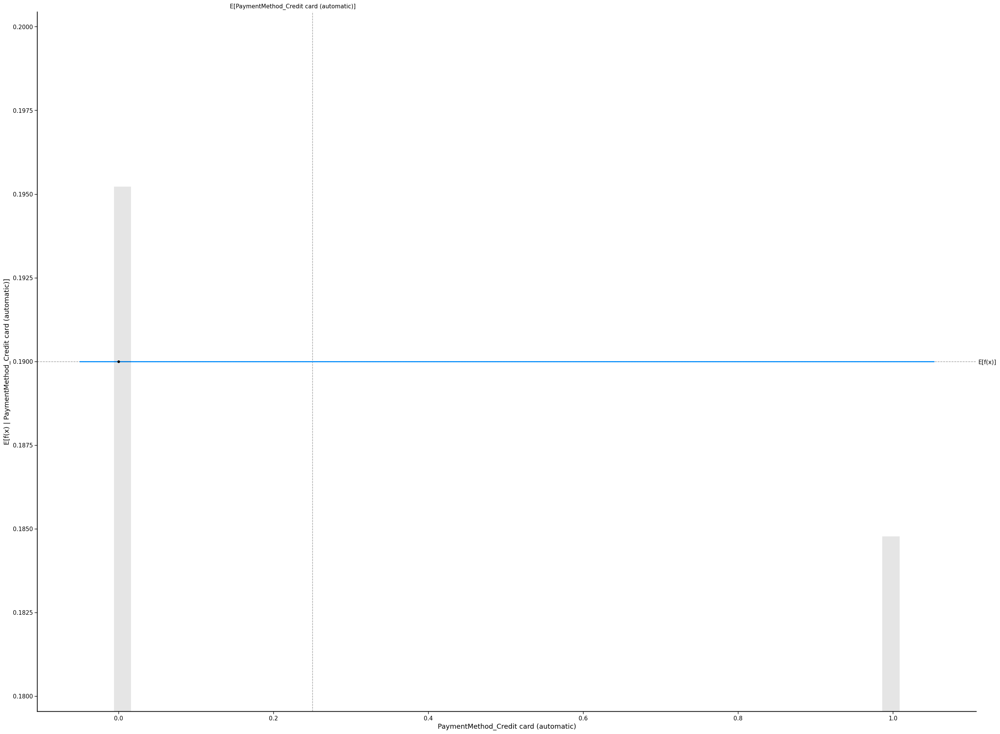

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

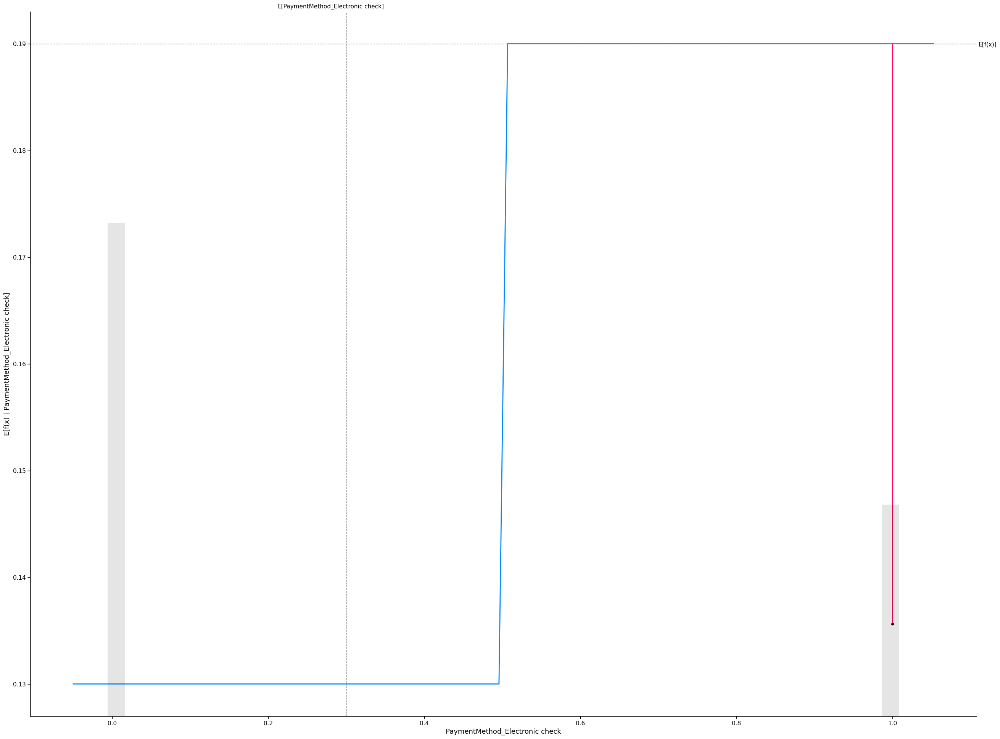

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: UserWarning:

X has feature names, but DecisionTreeClassifier was fitted without feature names

/usr/local/lib/python3.9/dist-packages/sklearn/base.py:432: User

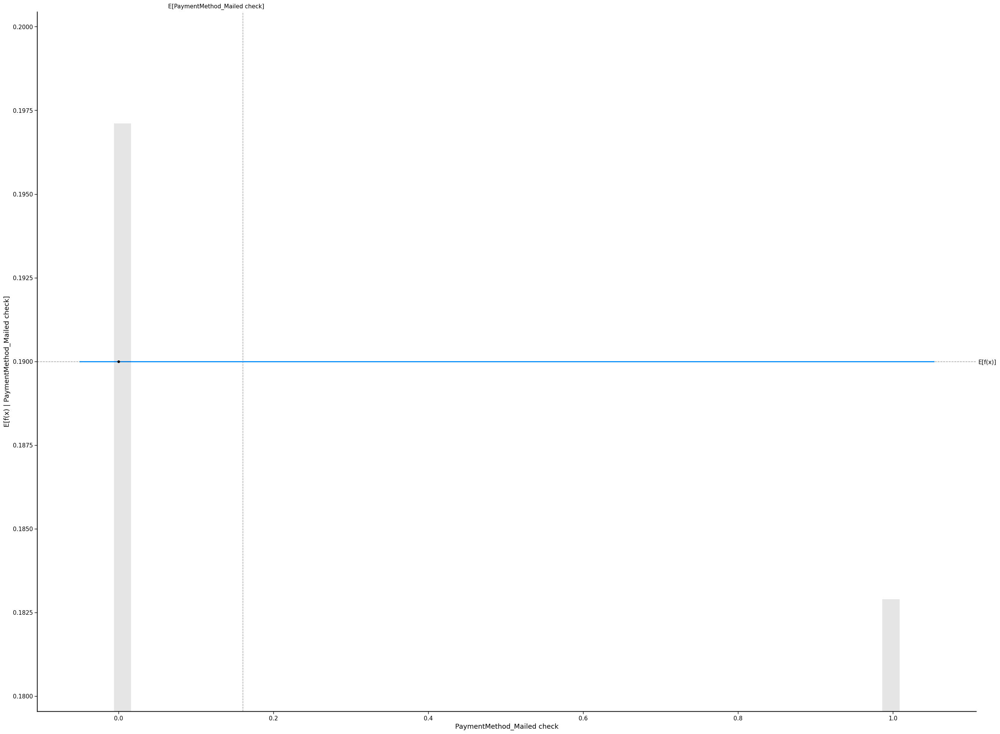

In [130]:
# SHAP explanation of a tree based model
tree_explainer = shap.Explainer(tree_model.predict, x_train_100)
tree_shap_values = tree_explainer(X_train)
for i in X_train.columns:
    # make a standard partial dependence plot
    sample_ind = 18
    shap.partial_dependence_plot(
        i,
        tree_model.predict,
        x_train_100,
        model_expected_value=True,
        feature_expected_value=True,
        ice=False,
        shap_values=tree_shap_values[sample_ind : sample_ind + 1, :],
    )

# **Interpreting SHAP Feature Importance Plot for Linear and Tree-based model**

SHAP feature importance- Features with large absolute Shapley values are important. 

The following plots are:-
1. SHAP feature importance for a linear model
2. SHAP feature importance for tree-based model

For the linear model, InternetService_Fiber Optic is the second most important feature but for tree-based model tenure is the second most important feature.

In [142]:
lr_explainer = shap.Explainer(lr_model.predict, x_train_100)
lr_shap_values = lr_explainer(x_train_100)

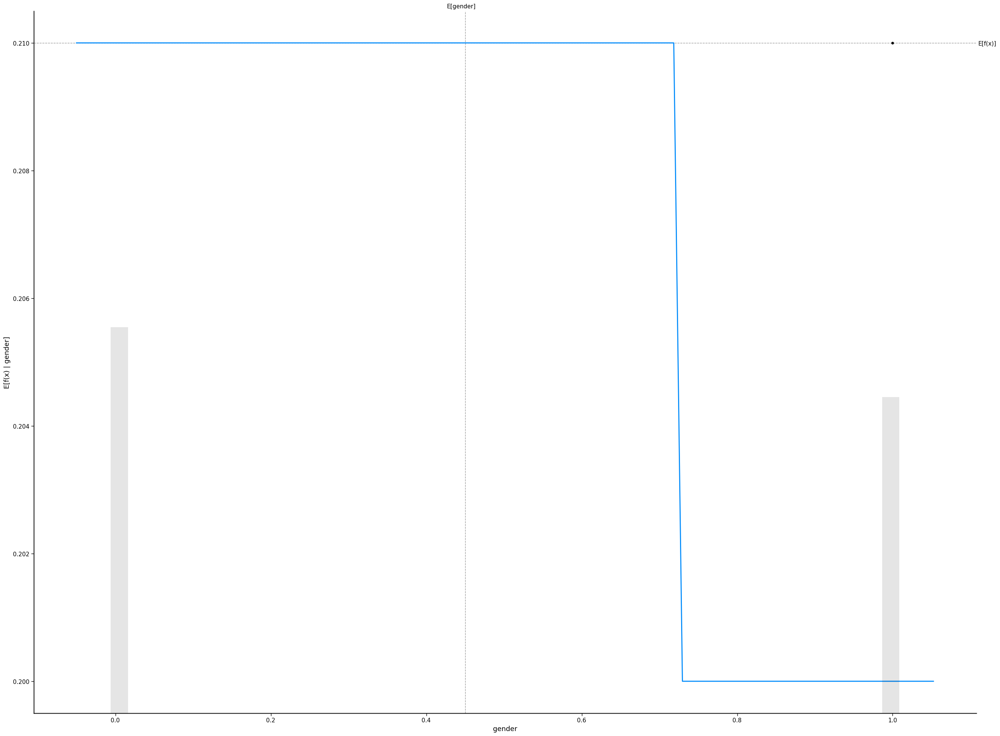

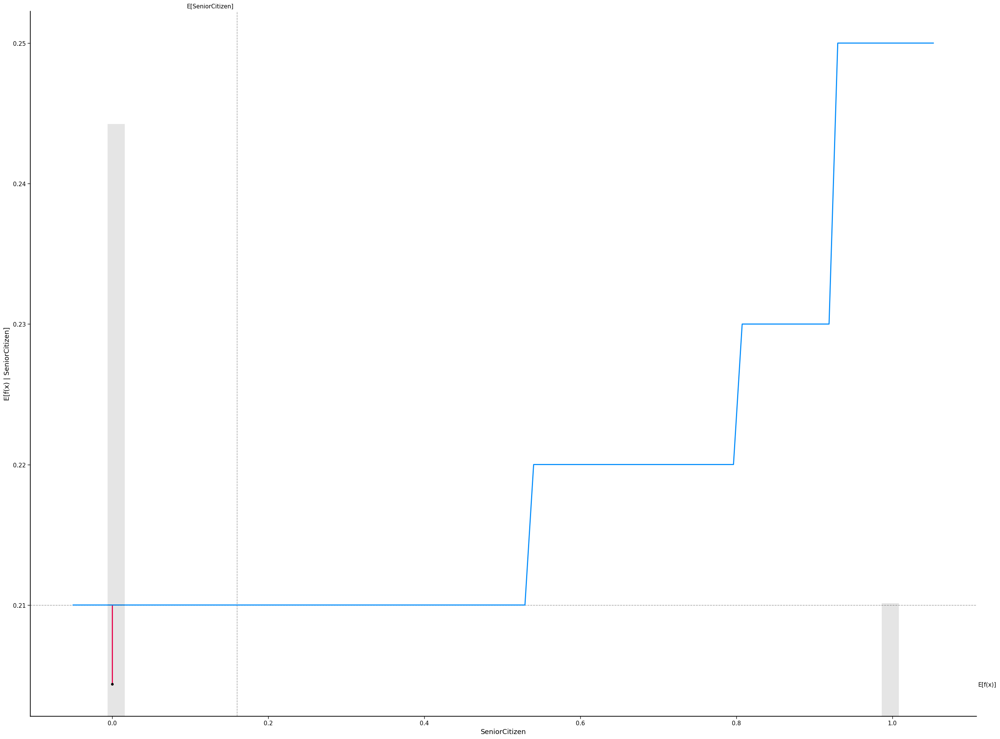

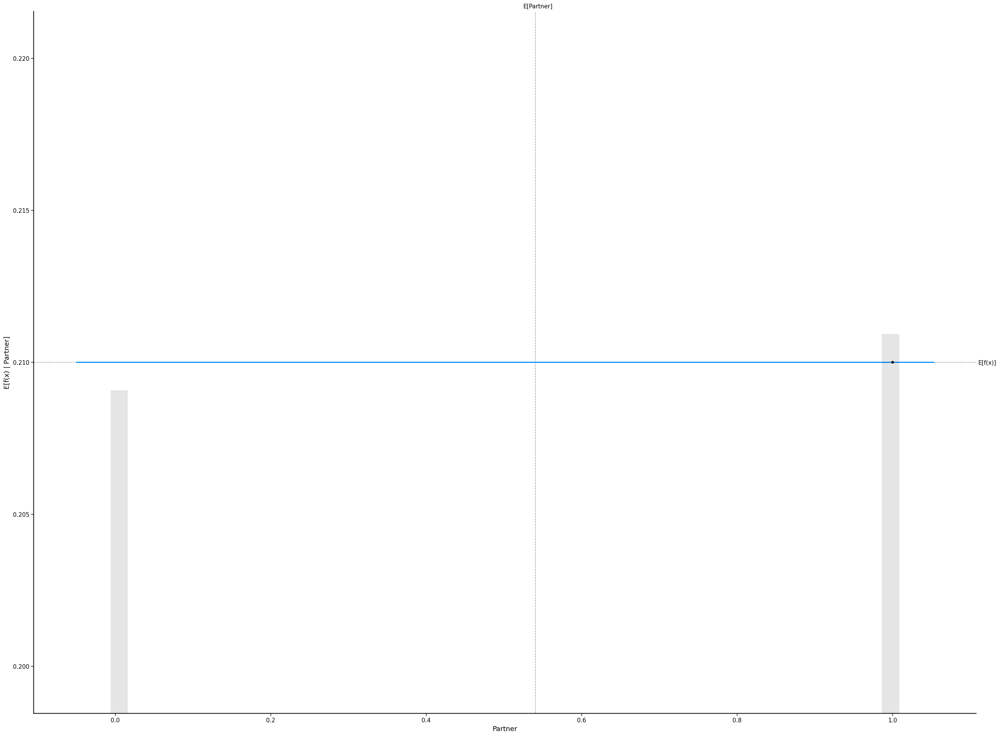

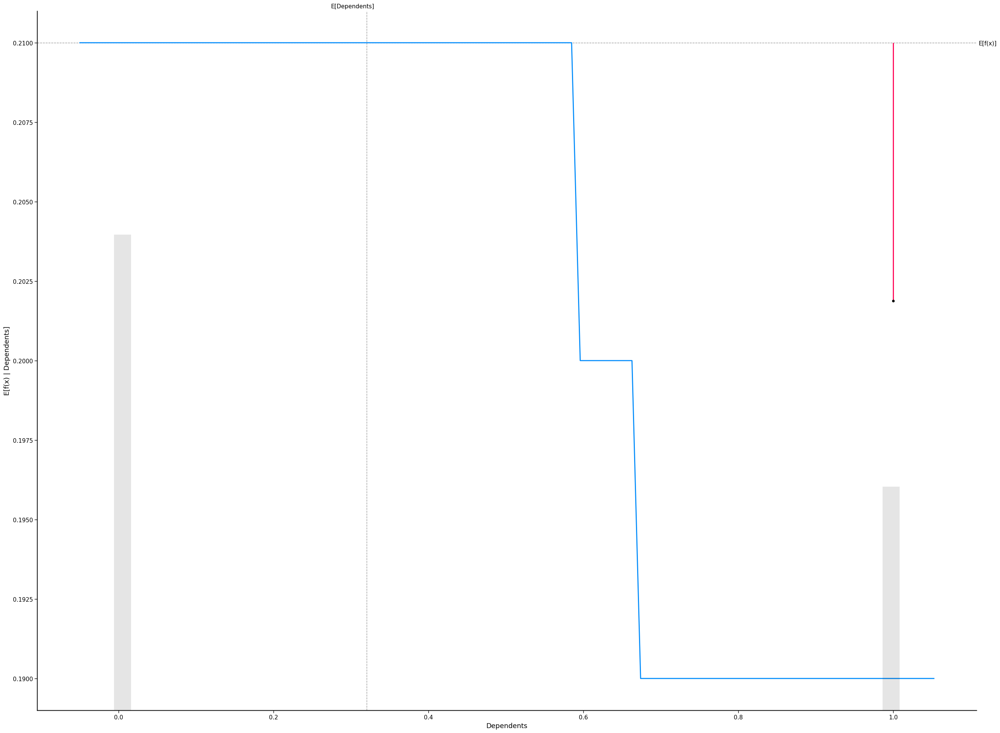

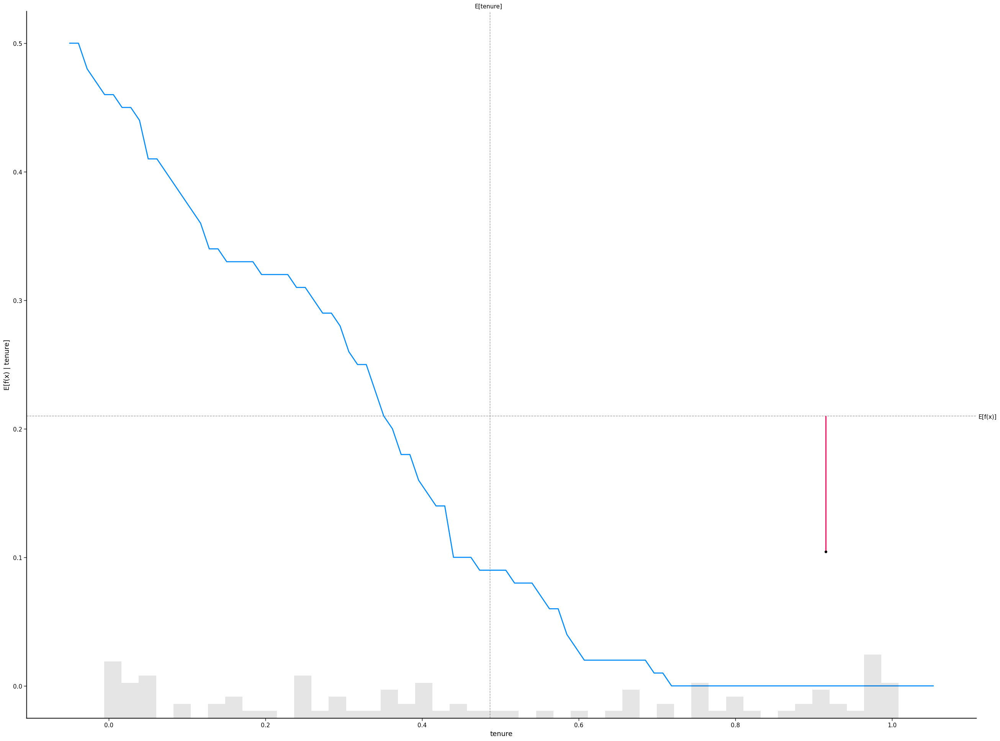

...

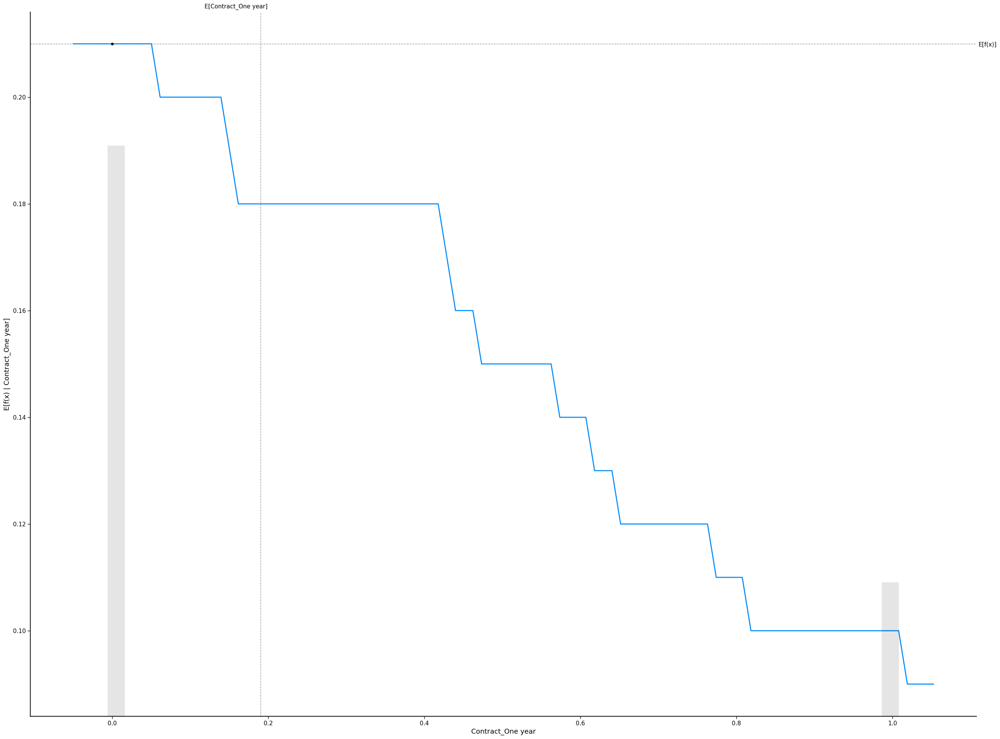

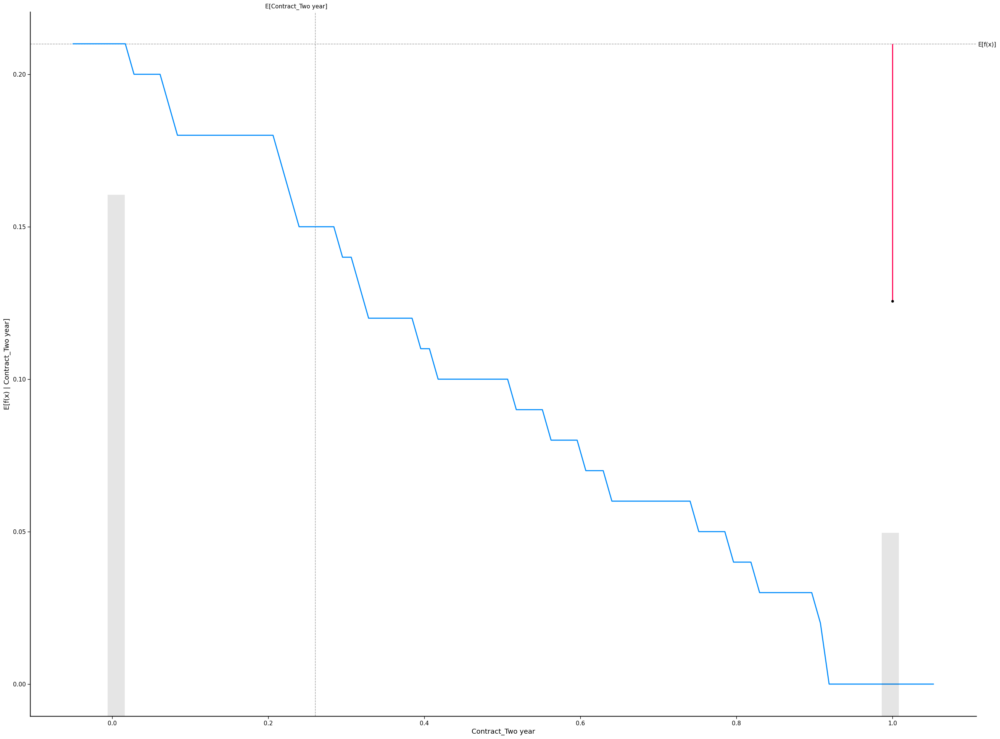

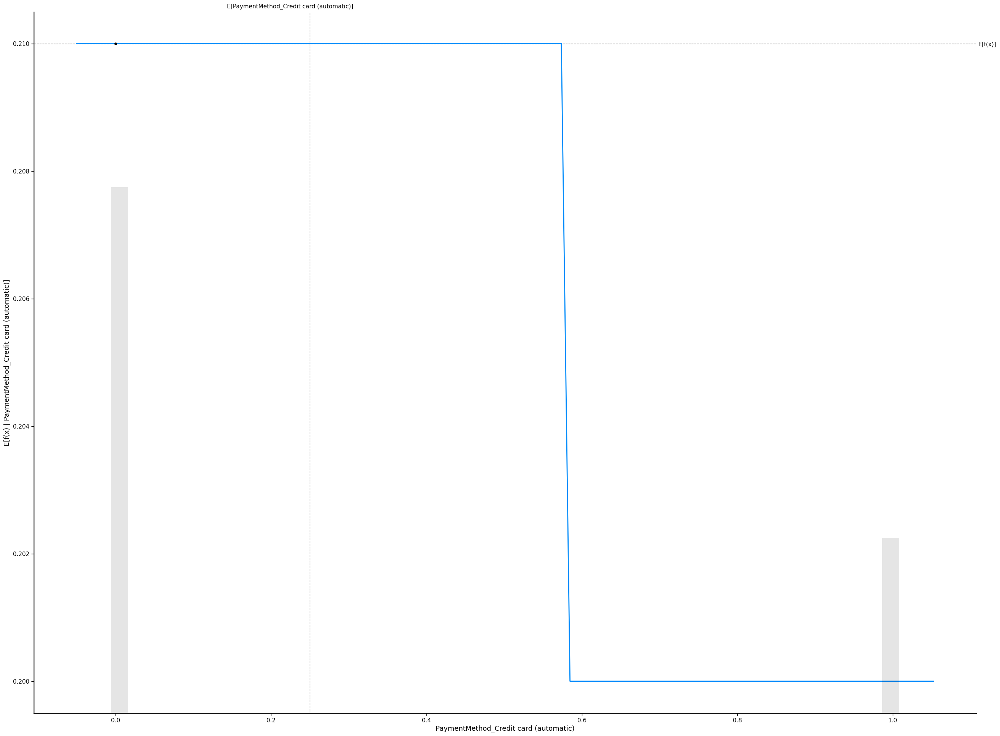

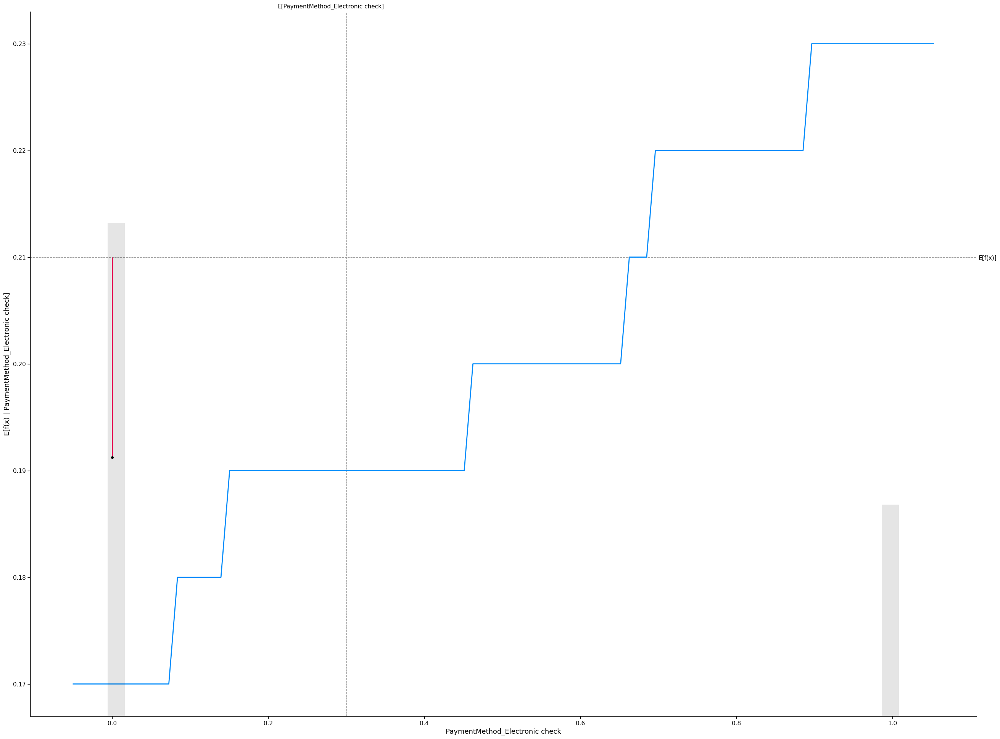

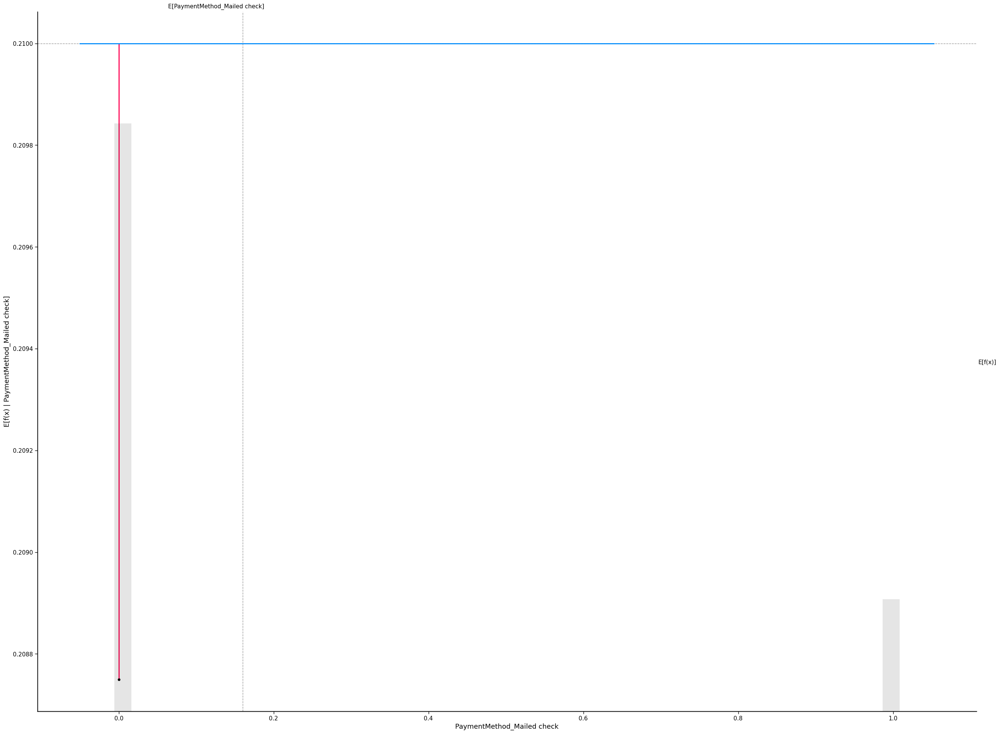

In [143]:
for i in x_train_100.columns:
    # make a standard partial dependence plot
    sample_ind = 18
    shap.partial_dependence_plot(
        i,
        lr_model.predict,
        x_train_100,
        model_expected_value=True,
        feature_expected_value=True,
        ice=False,
        shap_values=lr_shap_values[sample_ind : sample_ind + 1, :],
    )

# Interpret the summary plot Logistic Regression Model

Here the features are listed in descending order of their importance. This is one of the easiest ways to analyze an ML model and how the features are affecting the target and to what extent.

Each dot(both red and blue) represents a feature of a churn
Red color represents high values whereas blue color represents low value
If a dot(a feature of churn) is on the right side of the y-axis then it had a positive impact and if it is on the left side of the axis it had a negative impact
The position of a dot(a feature of churn) on the x-axis represents the intensity of impact it had, the more it is away from the axis greater the intensity.
Let us try to understand how the features are affecting the model.

Higher value of MonthlyCharges tends to have a negative impact,
Lower values of MonthlyCharges tends to have a positive impact on the churn and so on.
We could also interpret the intensity of impact

This visualization is very useful when it comes to interpreting how our model is working.

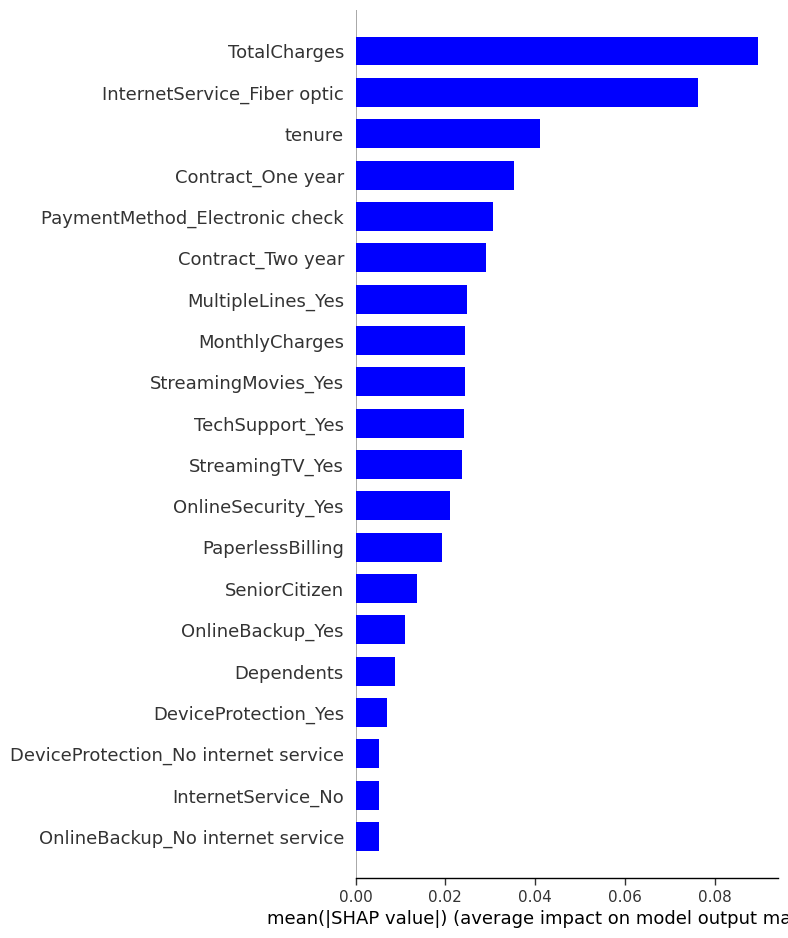

In [131]:
# SHAP variable importance for a Linear Model
shap.summary_plot(linear_shap_values, X_train, plot_type="bar", color="blue")

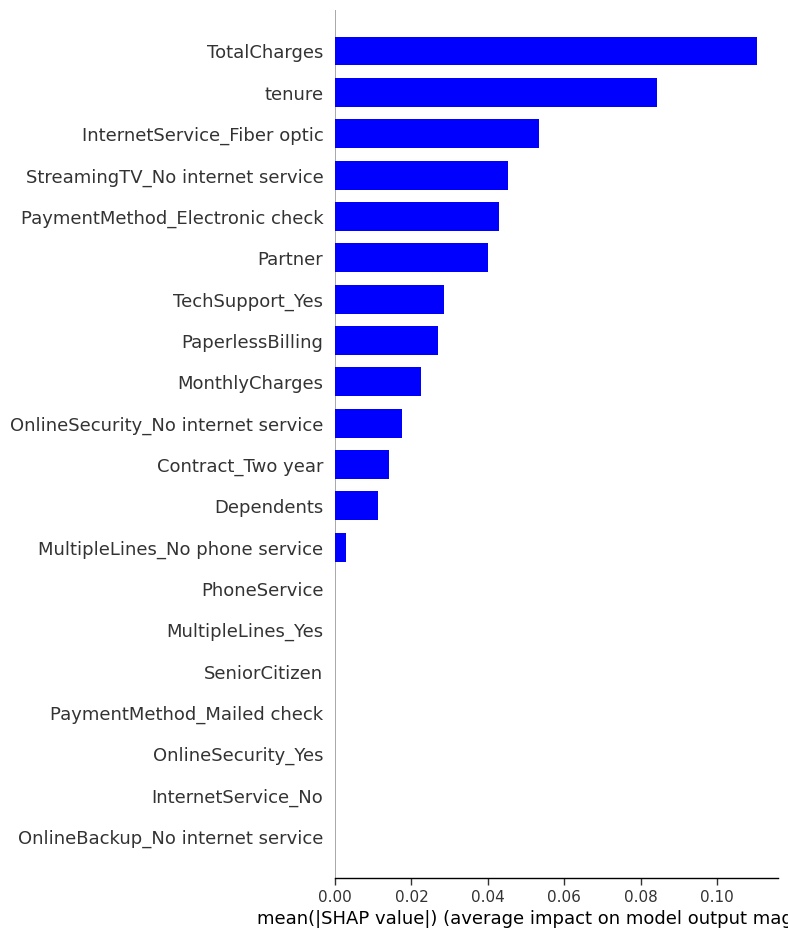

In [132]:
# SHAP variable importance for Tree based model
shap.summary_plot(tree_shap_values, X_train, plot_type="bar", color="blue")

# Interpret the summary plot for the Linear and Tree-based model
Here the features are listed in descending order of their importance. This helps ML model to analyze and how the features are affecting the target and to what extent.


* Each dot(both red and blue) represents a feature
* Red color represents high values whereas blue color represents low value
* If a dot is on the right side of the y-axis then it had a positive impact and if it is on the left side of the axis it had a negative impact
* The position of a dot on the x-axis represents the intensity of impact it had, the more it is away from the axis greater the intensity.


Higher value of TotalCharges tends to have a positive impact on the Churn.


/usr/local/lib/python3.9/dist-packages/shap/plots/_beeswarm.py:664: UserWarning:

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored



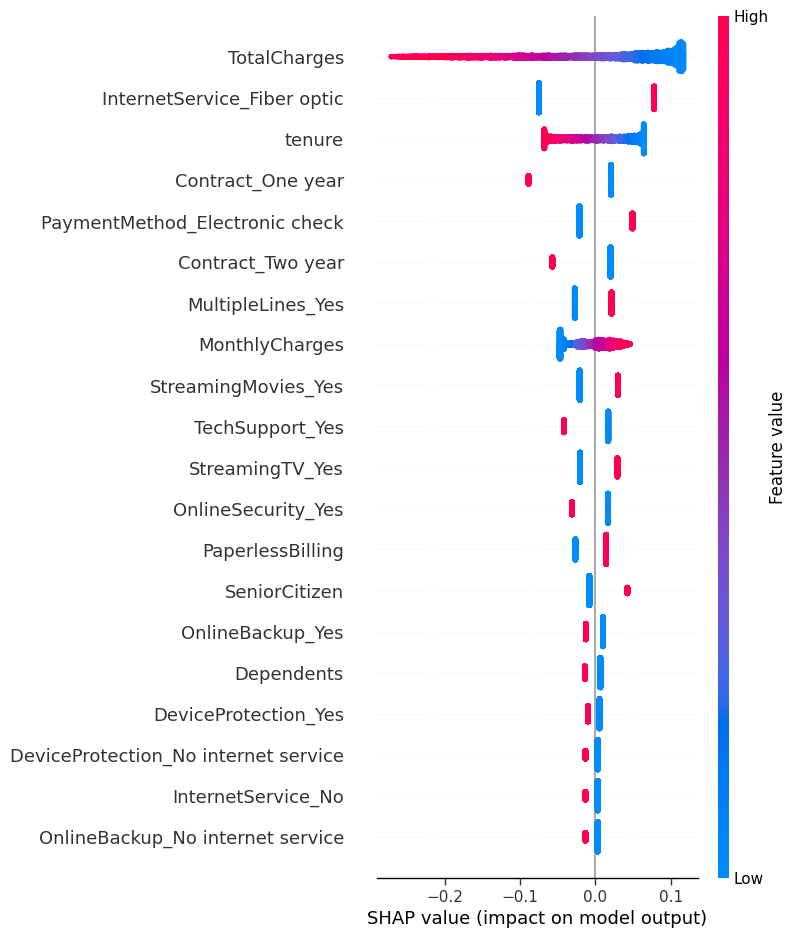

In [133]:
# SHAP summary for Linear Model
shap.summary_plot(linear_shap_values, X_train)

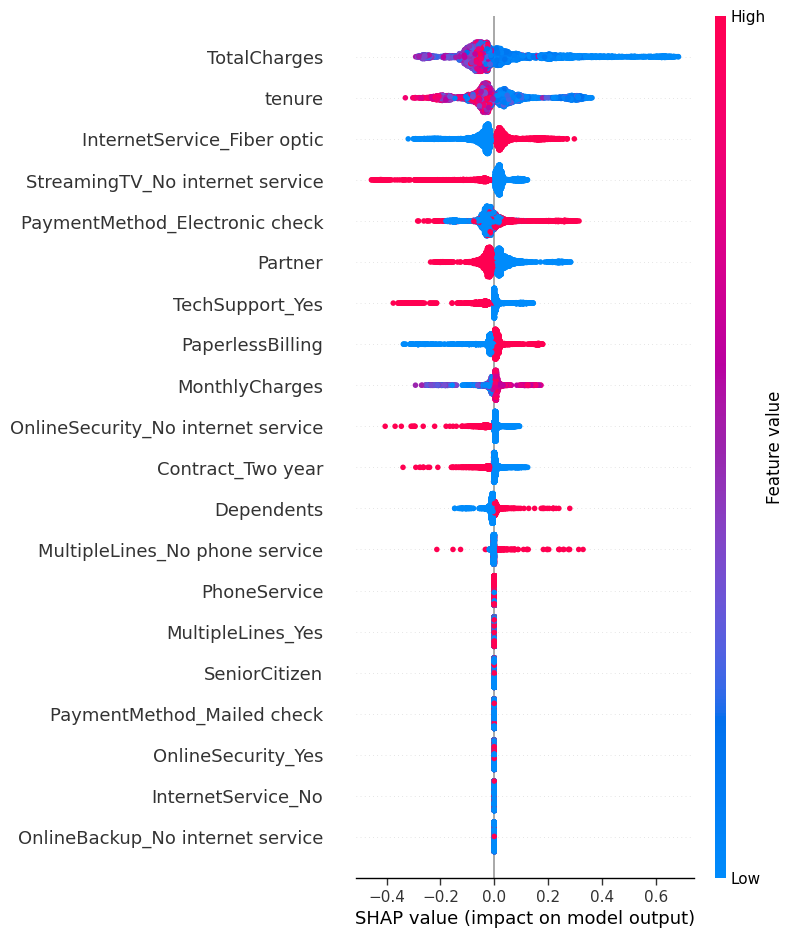

In [134]:
# SHAP summary for Tree Based Model
shap.summary_plot(tree_shap_values, X_train)

# Interpreting Waterfall SHAP visualization

Notice the value of TotalCharges in the waterfall model is the same as what we have in SHAP partial dependence plot. It says that f(x) = 0.363 is what we got as a model output and the expected output for this sample was 0.264. The graph shows that ToalCharges has the biggest and most negative impact in churn rate. Followed by Contract_OneYear had a negative impact and it bought the churn rate down.

Similarly we can interpret the tree-based model for the same sample.
Where the output we got was 0 and the expected output was 0.19. in the tree-based model, we just see that the magnitude of the impact made by individual features varies from what we had in a linear model. Here in the tree-based model, the output is majorly effected on tenure.

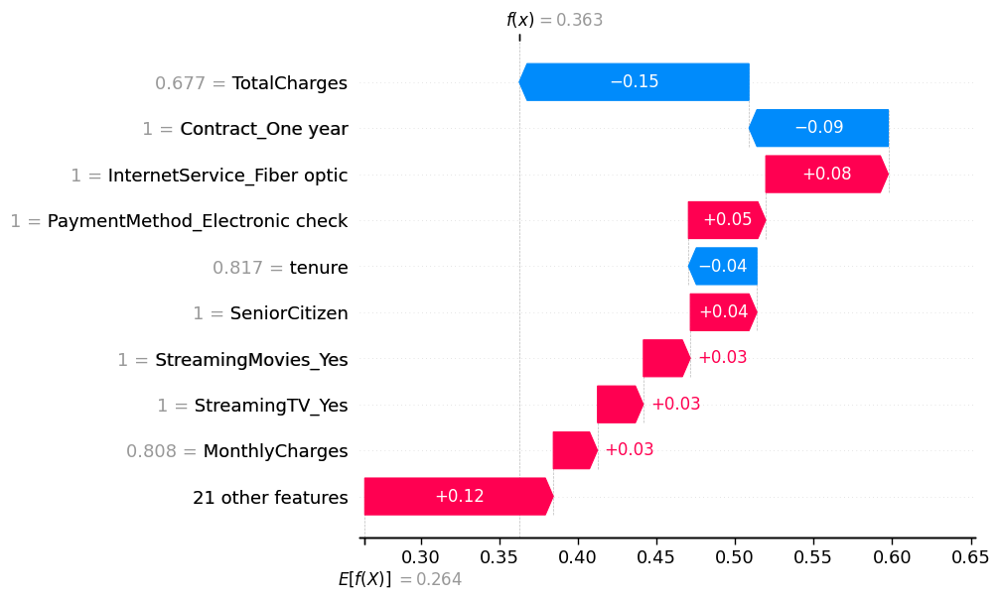

In [135]:
# Waterfall plot for linear model
shap.plots.waterfall(linear_shap_values[sample_ind], max_display=10)

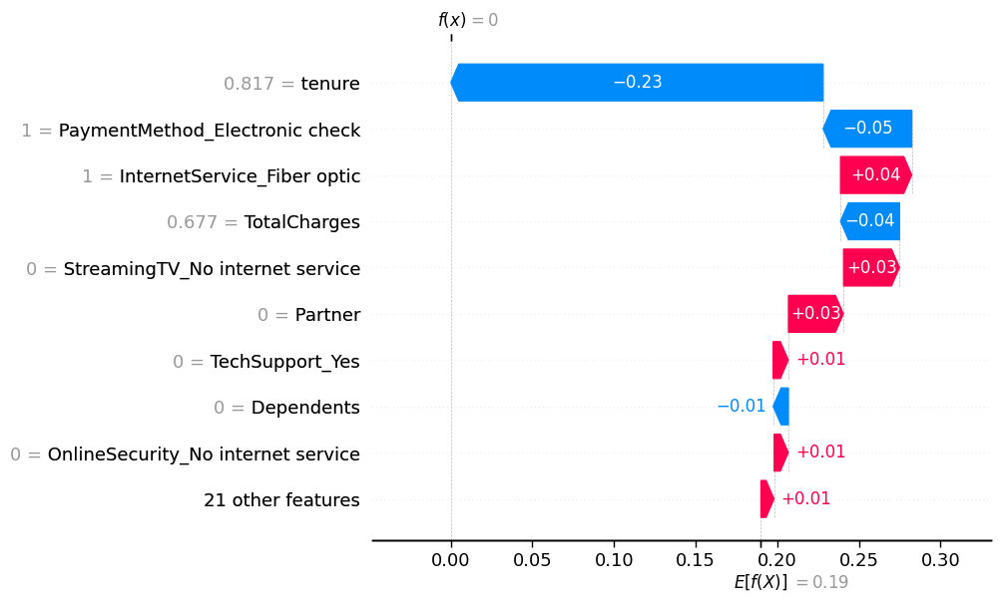

In [136]:
# Waterfall plot for Tree Based Model
shap.plots.waterfall(tree_shap_values[sample_ind], max_display=10)

## Interpreting SHAP dependence plot for Linear and Tree-based model
The SHAP dependence plot shows the marginal effect one or two features have on the predicted outcome of a machine learning model. It tells whether the relationship between the target and a feature is linear, monotonic, or more complex.

As we can observe the linear model feature and its SHAP value have a linear relationship. If a feature has a positive impact on the Churn rate then the relationship will be directly proportional to TotalCharges and MonthlyCharges vice versa.

For the tree-based model as observed the relationship between feature and its SHAP value is no longer linear. Now we see that the SHAP dependence plot no longer exactly matches the partial dependence plot because they are accounting for the interaction effects. 


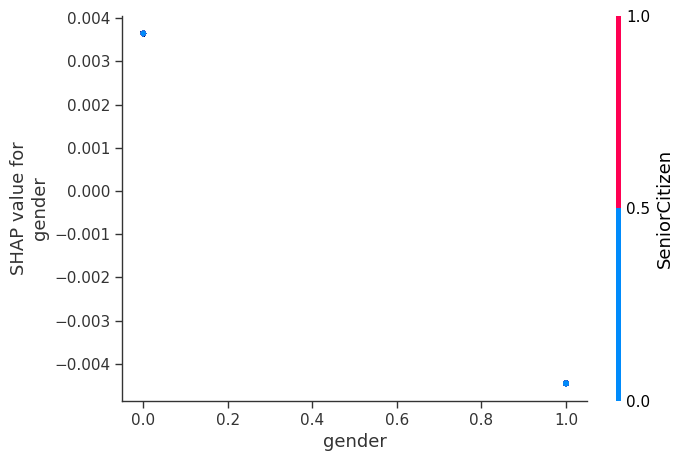

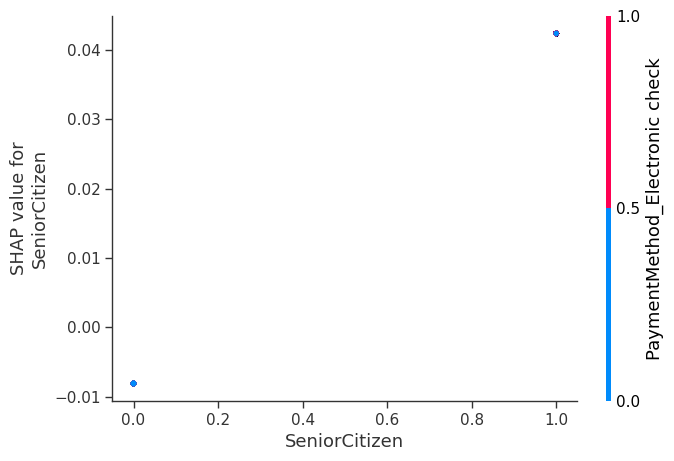

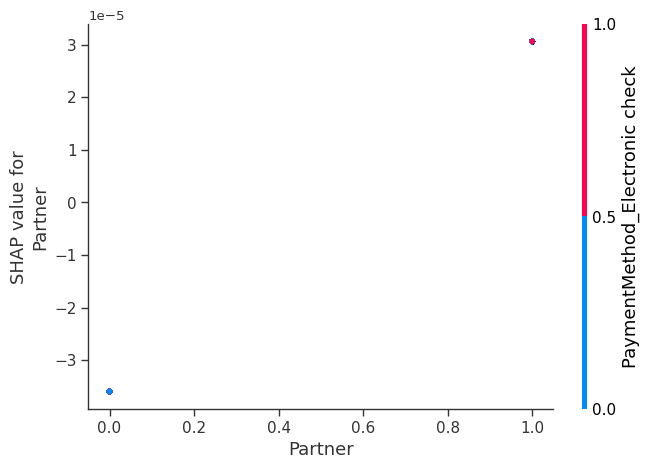

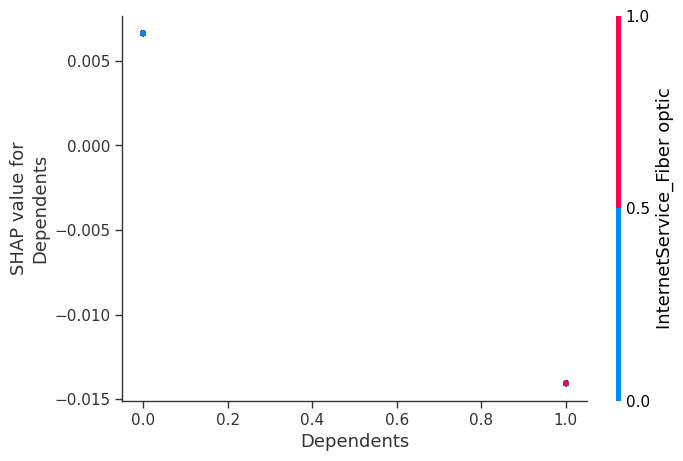

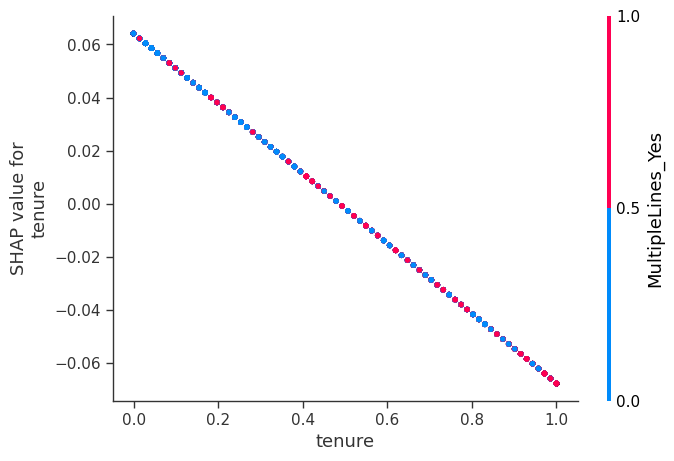

...

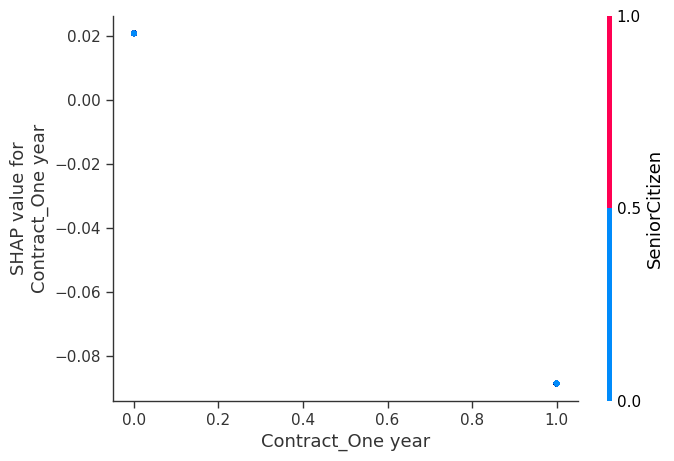

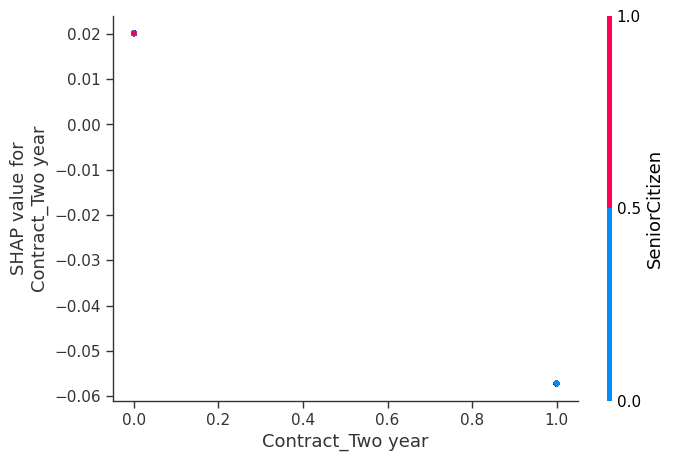

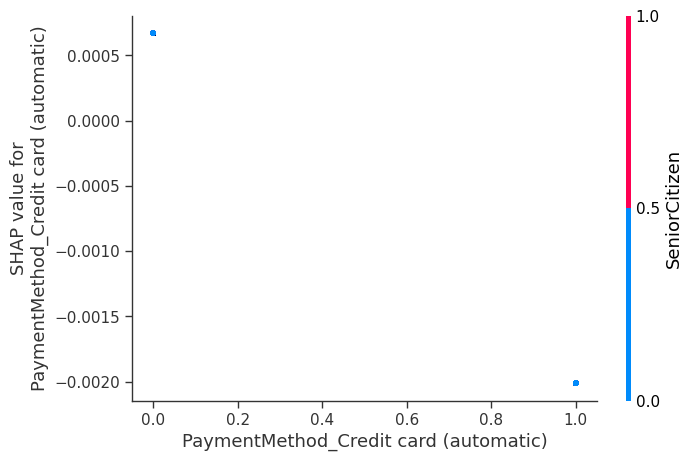

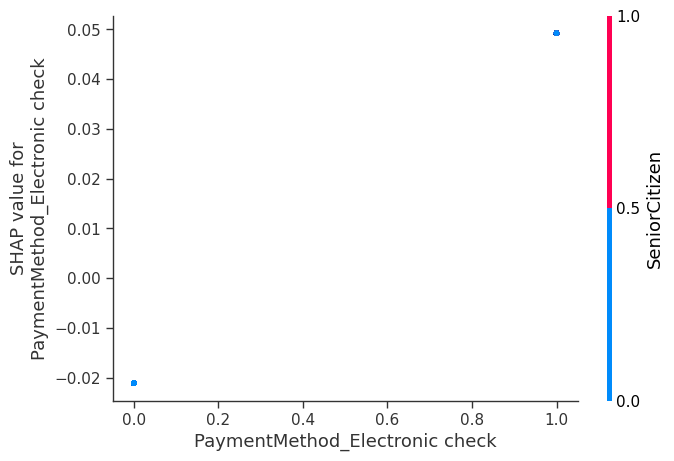

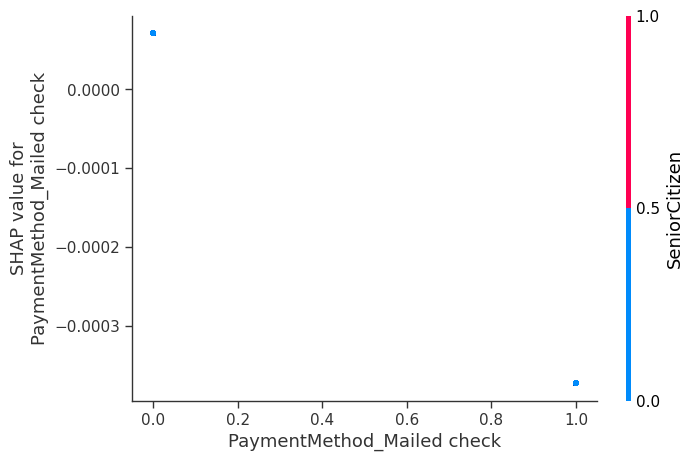

In [137]:
# SHAP partial dependence plot for linear model
for i in X_train.columns:
    shap.dependence_plot(i, linear_shap_values.values, X_train)

## The below plot displays the distribution of importance for each variable as a standard violin plot.

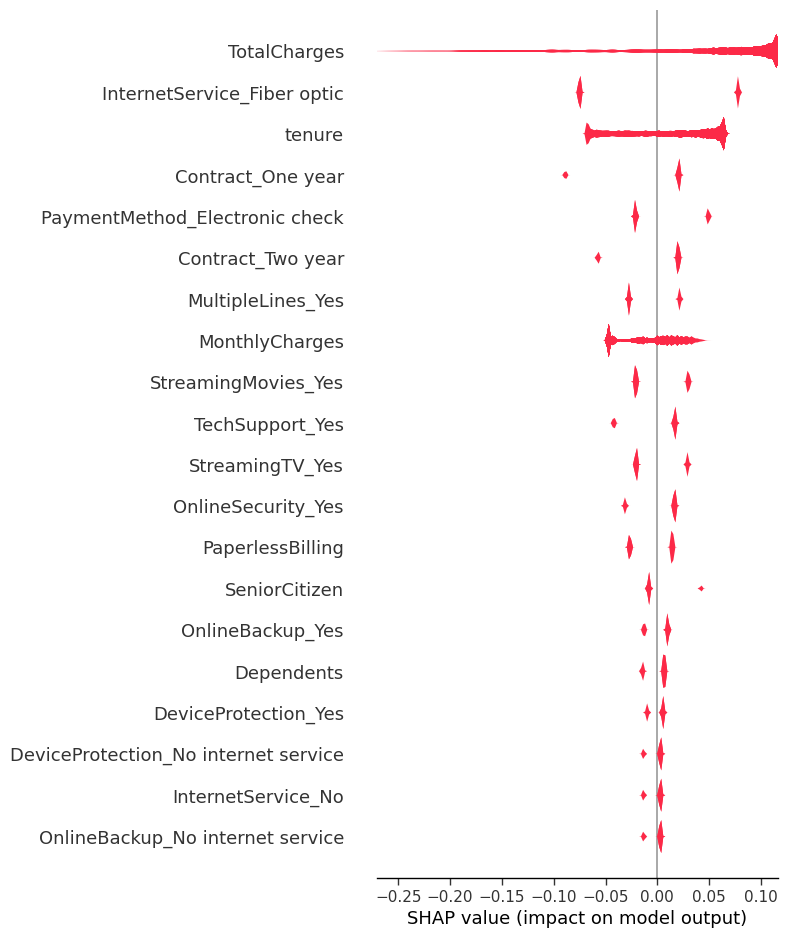

In [138]:
shap.summary_plot(linear_shap_values, plot_type="layered_violin", color='#FC2947')

/usr/local/lib/python3.9/dist-packages/shap/plots/_beeswarm.py:664: UserWarning:

No data for colormapping provided via 'c'. Parameters 'vmin', 'vmax' will be ignored



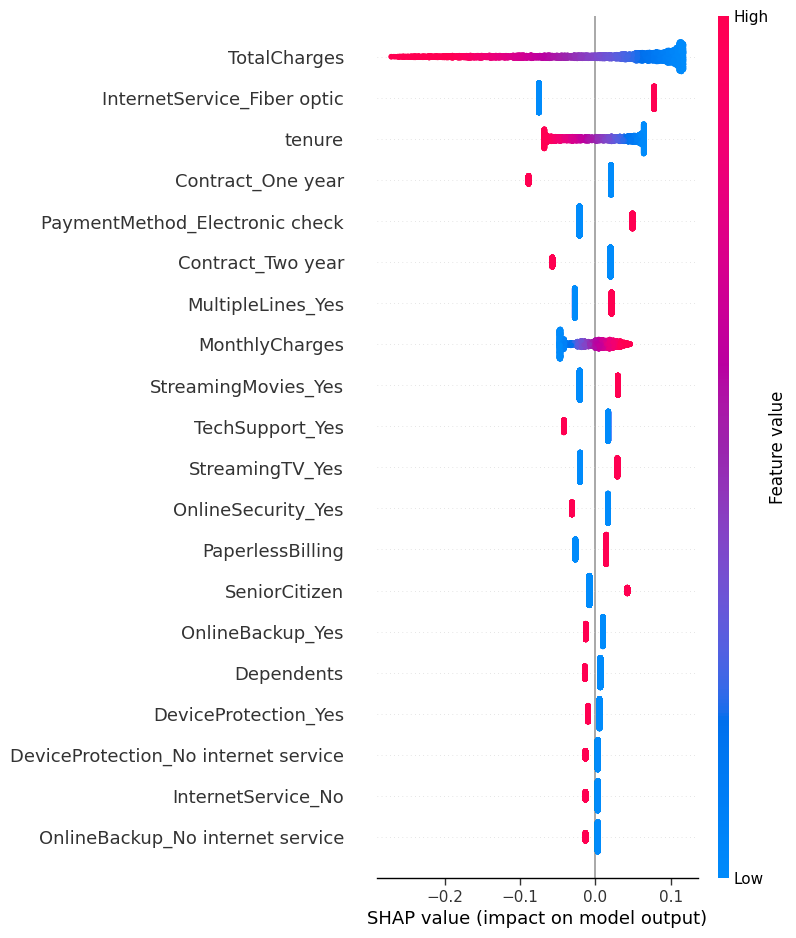

In [139]:
shap.summary_plot(shap_values = linear_shap_values,
                  features = X_train)

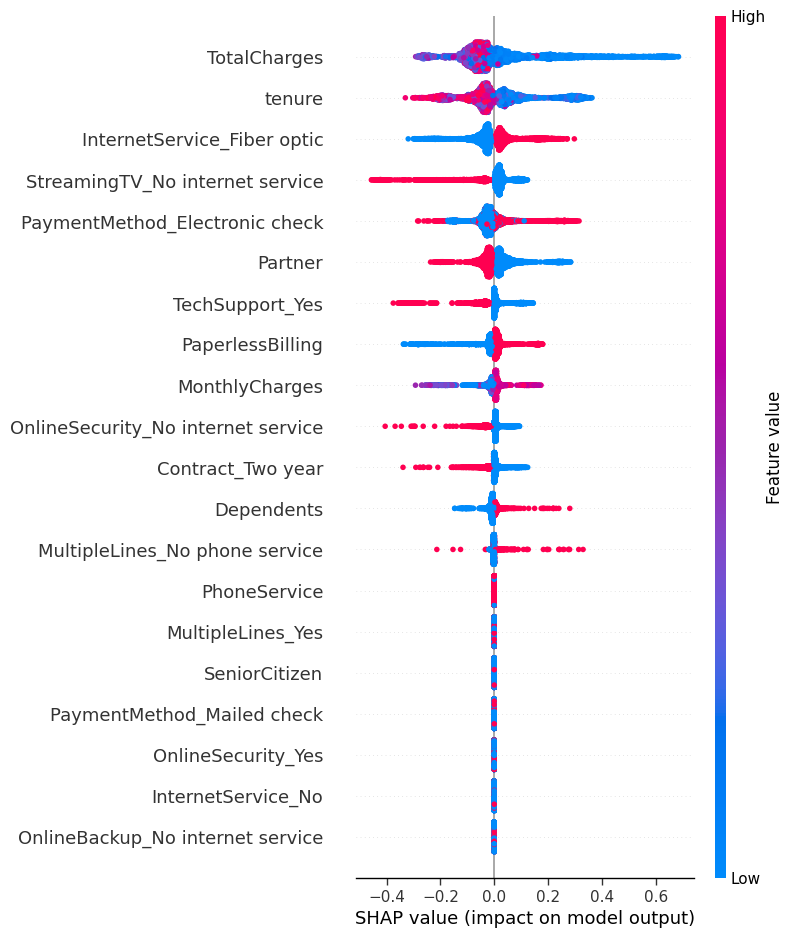

In [140]:
shap.summary_plot(shap_values = tree_shap_values,
                  features = X_train)

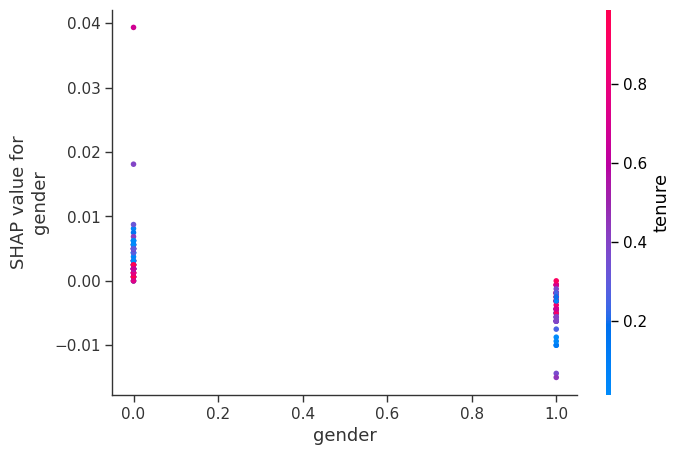

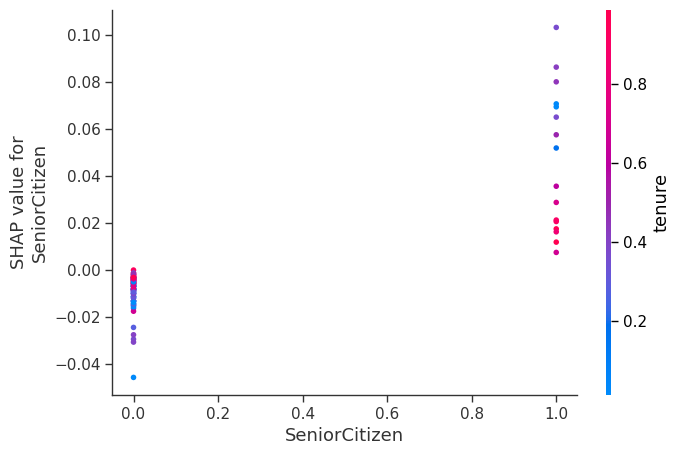

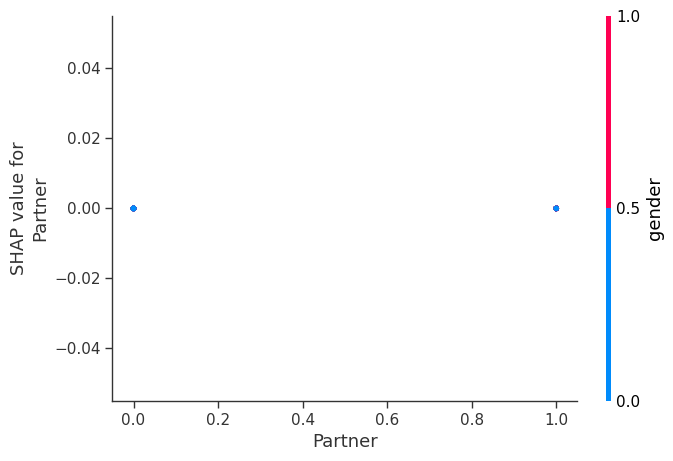

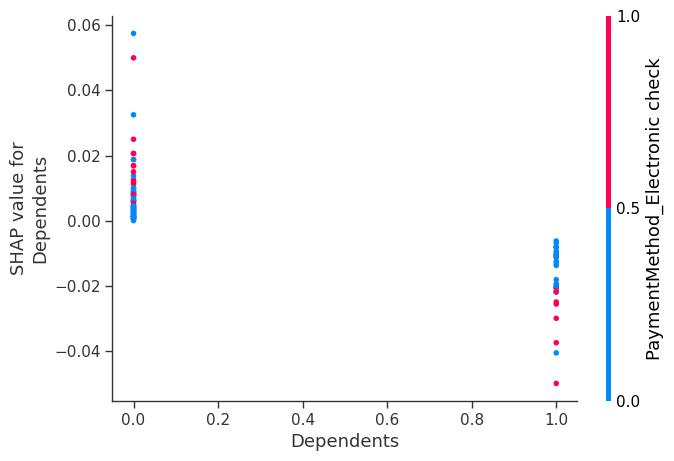

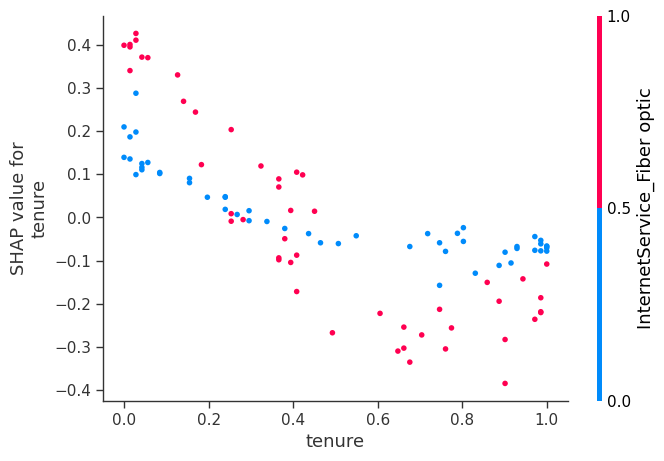

...

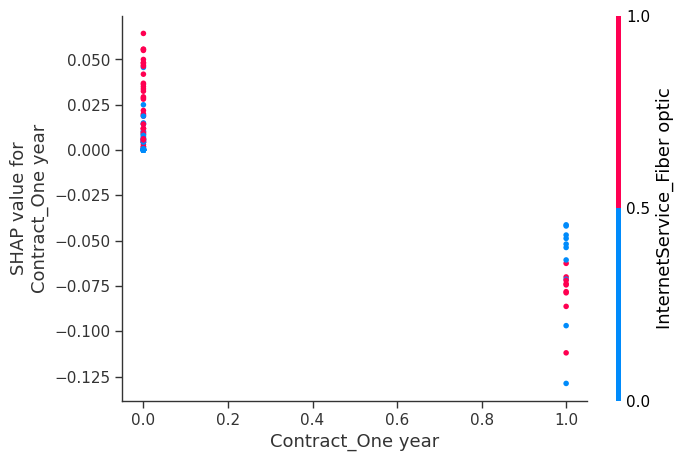

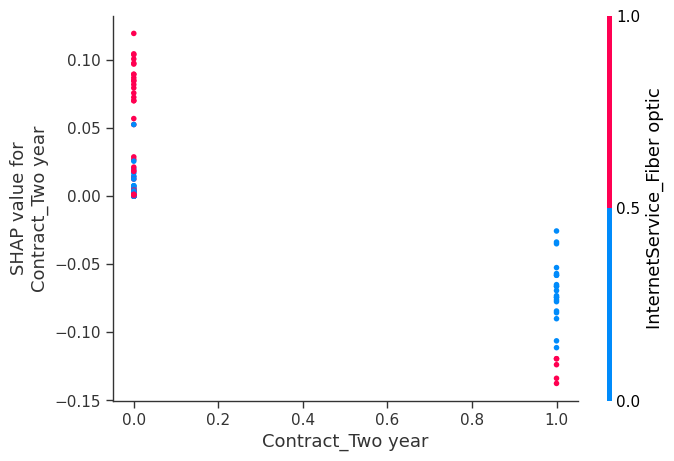

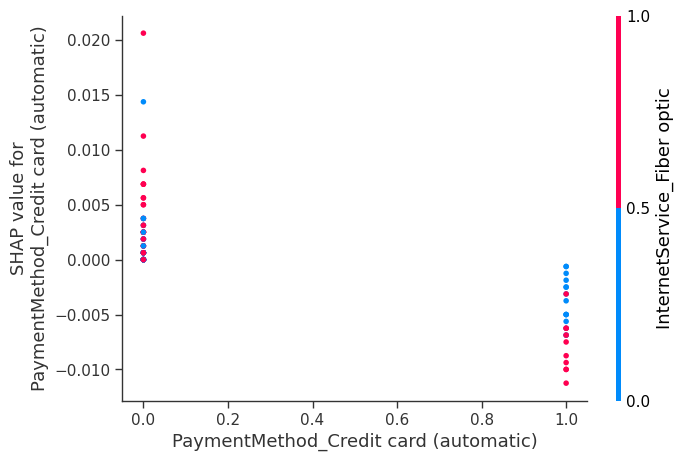

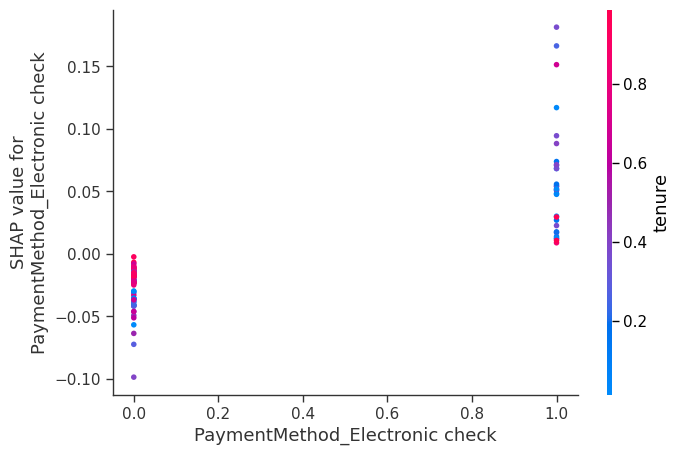

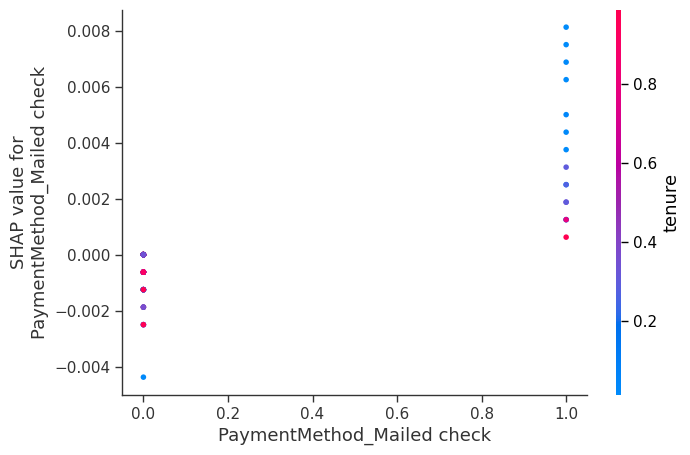

In [145]:
# SHAP partial dependence plot for a tree based model
for i in X_train.columns:
    shap.dependence_plot(i, lr_shap_values.values, x_train_100)

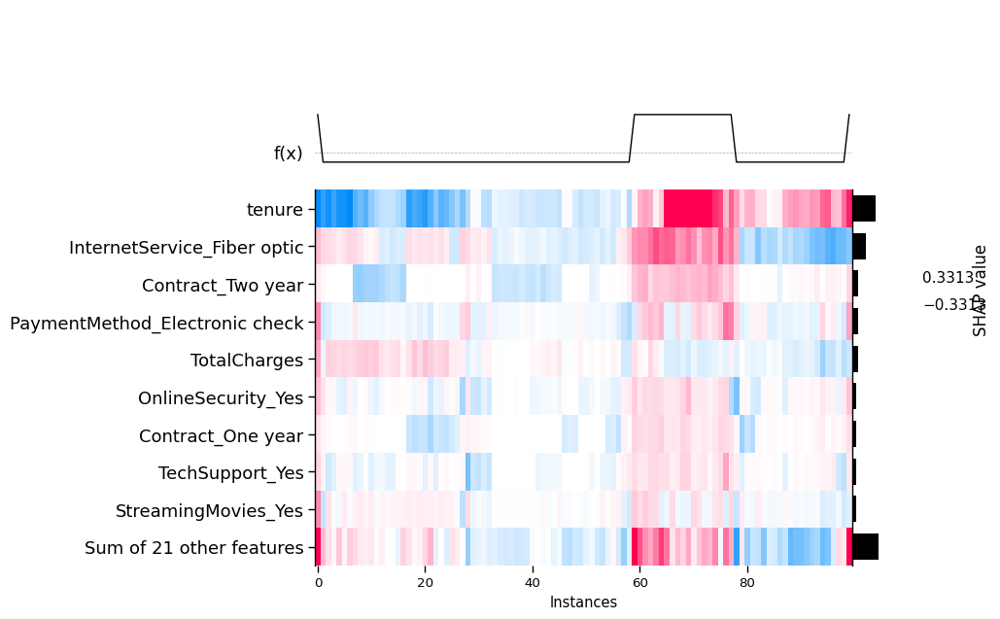

In [146]:
shap.plots.heatmap(lr_shap_values)  # SHAP HeatMap of a Tree Based Model

## 1. What are the data types? (Only numeric and categorical)
The Telco Customer Churn dataset contains both numeric and categorical data.
The numeric data types in the dataset include: tenure, MonthlyCharges and TotalCharges

The categorical data types in the dataset include: customerID, gender, SeniorCitizen, Partner, Dependents, PhoneService, MultipleLines, InternetService, OnlineSecurity, OnlineBackup, DeviceProtection, TechSupport, StreamingTV, StreamingMovies, Contract, PaperlessBilling, PaymentMethod, Churn.

-> 21 characteristics -> 20 independent variables and 1 dependent variable

i.e. customerID, gender, SeniorCitizen, Partner, Dependents, tenure, PhoneService, MultipleLines, InternetService, OnlineSecurity, OnlineBackup, DeviceProtection, TechSupport, StreamingTV, StreamingMovies, Contract, PaperlessBilling, PaymentMethod, MonthlyCharges, TotalCharges - independent variables

Churn - dependent variable

There are a total of 7043 observations.

## 2. Are there missing values?
There are 11 missing values in the 'TotalCharges' column, which are all empty cells, and the datatype for the 'TotalCharges' column is incorrect; it was object datatype (char format) and converted to float datatype.

# 3. What are the likely distributions of the numeric variables?

* Looking at the Q-Q plot above, it appears that all independent variables are not following normal distribution, they are not skewed normally, we will verify whether the data is left or right skewed in the following distributions.
There are few outliers in the predictor variables.
Tenure column was not skewed normally
* Monthly Charges column was right skewed
* Total Charges column was right skewed

## 4. Which independent variables are useful to predict a target (dependent variable)?

* Above are the top predictor variables are useful to predict a dependent variable.

## 5. Which independent variables have missing data? How much?

* TotalCharges variable contains 11 empty cells; we must either impute the values in the empty cells or delete the rows so that models do not produce ambiguous predictions.
* I chose to impute the data rather than delete the rows in this case, and I used the descriptive statistics method to do so.
* Because the data was continuous, I chose to impute it using the mean method in descriptive statistics.

# 6. Do the training and test sets have the same data?

* No, the training and test sets for the Telco Customer Churn dataset should not have the same data. They should be different and independent of each other. The training set is used to train the model, while the test set is used to evaluate the performance of the model.

* For the Telco Customer Churn dataset, you can split the data into training and test sets, for example, 70-80% of the data for training and 30-20% for testing. Then use the training set to train the model, and use the test set to evaluate the performance of the model. The test set should be a representative sample of the population, and should be independent of the training set.

## 7. In the predictor variables independent of all the other predictor variables?

* They are not distinct from one another. The correlation table shows that there is a co-relationship between many of the independent variables.

# 8. Which predictor variables are the most important?

* MonthlyCharges
* PaperlessBilling
* SeniorCitizen
* PhoneService
* gender
* Partner
* Dependents
* TotalCharges
* tenure

# 9. Do the ranges of the predictor variables make sense?

* Total 21 attributes -> 20 independent variables and 1 dependent variable
* customerID, gender, SeniorCitizen, Partner, Dependents, PhoneService, MultipleLines, InternetService, OnlineSecurity, OnlineBackup, DeviceProtection, TechSupport, StreamingTV, StreamingMovies, Contract, PaperlessBilling, PaymentMethod and Churn is a classification data
* MonthlyCharges, TotalCharges, tenure attributes are numeric data

# 10. What are the distributions of the predictor variables

* Numeric data variables are right skewed and having mesokurtic distribution
Does not have any outliers before and after data pre-processing of the dataset.

# 11. Remove outliers and keep outliers (does if have an effect of the final predictive model)

* Removing outliers will helps the model to predict better, here there are 3 numberic attributes in which they does not have any outliers.

# 12. Remove 1%, 5%, and 10% of your data randomly and impute the values back using at least 3 imputation methods. How well did the methods recover the missing values? That is remove some data, check the % error on residuals for numeric data and check for bias and variance of the error.

* Randomly removed percentage of values and imputed the missing values with few imputation methods. Although it is a classification model we can have a glance on numeric data by checking residuals and checking bias and variance of the error.

## Classification_report, Answers for questions

Is the relationship significant? A: No, relationship between variables is not that significant, we can see the value of R-square which is 0.41, very less relationship in-between features. because the evaluation for R-square variables has very few and those values are very far from regression line and it leads to less co-relationship among other variables.

Are any model assumptions violated? A: No, the dependent variable is 0/1, dataset is a classification data where it can run on all classification AutoML models.

Is there any multicollinearity in the model? A: Yes, from the VIF data, we can see there are few continuous variable data with less co-relationship, so this leads the multicollinearity in the model was very less.

In the multivariate models are predictor variables independent of all the other predictor variables? A: No, they are not all independent of each other, we can know that from the multicollinearity especially in continuous varibles.

In in multivariate models rank the most significant predictor variables and exclude insignificant ones from the model. A: the most significant predictor variable is tenure and significant predictor variable is Total Charges

Does the model make sense? A: Yes classification model can deal with AutoML and get better results.

Does regularization help?** No, the rmse from the best model is 0.3614, and in regularization, the rmse is 0.3795, it has a less difference.

Which independent variables are significant? the most significant predictor variable is tenure among the other predictor variable

Which hyperparameters are important? all hyperparameters are important because they determined the way model works, however, there are some more important one, such as booster,max_depth, ntrees in XGBOOST and learn_rate in GBM.

Coding professionalism? yes.

# Conclusion for AutoML:

As a result, for classification, to predict the target variable "Churn" the XGBoost is the one having the best performance. VIF, p-values and other tests were considered to ignore for the independent variables because it has very less continuous variables in the dataset, so cannot expect best r2 square, multicollinearity for the model. Also tried with specific automl model but could n't generate a best model.

Hence with H2O.ai data deployement has been done and best accuracy has been generated for the Telco customer churn dataset.

# Measures for Reducing Customer Churn & Revenue Increase

* 3 types of customers should be targeted : SeniorCitizen, Living with a Partner, living all alone!

* The number of SeniorCitizen customers are low but their lowerlimit of MonthlyCharges is higher than the other customers. Thus, SeniorCitizen customers are ready to pay top dollar but they need to catered with that level of service. For customers with a Partner as well as customers living alone, they prefer services with MonthlyCharges below 65.

* Inorder to create a strong foundation of customers, Telco Company needs to create an easy and affordable entry point for their services. For the tenure of 1st 6 months, it needs to focus extensively on OnlineSecurity, OnlineBackup, DeviceProtection & TechSupport as this period is the most critical and uncertain for the customers. They must lower the churn tenure of 40 - 50 months for these services!.

* Once they build a solid pipeline of support services for customers, they need to push the usage of MultipleLines & Fiber Optic cables for the PhoneService & InternetService respectively. But the major hurdle for these 2 services is the starting point of 75+ in MonthlyCharges.

* Thus, they need to create combinations of options provided for PhoneService & InternetService where average of these MonthlyCharges will be in the range of 100 - 120 :
No MultipleLines + OpticFiber
MultipleLines + DSL

* This will increase the mean income from a user as it completely drops the option of choosing a combination of No MultipleLines + DSL whose mean MonthlyCharges is probably 60 - 70!

* StreamingTV and StreamingMovies need to be made affordable as well as reducing it's churn tenure. The content of these services should be targeting all types of customers. This needs to followed up with an easy and hassle free PaymentMethod.

* It needs to put an end to the Electronic check for payment purposes due to it's high churn and focus entirely on Bank Transfer (automatic) & Credit Card (automatic)! However, they will be challenged to reduce the median churn tenure of above 20 months for these 2 PaymentMethod which is double the churn tenure of Electronic check.

* Lower limit of Electronic check is around 60 whereas that of Bank Transfer (automatic) & Credit Card (automatic) is around 20 in MonthlyCharges. PaperlessBilling is another expensive feature with a starting point of 60 whereas the other options are cheap starting at 20 in MonthlyCharges.

* Once the MonthlyCharges for any single service hits the 70 mark, customers become very conscious about their MonthlyCharges. Quality of service needs to be the USP of the Telco Company! These measures will push the revenue as well as improve the current value delivery process!

* This is a great dataset that gives an opportunity to peak into the real world business problem and can be dealt with the Data Science techniues.

* Insights gained from the EDA are very valuable for understanding the effectiveness of the existing systems that are in place. They also assist in drawing up plans & measures to counter the problems or be in an infinite loop fo improvement.

* SMOTE analysis is used for data balancing. Combinations of undersampling and oversampling can be employed as well. Undersampling was tried out for this problem but it landed the F1 Score (Churn) in the range of 60 - 70 %. There are other data balancing methods available as well.

* When it comes to model performance, feature creation by combining features was carried out however, they did not outperform the current models. Hyperparamter tuning & outlier detection could also bump up the F1 Score (Churn) & Cross Validation Score. Stack of models pipped the XGBClassifier & LGBMClassifier by a margin of 0.01 for F1 Score (Churn).

# Final Takeaways

* The AutoML's best model with its Hyperparameter's tuned is the best model for this task as it has the highest accuracy compared to the other models tested in this excercise. Also, this model is interpretible i.e. we can actually get to the root of what made this prediction to come to.

# Learning Outcomes

* I learned the complete lifecycle of a Data Science project right from data prepartion to hyperparameter tuning
* Majority of the time should be invested in data preparation i.e. cleaning the data, normalizing, feature selection, imputation etc
* Hyperparameter tuning is the second most important thing after data preparation, which most of the practioner's ignore. But the results are worth the time invested
* Multiple models must be trained and the best models should be selected to be deployed, as some algorithms perform much better than the other's on specific tasks
* Model Interpretation is the best takeaway from the series of this assignments. SHAP, LIME and PDP have made it easier to understand what made a model to predict a outcome.

#References

https://www.h2o.ai/products/h2o-automl/

https://docs.h2o.ai/h2o/latest-stable/h2o-docs/automl.html

https://medium.com/analytics-vidhya/gentle-introduction-to-automl-from-h2o-ai-a42b393b4ba2

https://docs.h2o.ai/

https://towardsdatascience.com/a-deep-dive-into-h2os-automl-4b1fe51d3f3e

https://medium.com/dataman-in-ai/



###Licences:

MIT License


Copyright (c) 2023 Rohit Kanithi


Permission is hereby granted, free of charge, to any person obtaining a copy of this software and associated documentation files (the "Software"), to deal in the Software without restriction, including without limitation the rights to use, copy, modify, merge, publish, distribute, sublicense, and/or sell copies of the Software, and to permit persons to whom the Software is furnished to do so, subject to the following conditions:


The above copyright notice and this permission notice shall be included in all copies or substantial portions of the Software.


THE SOFTWARE IS PROVIDED "AS IS", WITHOUT WARRANTY OF ANY KIND, EXPRESS OR IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES OF MERCHANTABILITY, FITNESS FOR A PARTICULAR PURPOSE AND NONINFRINGEMENT. IN NO EVENT SHALL THE AUTHORS OR COPYRIGHT HOLDERS BE LIABLE FOR ANY CLAIM, DAMAGES OR OTHER LIABILITY, WHETHER IN AN ACTION OF CONTRACT, TORT OR OTHERWISE, ARISING FROM, OUT OF OR IN CONNECTION WITH THE SOFTWARE OR THE USE OR OTHER DEALINGS IN THE SOFTWARE